In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import scipy.io
import os

In [2]:
v_th=0.6
SC_base_dir= '/gerda/mcintosh_lab/jgriffiths/hcp_wuminn_l2k8_tracks_conmats/data/results/hcp_wuminn/tractography/dipy/l2k8/'
TS_base_dir='/gerda/mcintosh_lab/jgriffiths/hcp_wuminn_l2k8_rsfmri_ts/data/results/'
out_dir =  '/brunhild/mcintosh_lab/jwang/ModelFitting/Deco/' #'/brunhild/mcintosh_lab/jwang/ModelFitting/Linear_gains/'
import pandas as pd
#groups =[grp for grp in os.listdir(base_dir)]
TS_df=pd.read_pickle('/scratch/mcintosh_lab/jgriffiths/hcp_wuminn_l2k8_rsfmri_ts_LATEST/data/results/100307_rfMRI_REST1_LR_hpc200_clean__l2k8_sc33_ts.pkl')

In [3]:
TS=TS_df.values

In [4]:
def sigmoid(x):
    return 1.0/(1+np.exp(-x))
def smooth_normalize(x):
        x[x< 0.000001] =0.000001
    
        return x
def f_diffusion_tr_noise(X, Wo, Theta):
    
    def smooth_normalize_ct(x, center):
        return center+ (center-0.001)*np.tanh((x-center)/(center - 0.001))
    def smooth_normalize(x):
        x[x< 0.000001] =0.000001
    
        return x

   
    #G = 5000.0/0.4590/0.641  + 4000.*np.tanh(Theta[4:5])
    G=  10.+ smooth_normalize(Theta[1:2])#100.*np.tanh(Theta[1:2])#0.001 + smooth_normalize(Theta[1:2])
    
    gEI= 1.2#+ smooth_normalize(Theta[0:1])
    W1=  0.2+.2*np.tanh(Theta[:1])#0.01+smooth_normalize(Theta[0:1])#.0126 + 0.0125*np.tanh(Theta[0:1])
    #W2= .0126 + 0.0125*np.tanh(Theta[0:1])
    #gEE= 0.15* (1+np.tanh(Theta[2:3])/5.0)
    gEE= 10.17#+ smooth_normalize(Theta[2:3])
    gIE= 3.21 #+smooth_normalize(Theta[3:4])
    #Tr= 1.
    #step_size = 0.05
    num_para = 0
    dt = step_size
    state_size = np.int(Tr/step_size)
    N=1
    #ROI_size=96
    #Jnmda = 0.15
    #W=(Gi*W0)/np.linalg.norm(Gi*W0)
    L_s = -np.diag(np.sum(Wo, axis= 1)) + Wo
    I0 = 0.3772/1.
    gamma = 0.641
    gammaI = 1.0
    #Wplus = .8
    Ie = 0
     #smooth_normalize_ct(_Ji[:,0],1.0)
    aE = 310
    bE = 125
    dE_0 = 0.16
    WE = 1.0 #18.4576#1.0
    
    aI = 615
    bI = 177
    dI_0 = 0.087
    WI = 0.7
    
    tauE = 100.
    tauI = 10.
    
    
    #W1= 0.05
    
    #G = .1
    
    E = X[num_para:num_para+N*ROI_size]#smooth_normalize_ct(X[num_para:num_para+N*ROI_size], 0.5)
    I = X[num_para+N*ROI_size:num_para+2*N*ROI_size]#smooth_normalize_ct(X[num_para+N*ROI_size:num_para+2*N*ROI_size], .5)
    q = X[-N*ROI_size:] #smooth_normalize_ct(X[-N*ROI_size:],1.0)
    v = X[-2*N*ROI_size:-N*ROI_size]#smooth_normalize_ct(X[-2*N*ROI_size:-N*ROI_size],1.)
    f = X[-3*N*ROI_size:-2*N*ROI_size]#smooth_normalize_ct(X[-3*N*ROI_size:-2*N*ROI_size], 1.)
    x = X[-4*N*ROI_size:-3*N*ROI_size]#np.tanh(X[-4*N*ROI_size:-3*N*ROI_size])#smooth_normalize(X[-4*N*ROI_size:-3*N*ROI_size], .5)
    #print(E.shape)
    #subID='AD_016_S_4902.mat'
    
    
    rho=0.34;
    tau_0=0.98;
    #tau_s=0.8;
    #tau_f=0.4;
    alpha =0.32;
    #s=0.5;
    #E = np.tanh(E/200.0)
    #I =np.tanh(I/200.0)
    def fout(v, k):
        return (k*v)**(1.0/alpha)/k
    def Ef(f,k):
        return 1.0-(1.0- rho)**(1.0/f/k)
    
    
    k = 1.
    #x=x/(np.max(np.abs(x))+0.002)
    #print E.shape
    sigma = 1.
    
    epsilon = 1.0 #+ 0.2 *np.tanh(Theta[5:6]) # smooth_normalize(X[5:6], 0.5)
    tau_s = 0.65 #+ 0.2 *np.tanh(Theta[6:7])
    tau_f = 0.41 #+ 0.2 *np.tanh(Theta[7:8])
    for i in range(state_size):
        #yE=np.tanh(E)
        #yI=np.tanh(I)
        yx=np.tanh(x)
        yv = smooth_normalize_ct(v, 1.0) #a+ b*np.tanh((dv-a)/b)
        yf = smooth_normalize_ct(f, 1.0) #a+ b*np.tanh((df-a)/b)
        yq = smooth_normalize_ct(q, 1.0)
        
        IE = 1*WE*I0 + gEE*E + G*np.dot(L_s, E) -gIE*(I) + Ie
        II = WI*I0 + gEI*E - I 
         
        dE =  E - dt*(E+gamma*3.0631*tauE)/tauE \
           +dt*(1-E)*gamma*(3.0631+0.4590*np.tanh(IE- 0.3772)) \
                +1.*W1*np.sqrt(dt)*np.random.randn(ROI_size)#np.sqrt(dt)
            
        
        dI =  I - dt*(I+gammaI*5.695*tauI)/tauI \
            +dt*gammaI*(5.695+0.919*np.tanh(II- 0.7*0.3772))\
            +W1*np.sqrt(dt)*np.random.randn(ROI_size)#np.sqrt(dt)
        
        
        dx = x+dt*(epsilon*(E)/sigma \
                   -1.0/tau_s*yx \
               -1.0/tau_f *(k*yf-1))
        f_tmp= f+dt*1/k*yx
        dv= v+dt*(yf/tau_0 -fout(yv,k)/tau_0)
        dq= q+ dt*(yf*Ef(yf,k)/rho/tau_0\
                  -yq/yv*fout(yv,k)/tau_0)
        df = f_tmp
        
        x=dx
        v = dv #a+ b*np.tanh((dv-a)/b)
        f = df #a+ b*np.tanh((df-a)/b)
        q = dq #a+ b*np.tanh((dq-a)/b)
        E = dE#1.0 + np.tanh(dE - 1.0) #smooth_normalize_ct(dE, 1.0)#np.tanh(dE/200.0)
        I = dI#1.0 + np.tanh(dI - 1.0)#smooth_normalize_ct(dI, 1.0)#np.tanh(dI/200.0)
    """return np.concatenate((g1,g2,g12,g21,sigma,epsilon,tau_s,tau_f,\
                           E, I, x, f, v, q))"""
    return np.concatenate((E, I, x, f, v, q))

def h_diffusion_noise(X, Theta):
    def smooth_normalize_ct(x, center):
        return center+ (center-0.001)*np.tanh((x-center)/(center - 0.001))
    
    E = np.tanh(X[:ROI_size])
    W2= 0.02 #Theta[3:4]#0.02 + smooth_normalize(Theta[3:4])
    E0=0.34
    rho=0.34
    k1 = 7*E0
    k2 = 2.
    k3 = 2*E0-0.2
    #w= Theta[3:4]
    #W2 = 0.01
    V = 0.02 #1.0 + smooth_normalize(Theta[9:10])
    #V= 30.0
    q = smooth_normalize_ct(X[-ROI_size:],1.0)
    v = smooth_normalize_ct(X[-2*ROI_size:-ROI_size],1.0)
    k= 1.
    #v = a+ a*np.tanh((v-a)/a)/1.1
    y= k1*(1-k*q)+k2*(1-q/v)+k3*(1-k*v)
    #q = a+ a*np.tanh((q-a)/a)/1.1
    return 100.0/E0*V*(y)#+W2*np.random.randn(ROI_size)

In [5]:
Tr= 0.75
num_epochs =30*1
echo_step = 1
num_data = TS.shape[0]
truncated_backprop_length = 30
overlaping=15
total_series_length = num_data -echo_step #50000

step_size = 0.05
state_size = 6 #np.int(6* Tr/step_size)

num_classes = 1
batch_size = 83
num_batches = (total_series_length-truncated_backprop_length)//(truncated_backprop_length-overlaping)+1

In [6]:
tf.reset_default_graph()
    
    
L_new = tf.placeholder(tf.float32, [batch_size, batch_size])
batchX_placeholder = tf.placeholder(tf.float32, [batch_size, truncated_backprop_length+2*truncated_backprop_length*np.int(Tr/step_size)])
batchY_placeholder = tf.placeholder(tf.float32, [batch_size, truncated_backprop_length])

init_state = tf.placeholder(tf.float32, [batch_size, state_size])



def fout(v):
    return tf.pow(v, tf.constant(1./.2, dtype=tf.float32))
def Ef(f):
    rho = 0.34
    return tf.constant(1., dtype=tf.float32)-tf.pow(tf.constant(1.-rho, dtype=tf.float32), tf.reciprocal(f))


def smooth_normalize_ct(x, center):
   
    return center+ (center-0.001)*tf.tanh((x-center)/(center - 0.001))





sigma = tf.constant(1.0, dtype=tf.float32) 
epsilon = tf.constant(1.0, dtype=tf.float32)# + 0.3 *np.tanh(X[5:6]) # smooth_normalize(X[5:6], 0.5)
tau_s = tf.constant(0.65, dtype=tf.float32)# + 0.2 *np.tanh(X[6:7])
tau_f = tf.constant(0.41, dtype=tf.float32)# + 0.3 *np.tanh(X[7:8])

I0=tf.constant(0.3772, dtype=tf.float32)
gamma = tf.constant(0.641, dtype=tf.float32)
gammaI = tf.constant(1.0, dtype=tf.float32)

Ie = tf.constant(0.0, dtype=tf.float32)

aE=tf.constant(310, dtype=tf.float32)
bE = tf.constant(125, dtype=tf.float32)
dE =tf.constant(0.16, dtype=tf.float32)
WE= tf.constant(1, dtype=tf.float32)
tauE= tf.constant(100, dtype=tf.float32)

aI=tf.constant(615, dtype=tf.float32)
bI = tf.constant(177, dtype=tf.float32)
dI =tf.constant(0.087, dtype=tf.float32)
WI= tf.constant(0.7, dtype=tf.float32)
tauI= tf.constant(10, dtype=tf.float32)

rho=tf.constant(0.34, dtype=tf.float32)
E0=tf.constant(0.34, dtype=tf.float32)
k1 = tf.constant(7*0.34, dtype=tf.float32)
k2 =tf.constant( 2, dtype=tf.float32)
k3 = tf.constant(2*0.34-0.2, dtype=tf.float32)
   
V = tf.constant(0.02, dtype=tf.float32)
rho= tf.constant(0.34, dtype=tf.float32)
tau_0= tf.constant(0.98, dtype=tf.float32) 

alpha =tf.constant(0.32, dtype=tf.float32)

dt=tf.constant(step_size, dtype=tf.float32)
   
E_fr= tf.constant(np.zeros((batch_size,1)), dtype=tf.float32)

g0 = 5.

   
W1 = tf.Variable(0., dtype=tf.float32)
#W2 = tf.Variable(0.01, dtype=tf.float32)
gEE =tf.constant(10.17, dtype=tf.float32)
G = tf.Variable(g0, dtype=tf.float32)

gEI = tf.constant(1.2, dtype=tf.float32)

gIE = tf.constant(3.21, dtype=tf.float32)   
    
L= -tf.diag(tf.reduce_sum(L_new, axis=1)) + L_new
# Unpack columns

inputs_series = tf.unstack(batchX_placeholder, axis=1)
labels_series = tf.unstack(batchY_placeholder, axis=1)

# Forward pass
current_state = init_state
#current_state = _current_state
states_series = []

logits_series = []
noise2 = inputs_series[-truncated_backprop_length:]


for j, label_tmp in enumerate(labels_series):
    #current_input = tf.reshape(current_input, [batch_size, 1])
    #input_and_state_concatenated = tf.concat([current_input, current_state],1)  # Increasing number of columns
    
    
  
    E=current_state[:,0:1]
    I=current_state[:,1:2]
    x=current_state[:,2:3]
    f=current_state[:,3:4]
    v=current_state[:,4:5]
    q=current_state[:,5:6]
    
    G_p = 10. + tf.nn.relu(G)# 100.*tf.tanh(G)#0.001+ tf.nn.relu(G)
    #gIE_p = 3.21#+ tf.nn.relu(gIE) #smooth_normalize_ct(Ji, tf.constant(1.0, dtype=tf.float32), tf.constant(0.0, dtype=tf.float32), tf.constant(1.0, dtype=tf.float32))
    
    #gEI_p =1.2#+tf.nn.relu(gEI)
    #gEE_p =10.17#+tf.nn.relu(gEE)
    
    
    W1_p = .2 + 0.2*tf.tanh(W1)# 0.01+ tf.nn.relu(W1)#.0126 + 0.0125*tf.tanh(W1)
    #W2_p = 0.01 + tf.nn.relu(W2)
   
    for i in range(np.int(Tr/step_size)):
        
        #yE= tf.tanh(E) #smooth_normalize_ct(E_new, tf.constant(1., dtype=tf.float32), tf.constant(0., dtype=tf.float32), tf.constant(1.0, dtype=tf.float32))
        #yI= tf.tanh(I)
        yv=smooth_normalize_ct(v, 1.0)
        yq=smooth_normalize_ct(q, 1.0)
        yf=smooth_normalize_ct(f, 1.0)
        yx= tf.tanh(x)
        noise = tf.reshape(inputs_series[j*np.int(Tr/step_size)+i],[batch_size, 1] )
        noise1 = tf.reshape(inputs_series[truncated_backprop_length*np.int(Tr/step_size)\
                                          +j*np.int(Tr/step_size)+i],[batch_size, 1] )
       
        IE = WE*I0 + gEE*E + G_p*tf.matmul(L, E) -gIE*(I) + Ie
        II = WI*I0 + gEI*E - I
        
        #IE = 125/310.0 -0.026 +0.006*tf.tanh(IE/100. - 125/310.0 + 0.026) 
        #(3.0631+0.4869*tf.tanh(h_tf(aE, bE, dE, IE)-3.0631)) 
        E_new =E - dt*E/tauE \
                    + dt*gamma*(3.0631+0.4590*(IE-0.3772))\
                     - dt*E*gamma*(3.0631+0.4590*tf.tanh(IE-0.3772))\
                    +W1_p*tf.sqrt(dt/tf.constant(Tr/step_size, dtype=tf.float32))*noise
        I_new =I - dt*(I)/tauI \
                   + dt*gammaI*h_tf(aI, bI, dI, II) 
        
        dx = x+dt*(epsilon*(E)/sigma\
                   -tf.constant(1., dtype=tf.float32)/tau_s*yx  \
                   -tf.constant(1., dtype=tf.float32)/tau_f*(yf-tf.constant(1., dtype=tf.float32)))
        f_tmp= f+dt*yx 
        dv= v+dt*(yf/tau_0 -fout(yv)/tau_0) 
        dq=q+ dt*(tf.multiply(yf,Ef(yf))/rho/tau_0-tf.multiply(tf.divide(yq,yv) ,fout(yv)) /tau_0)
        v=dv
        q=dq
        f=f_tmp
        x= dx
        E= E_new #smooth_normalize_ct(E_new, tf.constant(1., dtype=tf.float32), tf.constant(0., dtype=tf.float32), tf.constant(1.0, dtype=tf.float32))
        I= I_new #smooth_normalize_ct(I_new, tf.constant(1., dtype=tf.float32), tf.constant(0., dtype=tf.float32), tf.constant(1.0, dtype=tf.float32))
        
        #E_fr = sigmoid_tf(aE, bE, dE, IE)
    next_state = tf.concat([E, I, x, f, v, q],1)  # Broadcasted addition
    #IE = WE*I0 + Wplus_p*Jnmda_p*E + G_p*Jnmda_p*tf.matmul(W, E) -tf.multiply(Ji_p,I) + Ie
    #E_fr = h_tf(aE, bE, dE, IE)
    states_series.append(next_state)
    #inhi_series.append(E_fr)
    current_state = next_state 
#current_state = states_series[0]
print(states_series[0].shape)
print(inputs_series[0].shape)
print(len(inputs_series))
#logits_series = [tf.reshape(tf.matmul(W2, tf.reshape(tf.tanh(state), [batch_size*state_size, 1])) + b2, [batch_size,]) for state in states_series]#Broadcasted addition


logits_series = [100/E0*V*(k1*(tf.constant(1., dtype=tf.float32)-smooth_normalize_ct(state[:, 5],1.0))\
                    +k2*(tf.constant(1., dtype=tf.float32)-tf.divide(smooth_normalize_ct(state[:, 5],1.0),\
                                                smooth_normalize_ct(state[:, 4],1.0)))\
                 +k3*(tf.constant(1., dtype=tf.float32)-smooth_normalize_ct(state[:, 4],1.0)))\
                 +0.02*noise   for state, noise in zip(states_series, noise2)]
                 
print(logits_series[0].shape)
print(labels_series[0].shape)

predictions_series = logits_series

labels_series_tf = tf.stack(labels_series,axis=1)
logits_series_tf = tf.stack(logits_series,axis=1)
#labels_series_tf = labels_series[0]
#logits_series_tf = states_series[0]
labels_series_tf_n = labels_series_tf - tf.matmul(tf.reshape(tf.reduce_mean(labels_series_tf, 1), [batch_size,1]),\
                            tf.constant(np.ones((1,truncated_backprop_length)), dtype=tf.float32))
logits_series_tf_n = logits_series_tf - tf.matmul(tf.reshape(tf.reduce_mean(logits_series_tf, 1), [batch_size,1]),\
                            tf.constant(np.ones((1,truncated_backprop_length)), dtype=tf.float32))


cov_sim =tf.matmul(logits_series_tf_n, tf.transpose(logits_series_tf_n))
cov_def= tf.matmul(labels_series_tf_n, tf.transpose(labels_series_tf_n))


FC_sim_T = tf.matmul(tf.matmul(tf.diag(tf.reciprocal(tf.sqrt(tf.diag_part(cov_sim)))), cov_sim), \
                     tf.diag(tf.reciprocal(tf.sqrt(tf.diag_part(cov_sim)))))
FC_T = tf.matmul(tf.matmul(tf.diag(tf.reciprocal(tf.sqrt(tf.diag_part(cov_def)))), cov_def), \
                 tf.diag(tf.reciprocal(tf.sqrt(tf.diag_part(cov_def))))) 
#FC_T= tf.constant(FC, dtype=tf.float32)

ones_tri=tf.matrix_band_part(tf.ones_like(FC_T), 0, -1)
zeros = tf.zeros_like(FC_T) # create a tensor all ones
mask = tf.greater(ones_tri, zeros) # boolean tensor, mask[i] = True iff x[i] > 1
FC_tri_v = tf.boolean_mask(FC_T, mask)

FC_v = FC_tri_v #- tf.reduce_mean(FC_tri_v)*tf.ones_like(FC_tri_v)


FC_sim_tri_v = tf.boolean_mask(FC_sim_T, mask)
FC_sim_v = FC_sim_tri_v #- tf.reduce_mean(FC_sim_tri_v)*tf.ones_like(FC_sim_tri_v)

corr_FC =tf.reduce_sum(tf.multiply(FC_v,FC_sim_v))\
                  /tf.sqrt(tf.reduce_sum(tf.multiply(FC_v,FC_v)))\
                /tf.sqrt(tf.reduce_sum(tf.multiply(FC_sim_v,FC_sim_v)))
        
losses_corr = 1- corr_FC
losses = tf.sqrt(tf.reduce_mean(tf.multiply(FC_sim_v-FC_v, FC_sim_v-FC_v)))
#losses = tf.sqrt(tf.reduce_mean(tf.multiply(cov_sim-cov_def, cov_sim-cov_def)))

    
#total_loss = losses_corr #+ 0.00012*G**2
#losses = tf.sqrt(tf.reduce_mean(tf.multiply(FC_sim_v-FC_v, FC_sim_v-FC_v)))
#losses = tf.sqrt(tf.reduce_mean(tf.multiply(cov_sim-cov_def, cov_sim-cov_def)))

    
#total_loss = losses_corr #+ 0.05*W1**2
      

#losses = [tf.losses.mean_squared_error(labels, logits) for logits, labels in zip(logits_series,labels_series)]

total_loss = tf.reduce_mean(losses) #+ 0.0002*G**2#+ 0.01*(g1**2 + 2*g12**2 + g21**2)


opt_func = tf.train.AdamOptimizer(.01)




train_step=opt_func.minimize(total_loss)
#train_step = tf.train.GradientDescentOptimizer(.05).minimize(total_loss)
#train_step = tf.train.MomentumOptimizer(learning_rate=0.08, momentum=0.9).minimize(total_loss)
#train_step = tf.train.AdamOptimizer(0.02).minimize(total_loss)
def plot(batch_idx, y_array,x_array, params_list, loss_list, batchX, batchY):
       
    plt.subplot(2, 2, 1)
    plt.cla()
    plt.plot(loss_list)
    
    plt.subplot(2, 2, 2)
    plt.cla()
    plt.plot(params_list)
    
    
    plt.subplot(2, 2, 3)
    plt.cla()
    plt.plot(x_array.T)
    
    
    plt.subplot(2, 2, 4)
    plt.cla()
    plt.plot(y_array.T)

    
        
    plt.draw()
    plt.pause(0.0001)

(83, 6)
(83,)
930
(83,)
(83,)


In [7]:
def model_run(subID,L_s, TS):
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        plt.ion()
        plt.figure()
        plt.show()
        loss_list = []
        params_list = []
        
        
       
        G_old =100.
        gEI_old = .15
        W1_old = 0.5
        W2_old = 0.5
        gEE_old = .15
        gIE_old = 1.
    
   
        loss_array_old = np.zeros((truncated_backprop_length,))
    
    
        for epoch_idx in range(num_epochs):
        
            #TS_dmean =(TS.T -TS.T.mean(axis= 0)).T
            y_in= TS.T[:,echo_step:num_data]/np.max(TS)
            if len(loss_list) == 0 or loss_list[len(loss_list)-1]> 0.002:
            
                y_array =np.zeros((batch_size,(num_batches-1)*(truncated_backprop_length-overlaping)+truncated_backprop_length))
                x_array =np.zeros((batch_size,num_batches*truncated_backprop_length))
                
                initi_con = .1*(np.random.uniform(-1,1,[batch_size, state_size])+np.array([[0, 0, 0,1.1,1.1,1.1]]))
                #initi_con[:,0:2]= 0
                _current_state = initi_con
            
            
                params_old = np.array([W1_old, G_old])
                #print("New data, epoch", epoch_idx)
                loss_array = np.zeros((num_batches,))
                for batch_idx in range(num_batches):
                
                    
                    #for batch_idx in range(209-truncated_backprop_length):
                    start_idx = batch_idx * (truncated_backprop_length-overlaping)
                    #start_idx = batch_idx 
                    end_idx = start_idx + truncated_backprop_length

                    batchX = np.random.randn(batch_size, truncated_backprop_length+2*truncated_backprop_length*np.int(Tr/step_size))
                    batchY = y_in[:,start_idx:end_idx]

                    _G,  _W1,  _total_loss, _train_step, _current_state,\
                               _logits_series = sess.run(
                    [G,  W1, total_loss, train_step, current_state, logits_series],
                    feed_dict={
                        batchX_placeholder:batchX,
                        batchY_placeholder:batchY,
                        init_state:_current_state,
                        L_new:L_s
                        })

                    loss_list.append(_total_loss)
                    params_new = np.array([_W1, _G])#1/(1+np.exp(-_W1))
                    params_list.append(params_new)
                    
                    
                    loss_array[batch_idx] = _total_loss
                
                    for i in range(truncated_backprop_length):
                        start_idx = batch_idx * (truncated_backprop_length-overlaping)
                
                        y_array[:, start_idx+i] = _logits_series[i]
                   
                
                
                    #print("Step",batch_idx, "Loss", _total_loss)
                
            
       
            
    plot(batch_idx,  y_array, x_array, params_list, loss_list,  batchX, batchY)        
    plt.ioff()
    plt.show()
    #print(Ji_list)
    np.savetxt(out_dir+'HCP_'+subID+'paramsList.txt', np.array(params_list))
    #np.savetxt(Out_path+'PPMI_'+subID+'Ji.txt', np.array(Ji_list))
    np.savetxt(out_dir+'HCP_'+subID+'sim_fitting_bold.txt', y_array.T)
    #y_dmean =(y_array.T -y_array.T.mean(axis= 0)).T
    FC_sim = np.corrcoef(y_array[:,10:])
    
    FC = np.corrcoef(TS.T)
    corr_simfit= np.corrcoef(FC[np.tril_indices(batch_size,-1)], FC_sim[np.tril_indices(batch_size,-1)])[0,1]
    print(corr_simfit)
    HCP_par_corr[subID].append(corr_simfit)
    fig, ax = plt.subplots(1,3, figsize=(20,4))
    ax[0].plot(TS)
    img1 =ax[1].imshow(FC_sim -np.diag(np.diag(FC_sim)), cmap='bwr')
    plt.colorbar(img1, ax=ax[1], fraction=0.046, pad=0.04)
    img2 =ax[2].imshow(FC, cmap='bwr')
    plt.colorbar(img2, ax=ax[2], fraction=0.046, pad=0.04)
    plt.show()


0 156233
1 209329
2 154532


<Figure size 432x288 with 0 Axes>

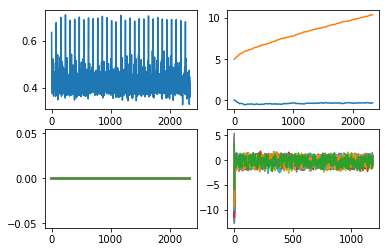

0.42914194191837113


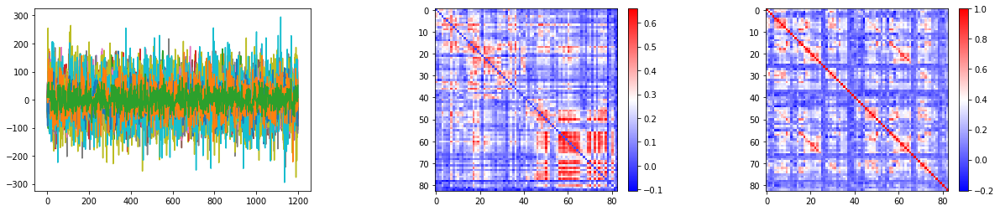

0.4324842696508342


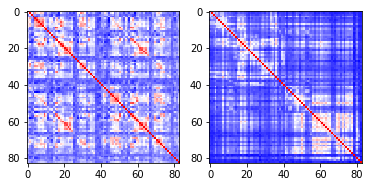

3 172332


<Figure size 432x288 with 0 Axes>

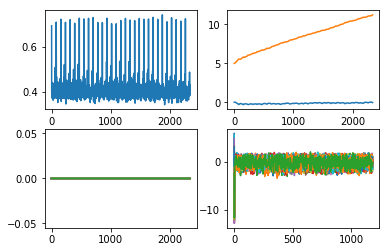

0.285505654287898


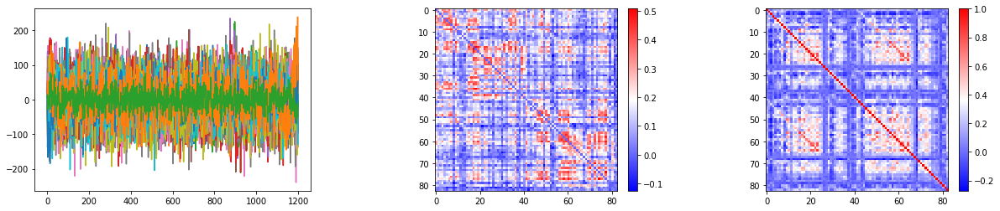

0.30831125187941716


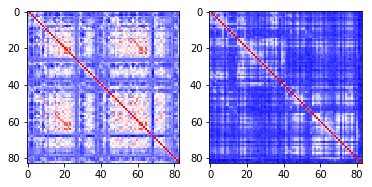

4 181131


<Figure size 432x288 with 0 Axes>

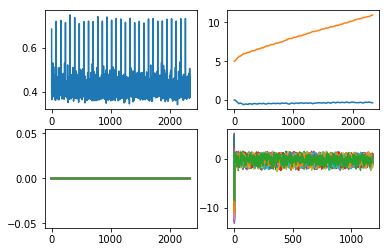

0.4054339416090319


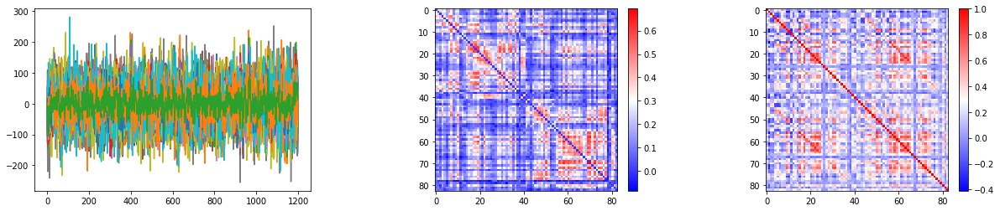

0.4083314921138414


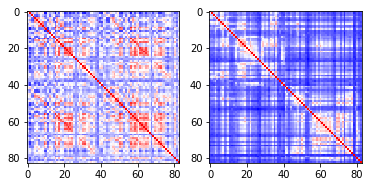

5 317332


<Figure size 432x288 with 0 Axes>

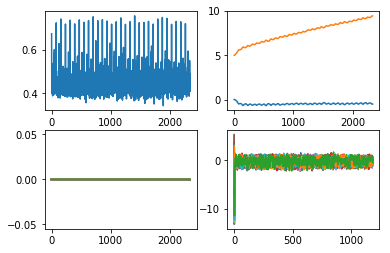

0.34939099454727274


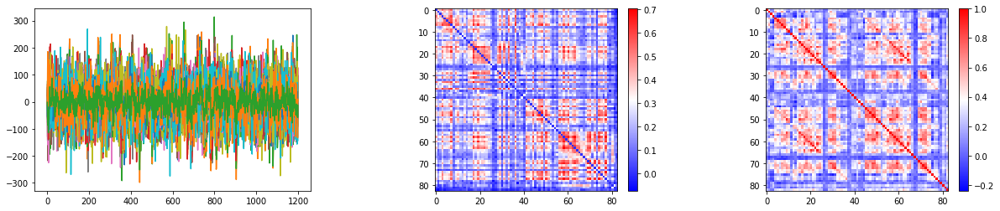

0.3571153869421868


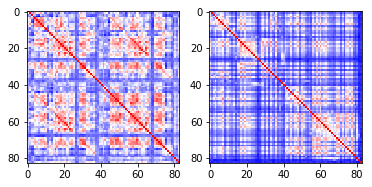

6 196750


<Figure size 432x288 with 0 Axes>

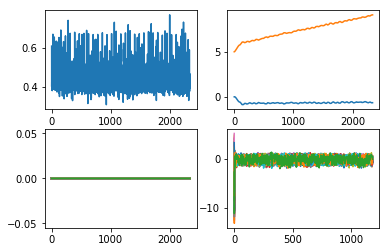

0.4864476879320632


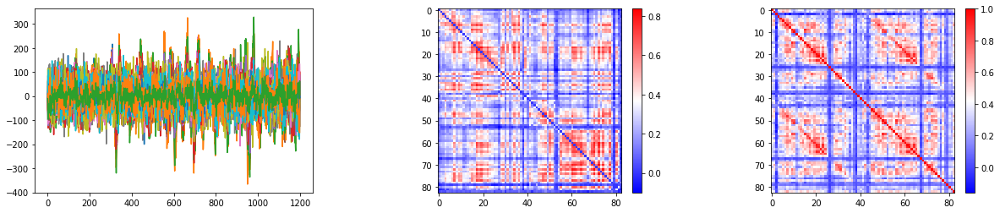

0.46285015379372924


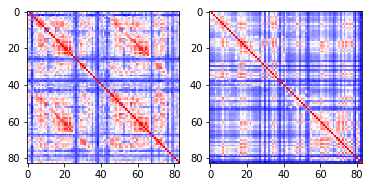

7 196144


<Figure size 432x288 with 0 Axes>

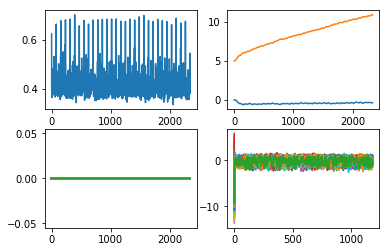

0.3108431949535628


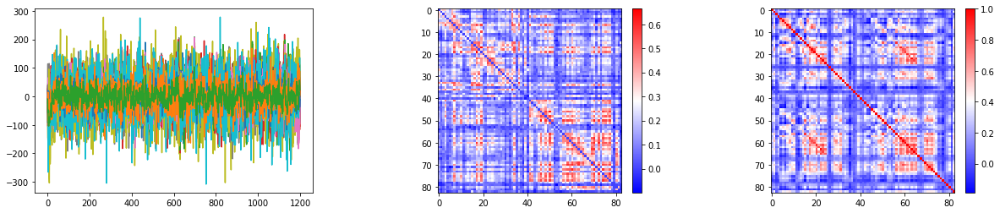

0.33972220113976503


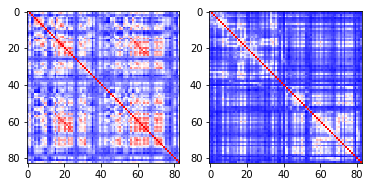

8 231928


<Figure size 432x288 with 0 Axes>

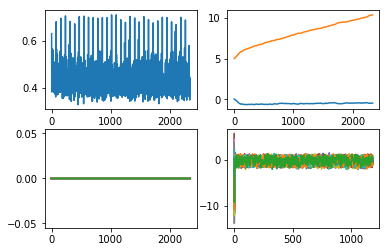

0.44983351881175904


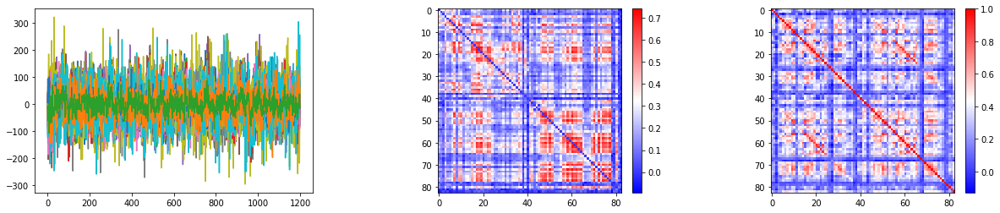

0.446357733148507


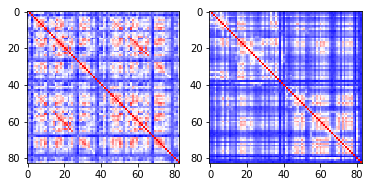

9 579867


<Figure size 432x288 with 0 Axes>

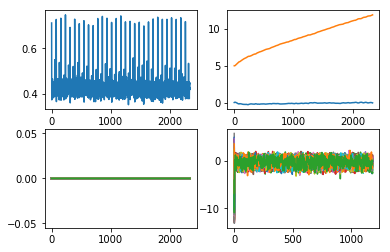

0.29611524787378285


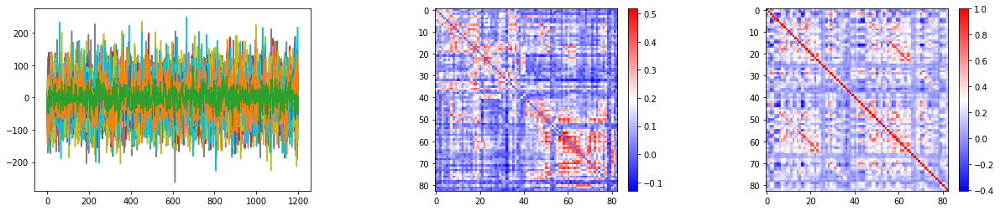

0.2951152497555386


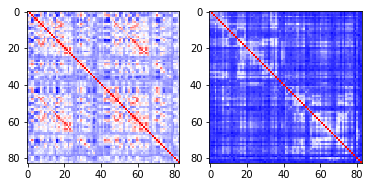

10 146432
11 148941


<Figure size 432x288 with 0 Axes>

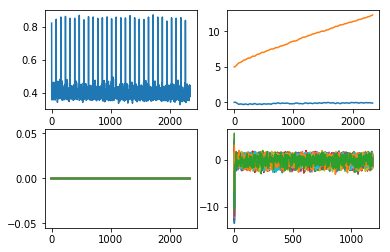

0.2970497773214971


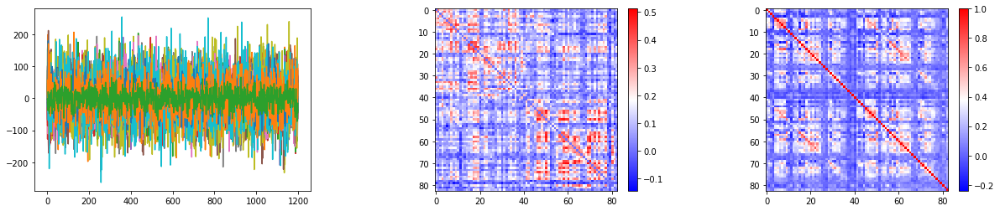

0.3137253863328194


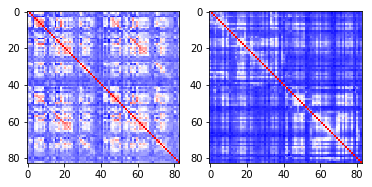

12 100307


<Figure size 432x288 with 0 Axes>

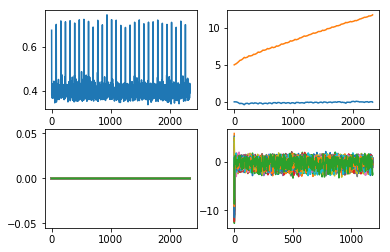

0.3383287885579231


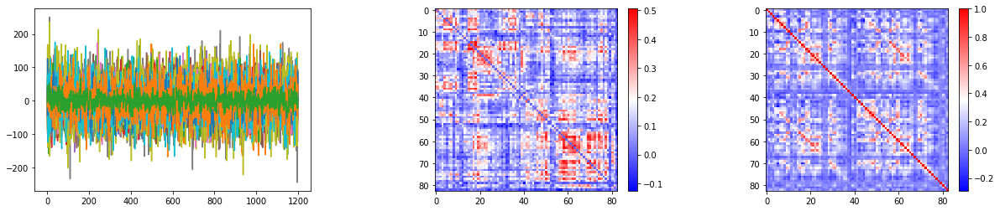

0.35923327139598327


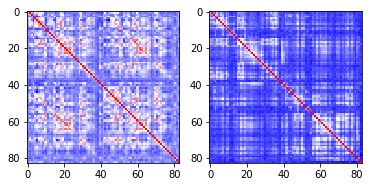

13 709551
14 155938
15 198451


<Figure size 432x288 with 0 Axes>

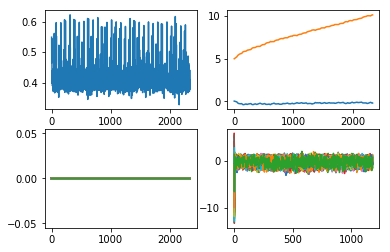

0.34922667152246833


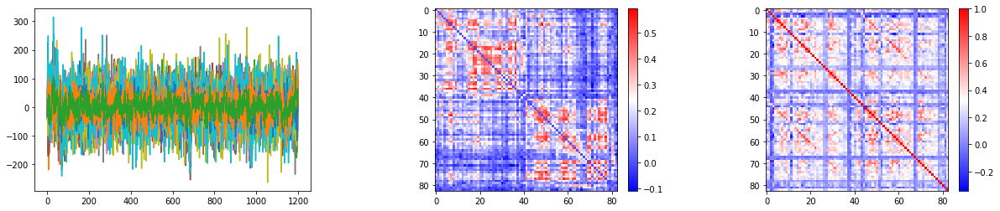

0.3940625262730008


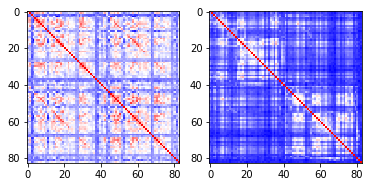

16 311320


<Figure size 432x288 with 0 Axes>

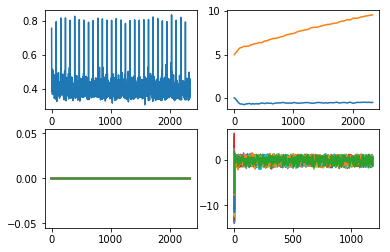

0.4914408181391182


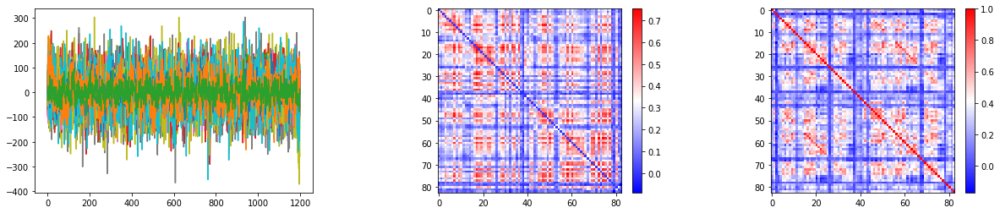

0.5161110140885662


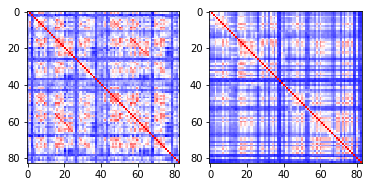

17 385450
18 173637


<Figure size 432x288 with 0 Axes>

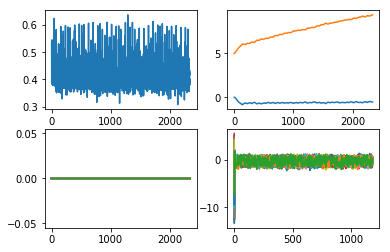

0.52940799174294


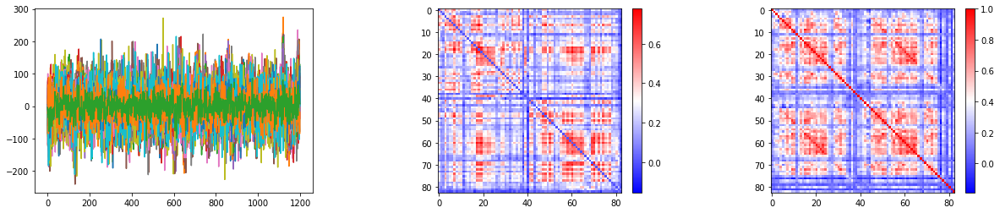

0.537665033870916


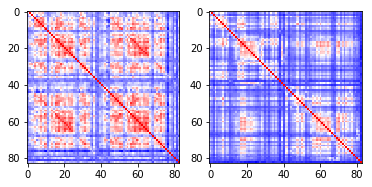

19 181636


<Figure size 432x288 with 0 Axes>

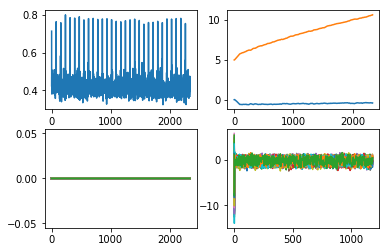

0.3805744002301718


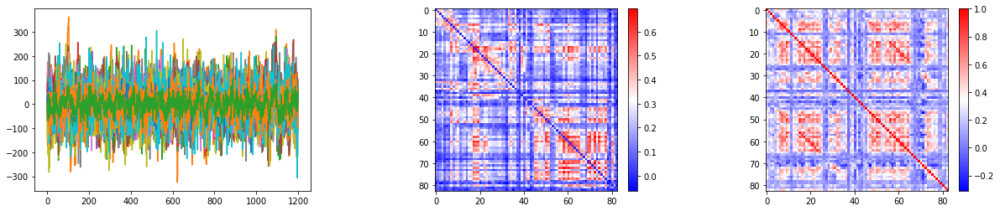

0.3786577712632631


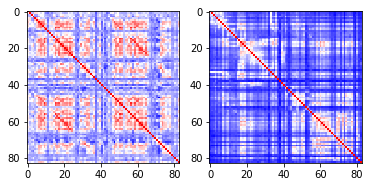

20 290136


<Figure size 432x288 with 0 Axes>

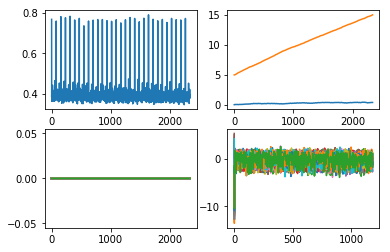

0.25912198633977906


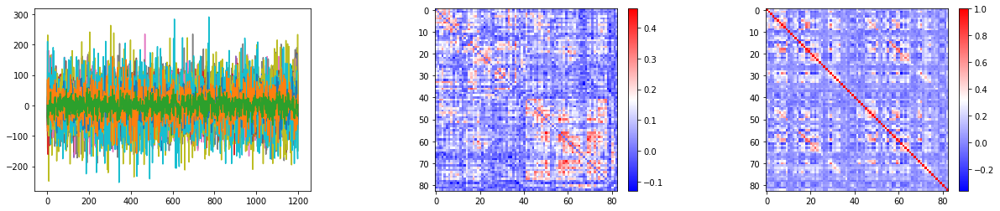

0.27130815750416365


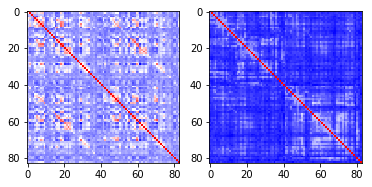

21 198653


<Figure size 432x288 with 0 Axes>

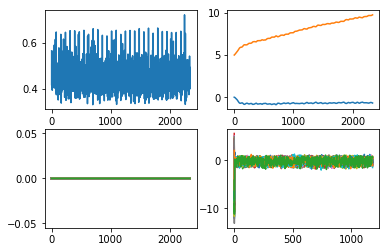

0.3601694439680497


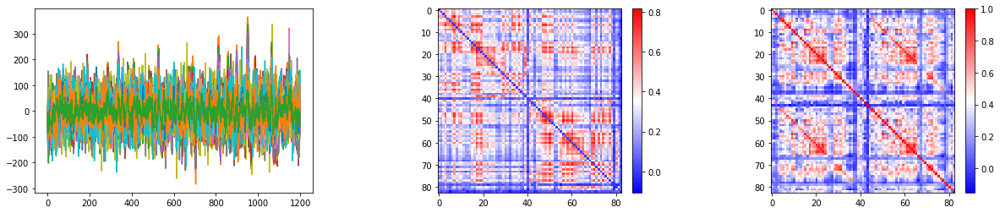

0.3574298939182701


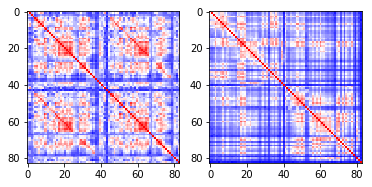

22 157336


<Figure size 432x288 with 0 Axes>

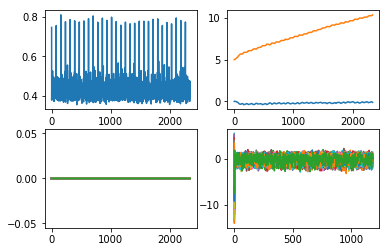

0.389301799848382


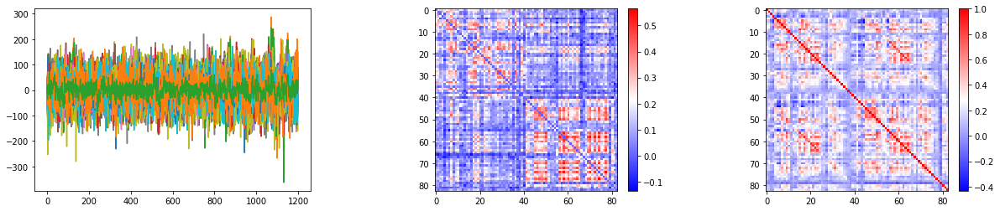

0.3910071157851134


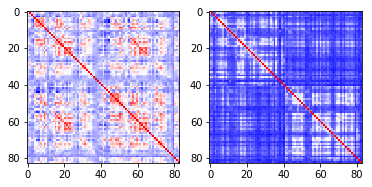

23 121921
24 145127
25 567961


<Figure size 432x288 with 0 Axes>

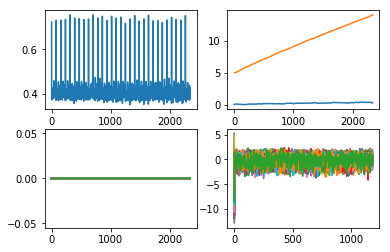

0.3030978751214902


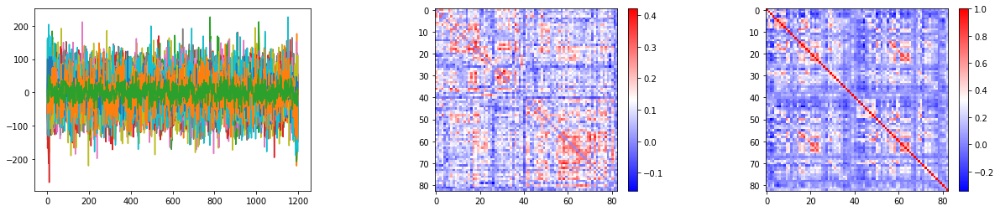

0.34859096852389176


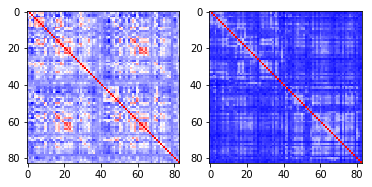

26 492754


<Figure size 432x288 with 0 Axes>

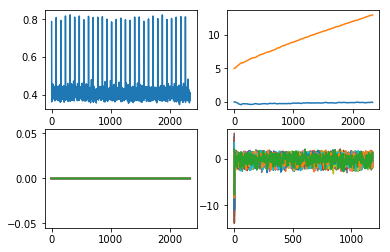

0.27303207274533664


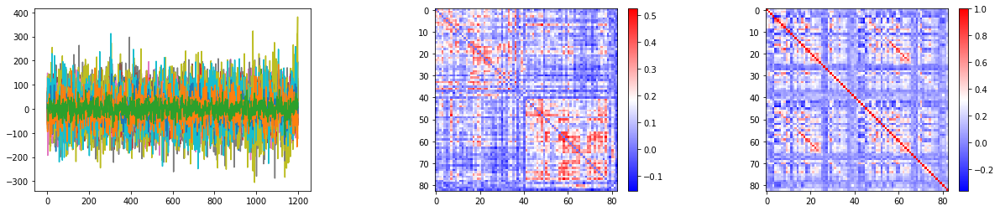

0.3291073701071376


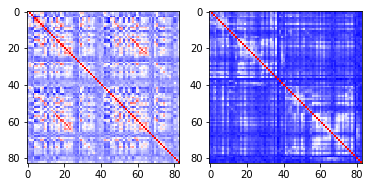

27 562446


<Figure size 432x288 with 0 Axes>

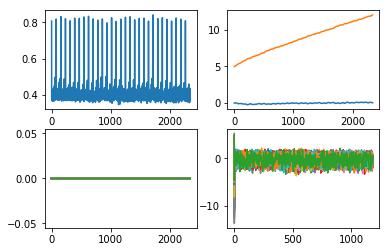

0.3813248768976272


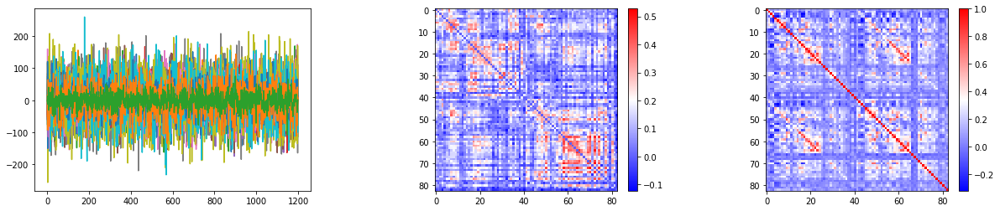

0.40034026873634243


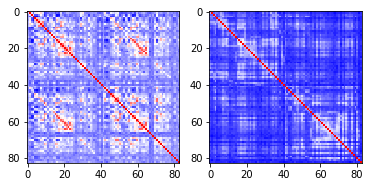

28 200210
29 151223
30 872158
31 579665


<Figure size 432x288 with 0 Axes>

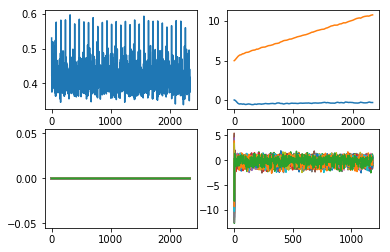

0.3100087504872133


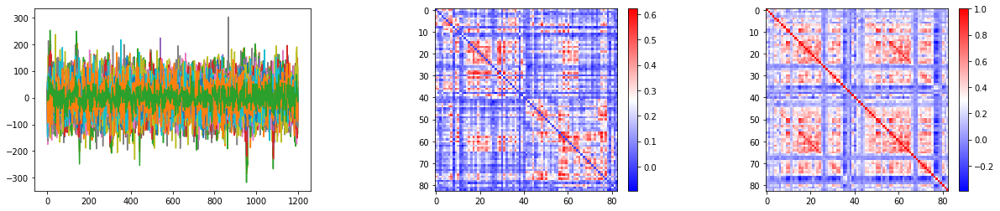

0.31639811637945375


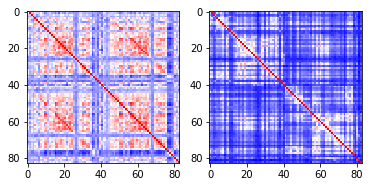

32 548250


<Figure size 432x288 with 0 Axes>

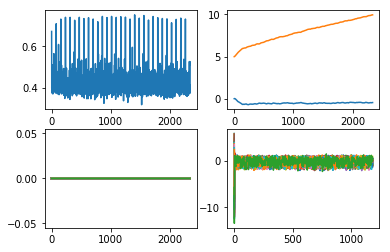

0.350190141605245


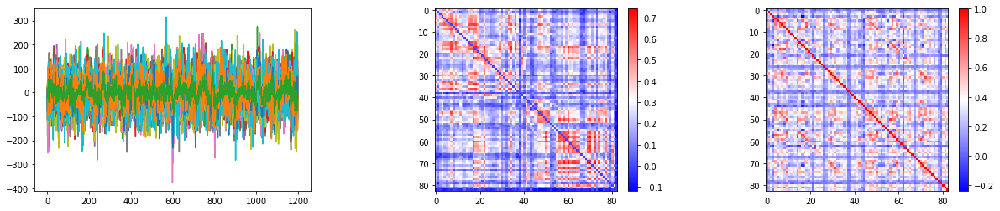

0.367741410078547


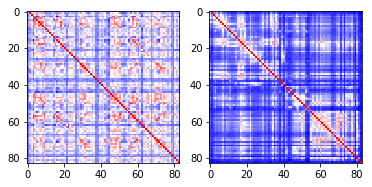

33 198350


<Figure size 432x288 with 0 Axes>

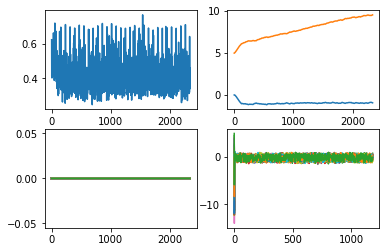

0.46741200610643474


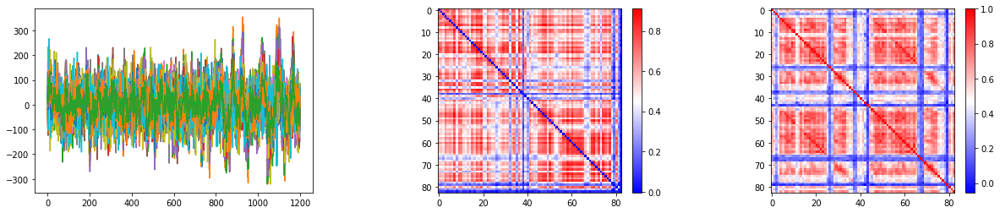

0.45329741798261364


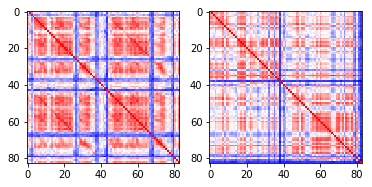

34 297655


<Figure size 432x288 with 0 Axes>

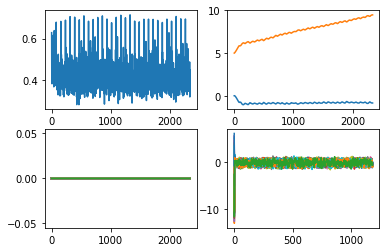

0.5083217937911566


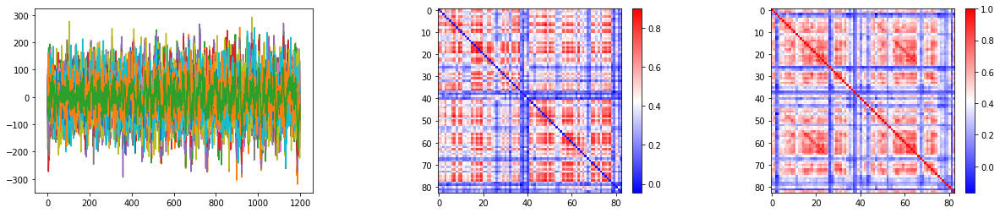

0.5150511555971647


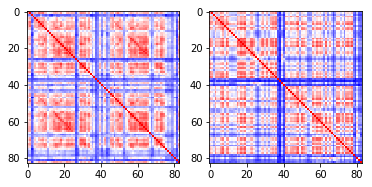

35 295146


<Figure size 432x288 with 0 Axes>

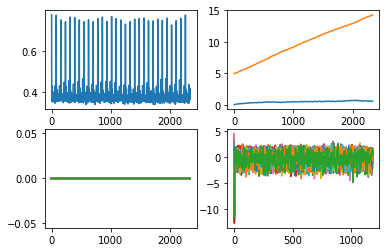

0.30381831839480744


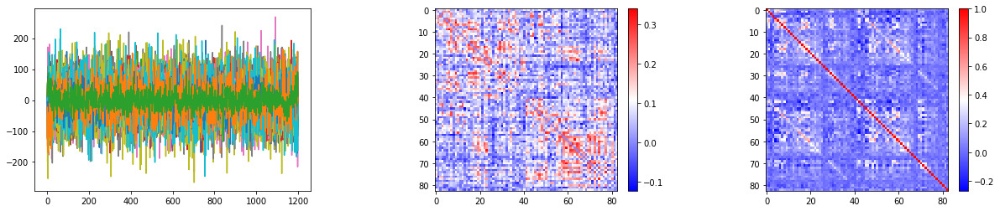

0.3603917267272034


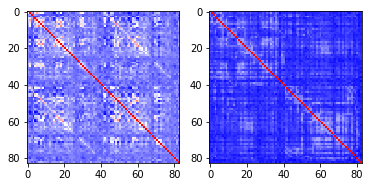

36 561444
37 183337


<Figure size 432x288 with 0 Axes>

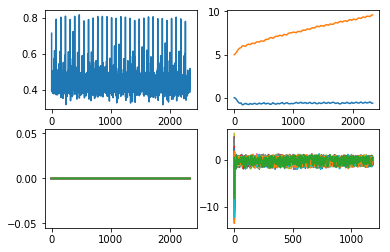

0.4632330527023441


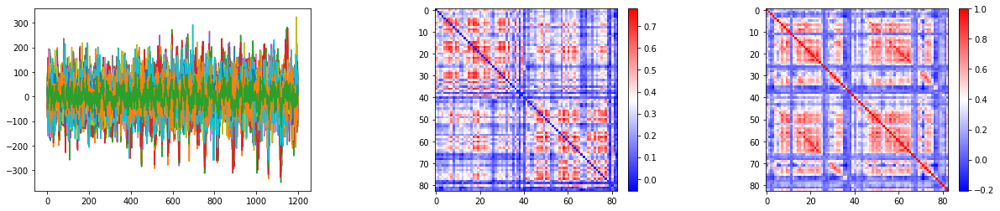

0.43878223895136614


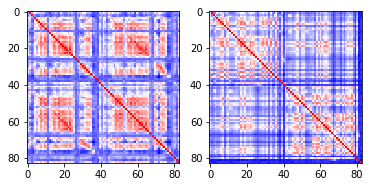

38 559053


<Figure size 432x288 with 0 Axes>

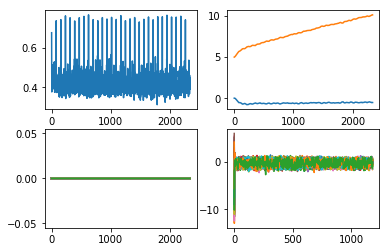

0.43330102077444616


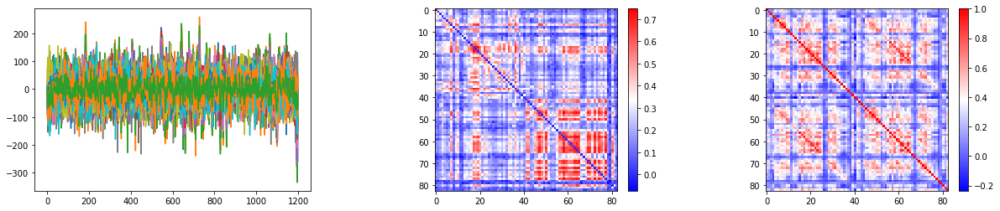

0.4300225303909336


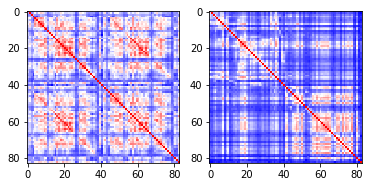

39 519950


<Figure size 432x288 with 0 Axes>

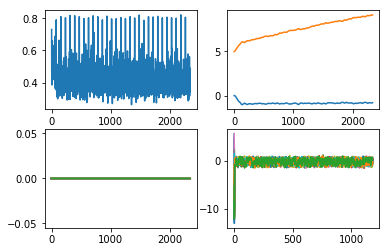

0.4705027010646833


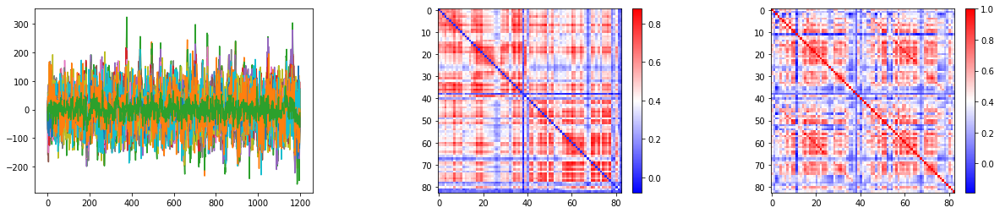

0.4865212392716894


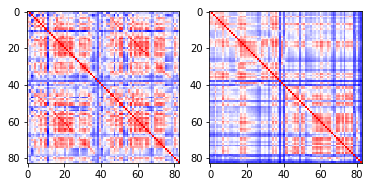

40 220721
41 197550


<Figure size 432x288 with 0 Axes>

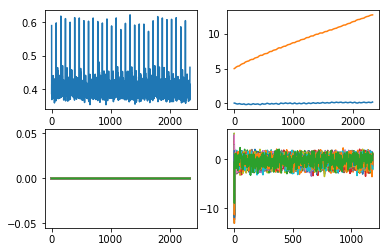

0.33844768654889307


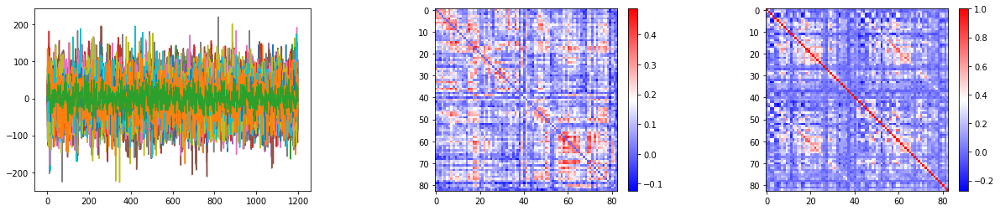

0.34143358153095477


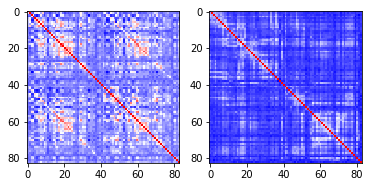

42 179952


<Figure size 432x288 with 0 Axes>

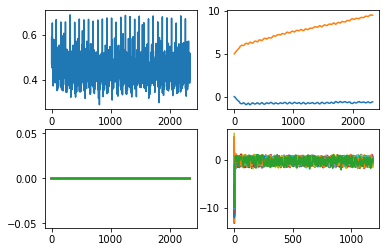

0.5022761475735871


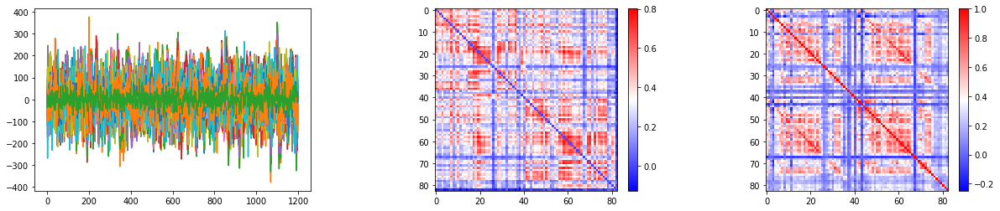

0.48625554618110733


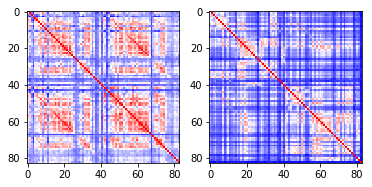

43 151526


<Figure size 432x288 with 0 Axes>

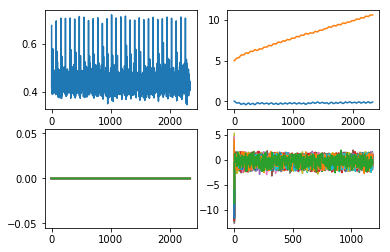

0.3890126125240036


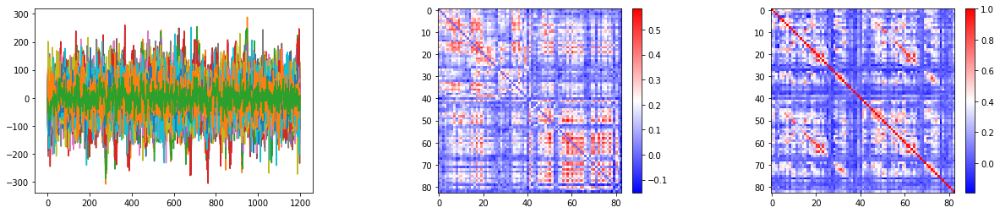

0.38315399769000663


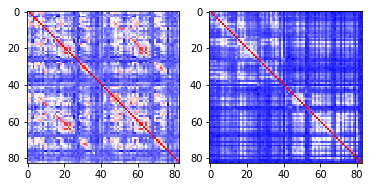

44 191033
45 177342


<Figure size 432x288 with 0 Axes>

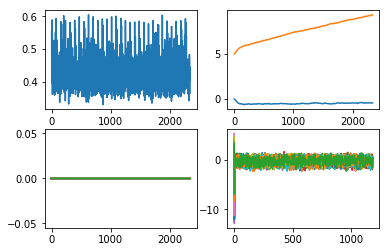

0.5454959843516849


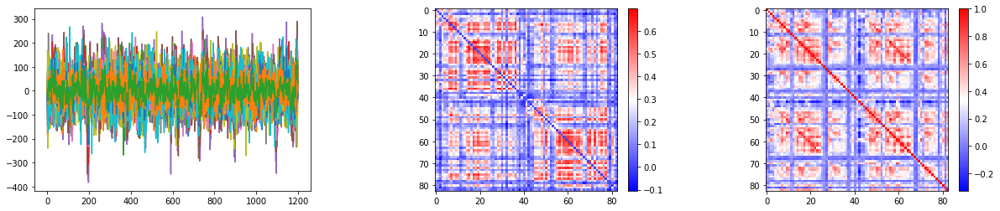

0.5538758569400811


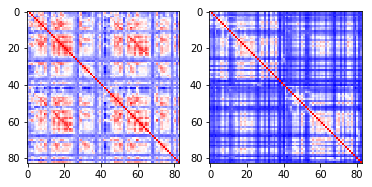

46 156536
47 298051


<Figure size 432x288 with 0 Axes>

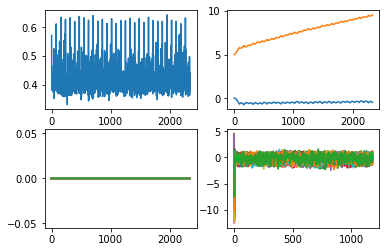

0.4347128688116502


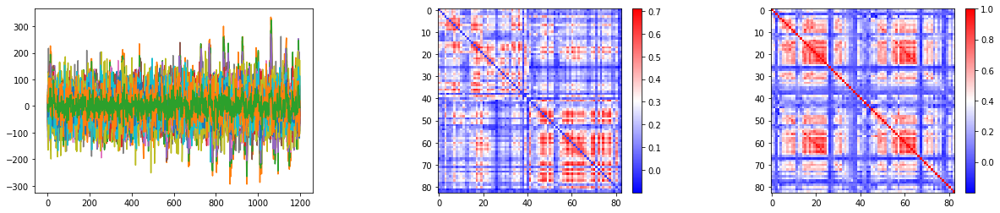

0.4469203285201818


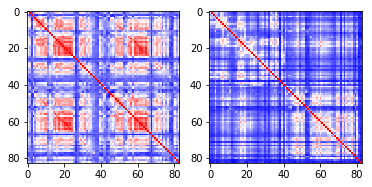

48 570243
49 154229


<Figure size 432x288 with 0 Axes>

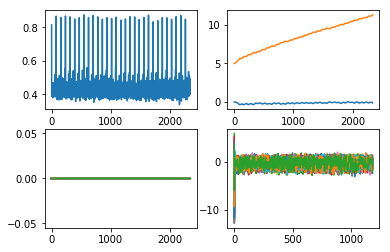

0.3293312313521983


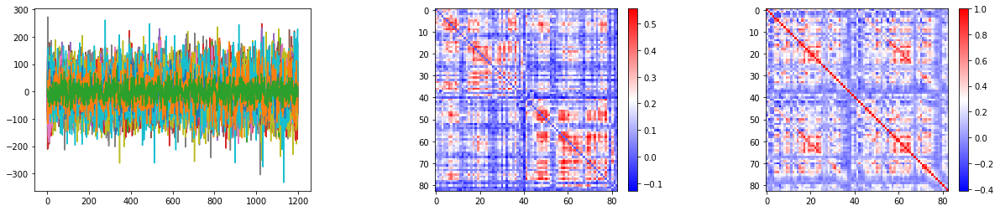

0.35309963862640076


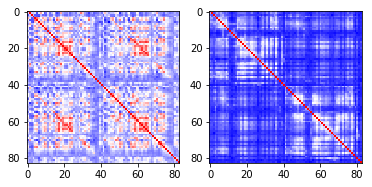

50 512835


<Figure size 432x288 with 0 Axes>

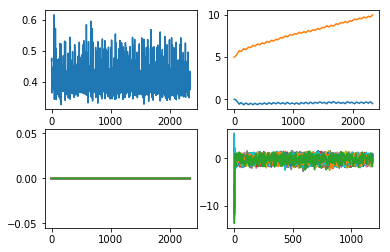

0.5160329396301155


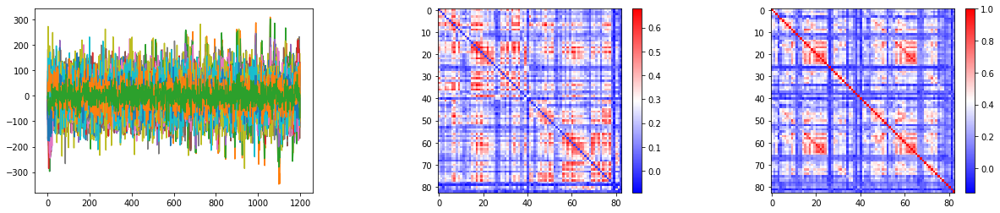

0.5330153214512965


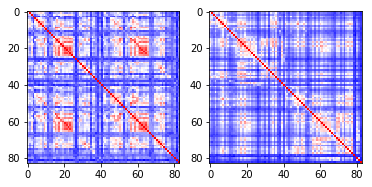

51 257542


<Figure size 432x288 with 0 Axes>

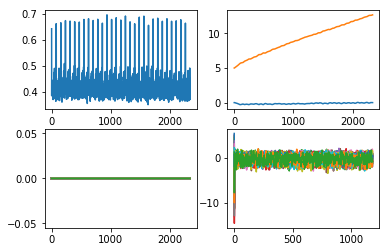

0.33403948441436393


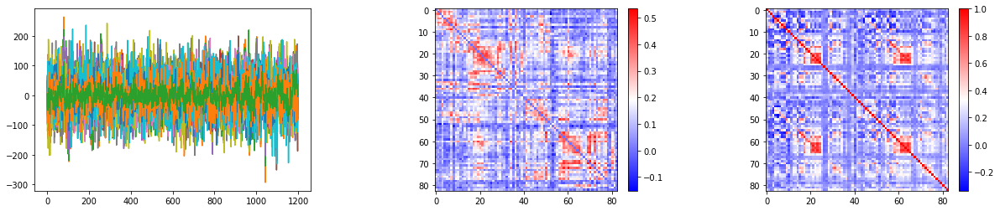

0.35054627856725074


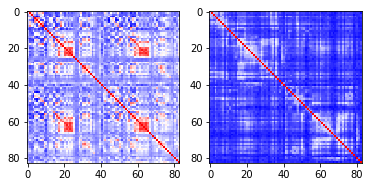

52 529549


<Figure size 432x288 with 0 Axes>

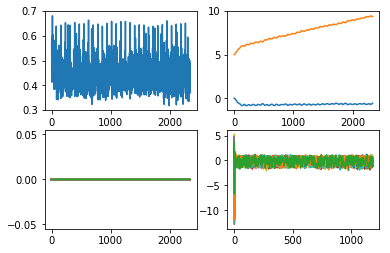

0.45035370130287167


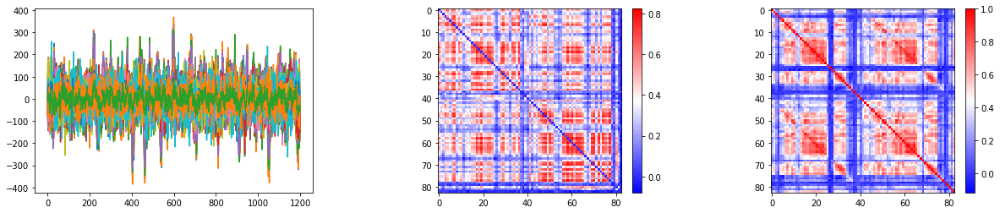

0.44853566062354244


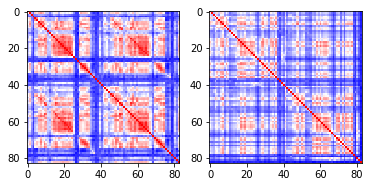

53 173738


<Figure size 432x288 with 0 Axes>

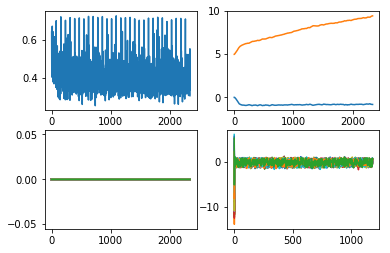

0.5145234614717682


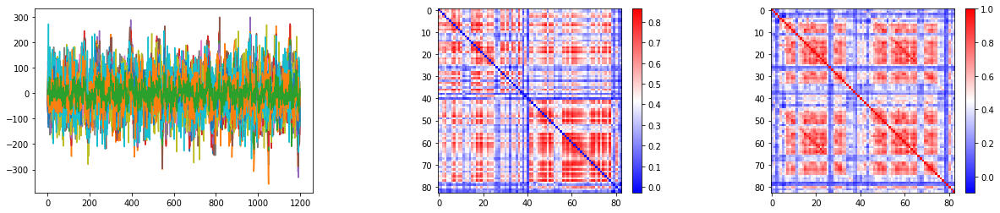

0.5079099794781774


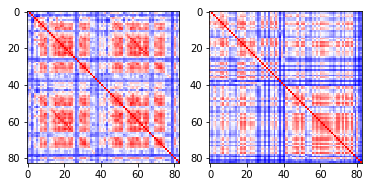

54 214423
55 177746


<Figure size 432x288 with 0 Axes>

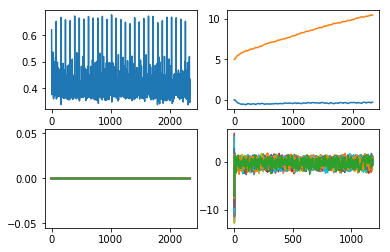

0.39951478613210123


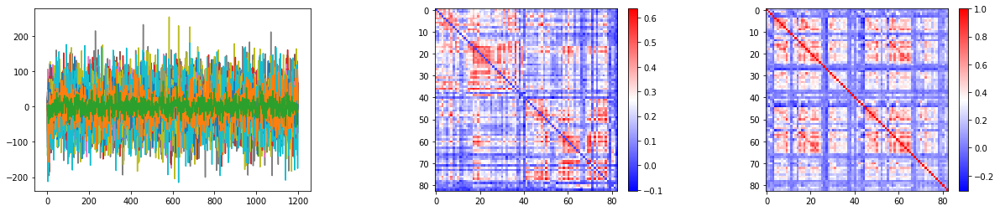

0.4403572328378645


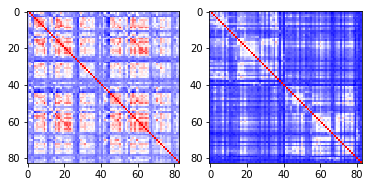

56 171532


<Figure size 432x288 with 0 Axes>

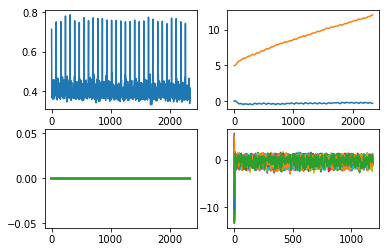

0.42996248069250187


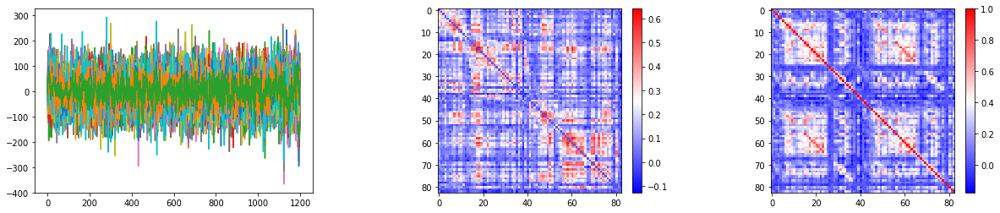

0.44109553813123975


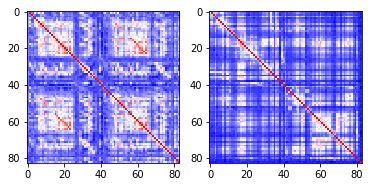

57 480141


<Figure size 432x288 with 0 Axes>

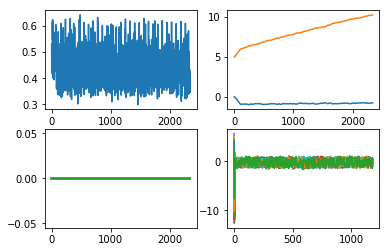

0.41011257499339354


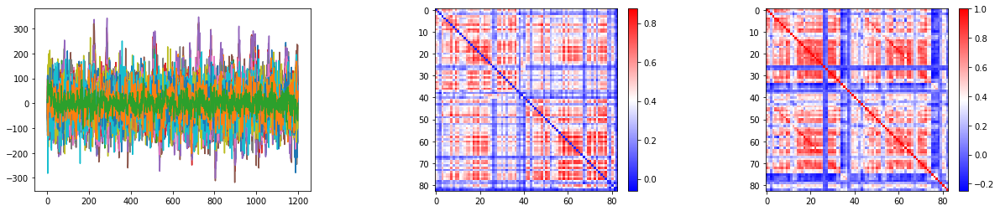

0.39054215652921664


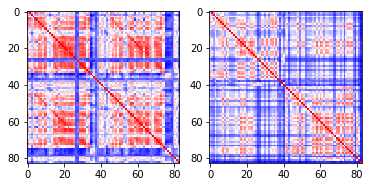

58 285446


<Figure size 432x288 with 0 Axes>

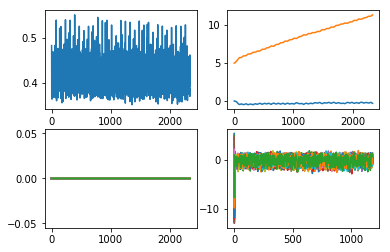

0.30550896092917207


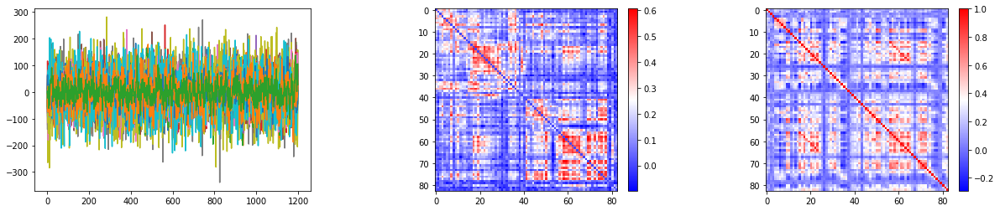

0.340169350402379


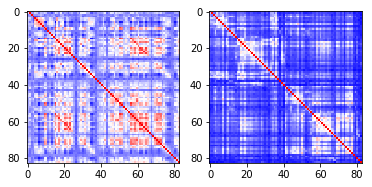

59 176441


<Figure size 432x288 with 0 Axes>

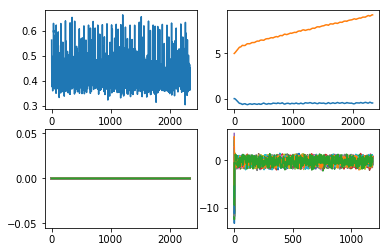

0.4250170776517919


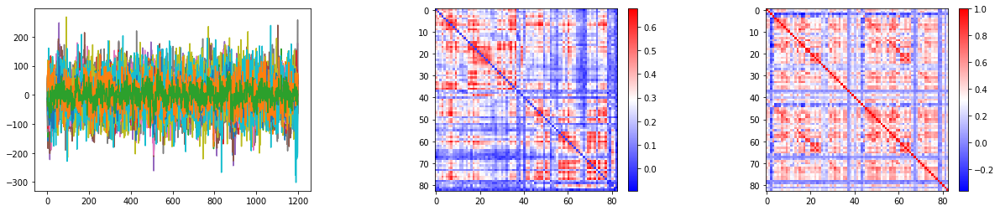

0.44634797771481116


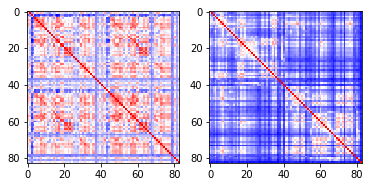

60 280941


<Figure size 432x288 with 0 Axes>

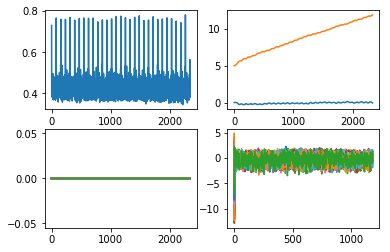

0.27666921843124764


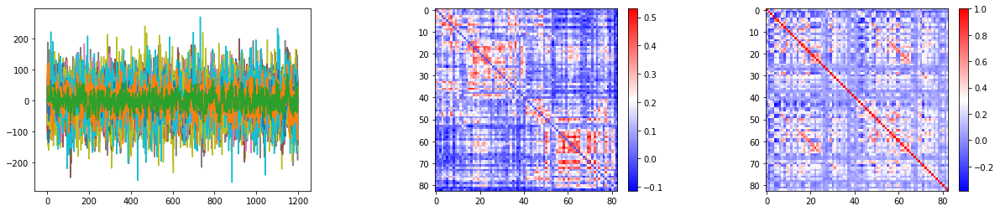

0.3322659540451374


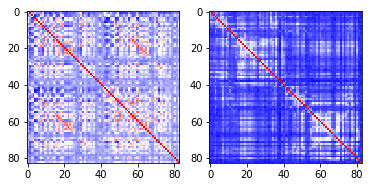

61 115017
62 156435


<Figure size 432x288 with 0 Axes>

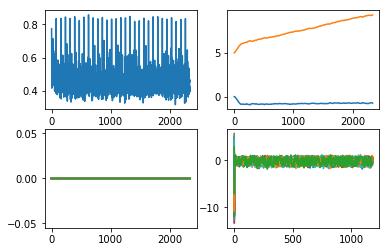

0.3627375731230477


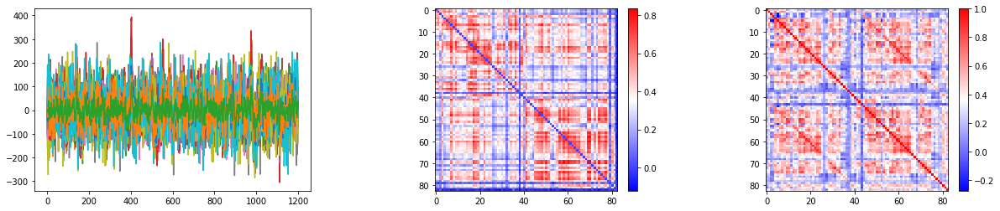

0.3560822355007163


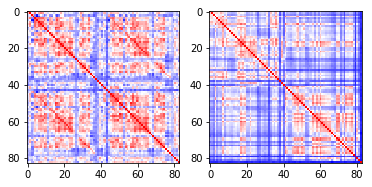

63 965771
64 448347


<Figure size 432x288 with 0 Axes>

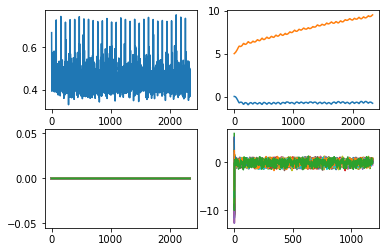

0.318930120330024


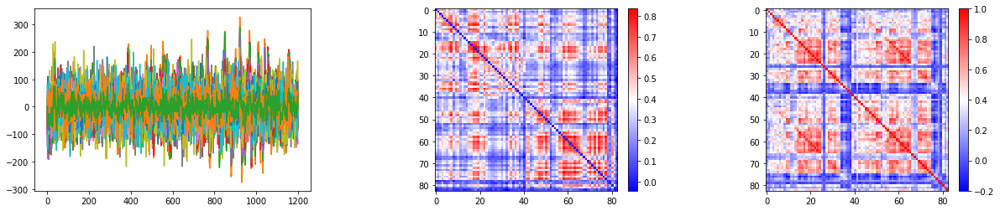

0.3324691736542906


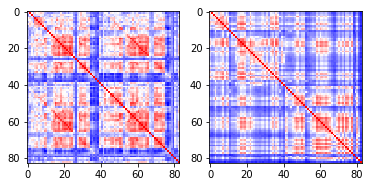

65 173233
66 173536


<Figure size 432x288 with 0 Axes>

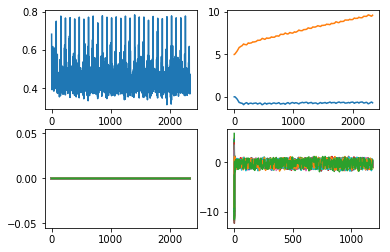

0.40922915500693363


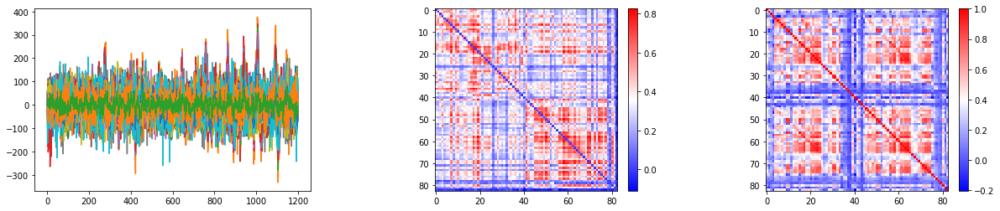

0.37683743046496965


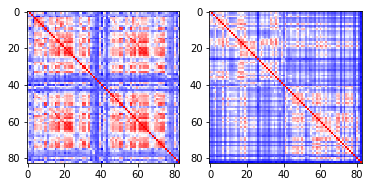

67 904044
68 175035


<Figure size 432x288 with 0 Axes>

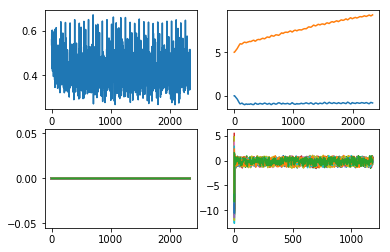

0.48409360175787


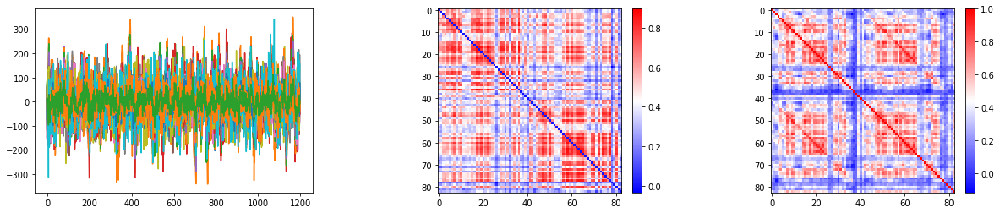

0.49908059283118555


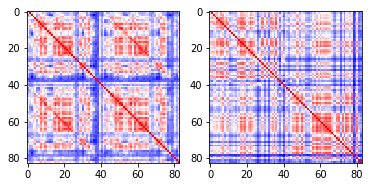

69 150928


<Figure size 432x288 with 0 Axes>

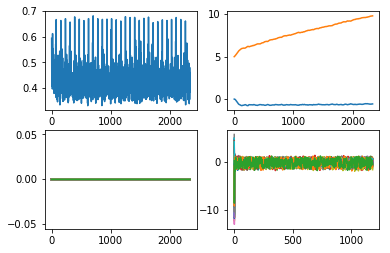

0.3623433165381348


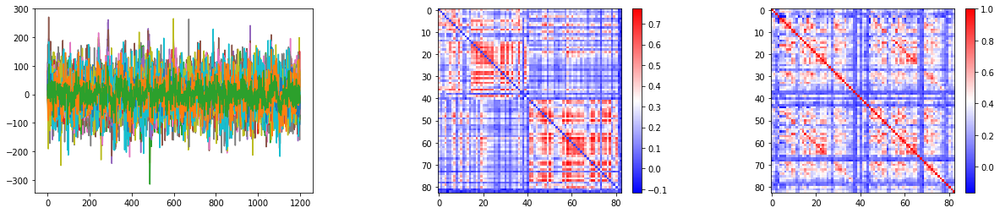

0.3912913556253877


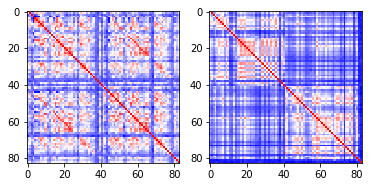

70 316835


<Figure size 432x288 with 0 Axes>

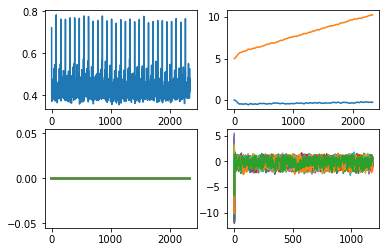

0.2902586818680474


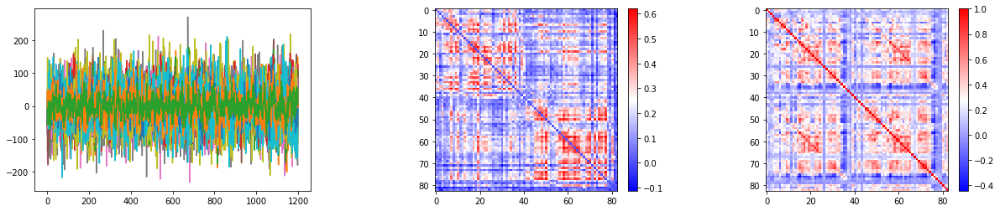

0.27604801664557094


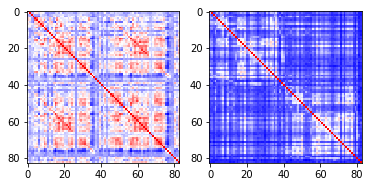

71 211215
72 171633


<Figure size 432x288 with 0 Axes>

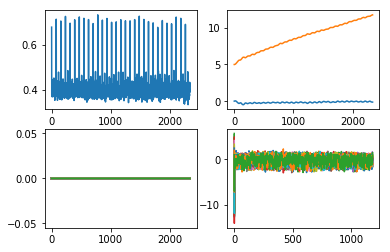

0.3786165949305931


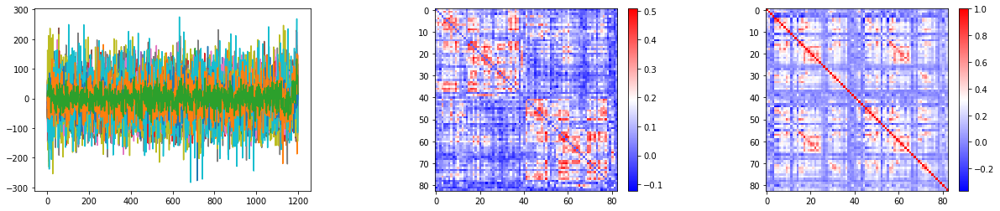

0.399621674143479


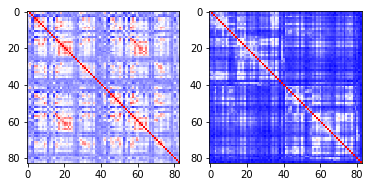

73 305830


<Figure size 432x288 with 0 Axes>

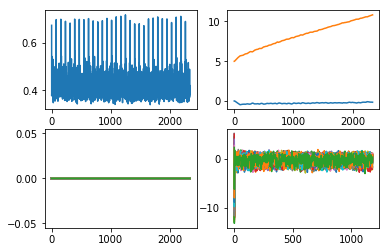

0.3328000774433485


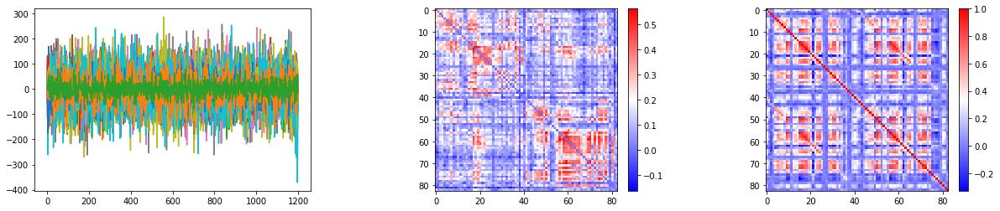

0.3462009150717335


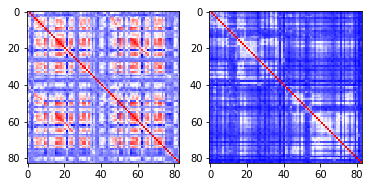

74 926862
75 547046


<Figure size 432x288 with 0 Axes>

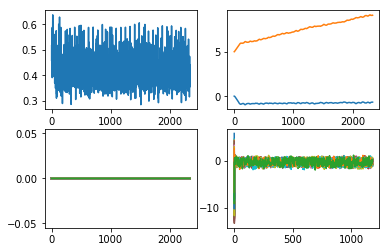

0.5328267450306238


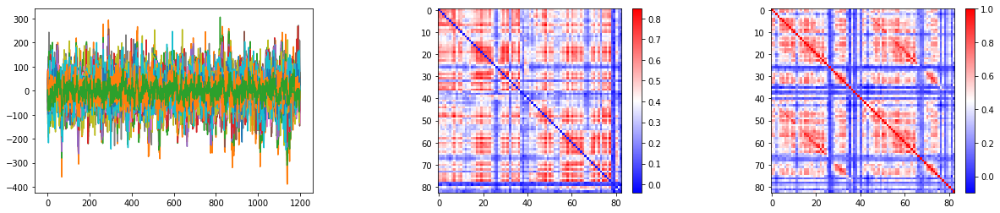

0.5475103397141803


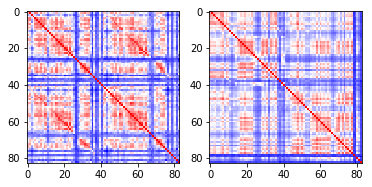

76 154936


<Figure size 432x288 with 0 Axes>

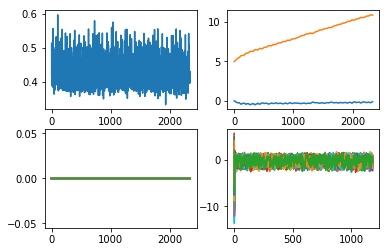

0.3594018884545109


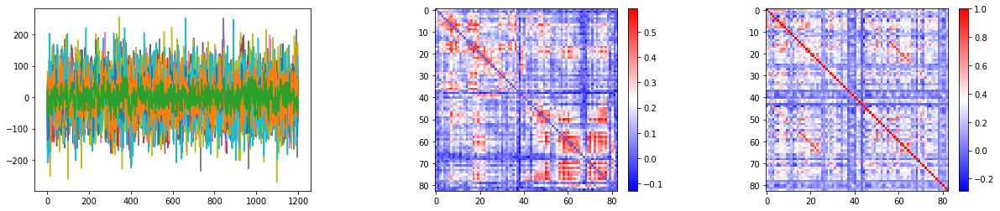

0.37109114559902345


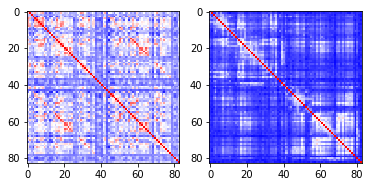

77 127327
78 318637
79 158338
80 910241
81 191336
82 286650


<Figure size 432x288 with 0 Axes>

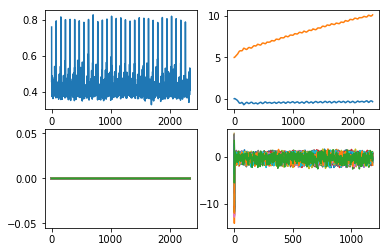

0.47732209713422574


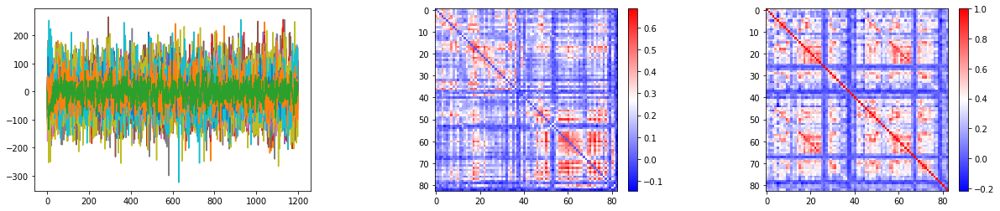

0.5140317234211749


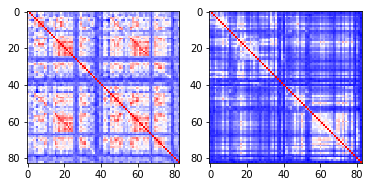

83 753251
84 486759


<Figure size 432x288 with 0 Axes>

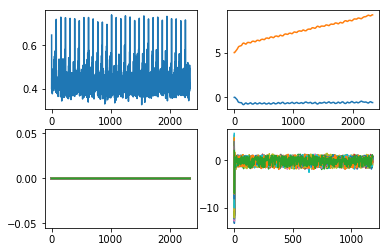

0.4183275055457508


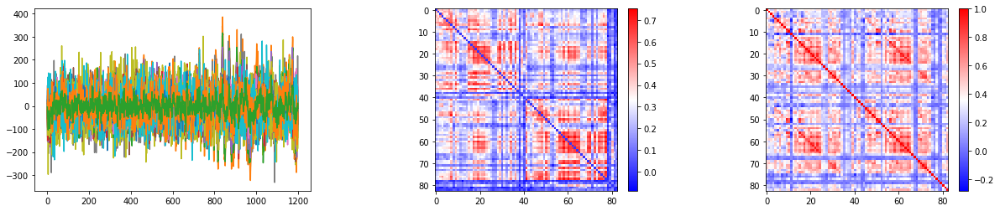

0.4050059853055793


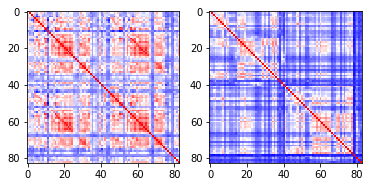

85 153025


<Figure size 432x288 with 0 Axes>

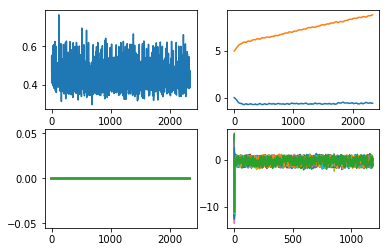

0.5341349291705163


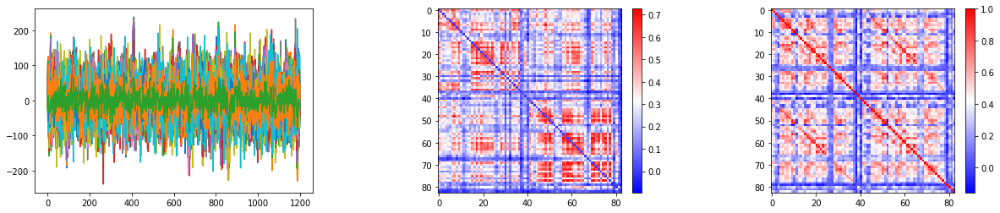

0.6022550292667169


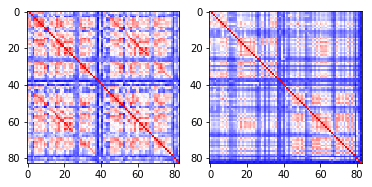

86 200008
87 803240
88 156637


<Figure size 432x288 with 0 Axes>

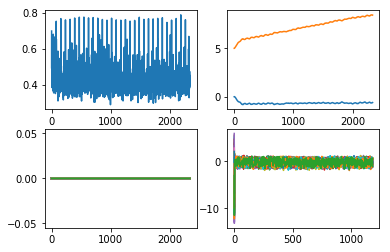

0.5488221871650538


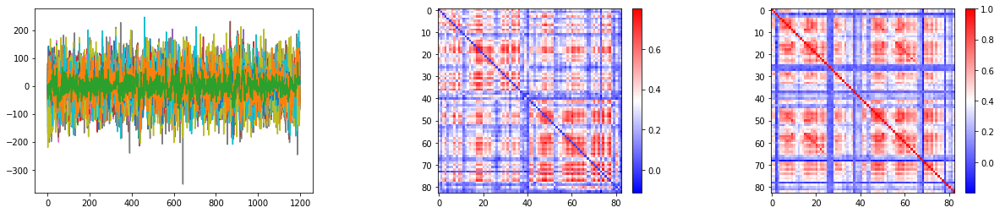

0.5640730636429084


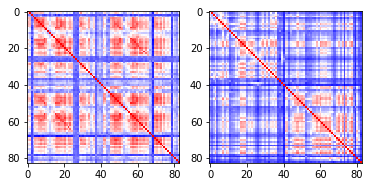

89 149842


<Figure size 432x288 with 0 Axes>

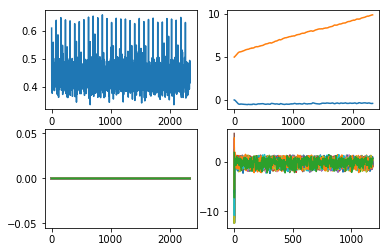

0.31324528361536974


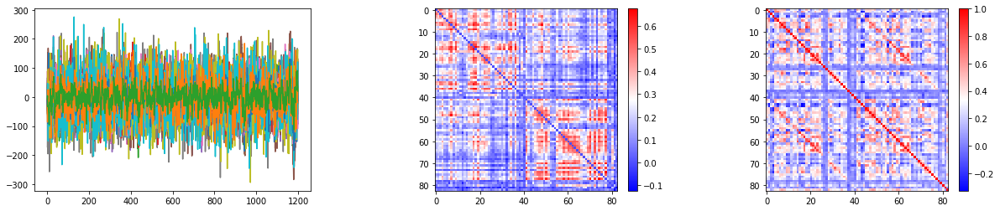

0.34450904003190913


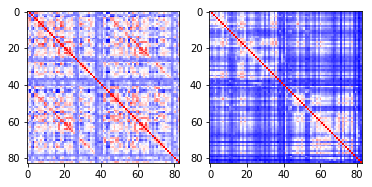

90 159744
91 299154


<Figure size 432x288 with 0 Axes>

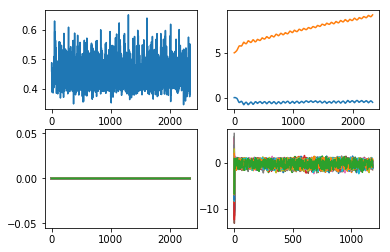

0.40251314724592807


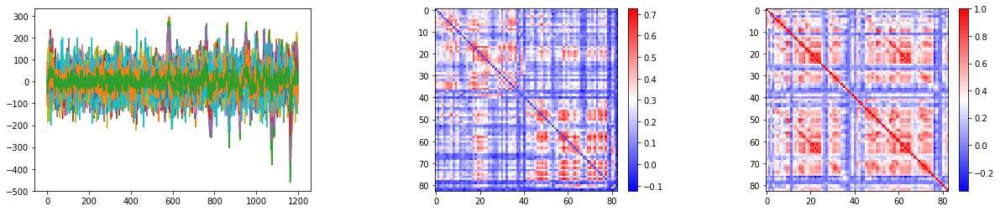

0.4043063396279176


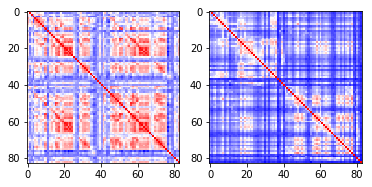

92 957974
93 671855
94 173940


<Figure size 432x288 with 0 Axes>

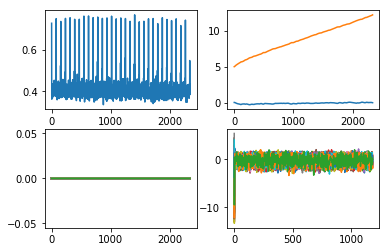

0.34922450338737127


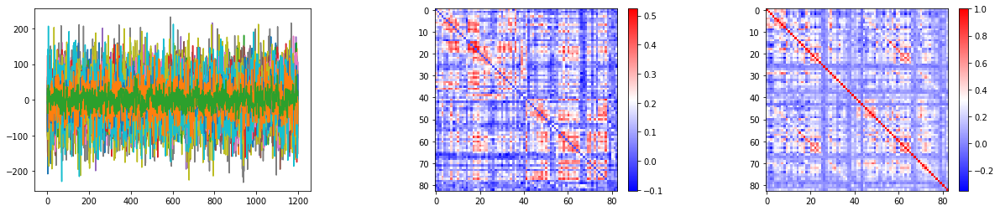

0.36703298199970963


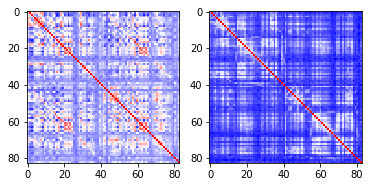

95 465852


<Figure size 432x288 with 0 Axes>

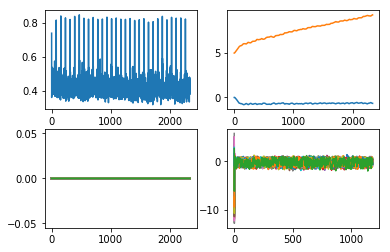

0.3834307431246216


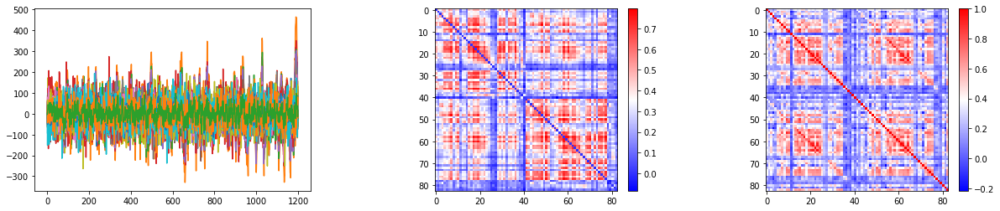

0.3368582101394289


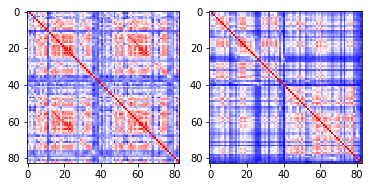

96 150423


<Figure size 432x288 with 0 Axes>

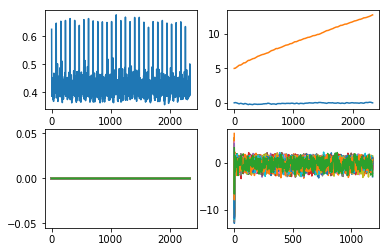

0.2595271475486051


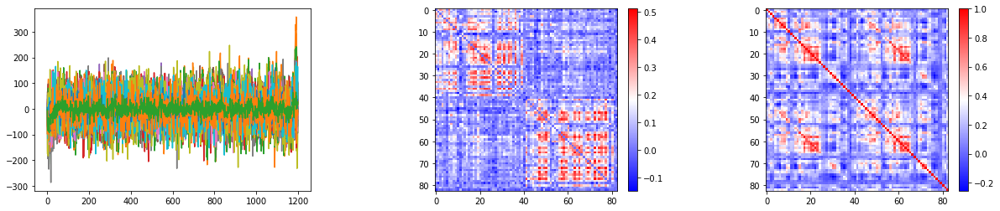

0.2814056226966136


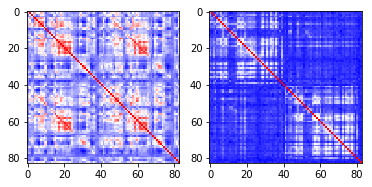

97 599469
98 199251


<Figure size 432x288 with 0 Axes>

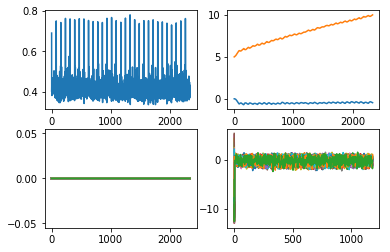

0.4621162270209182


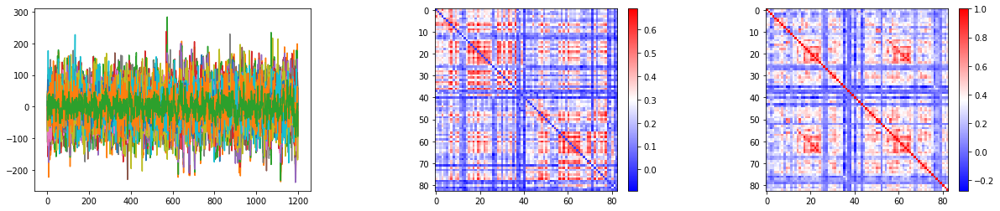

0.4713155646795329


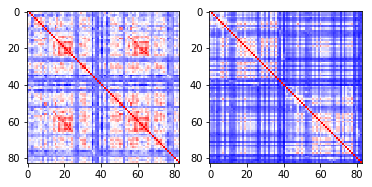

99 816653
100 158843


<Figure size 432x288 with 0 Axes>

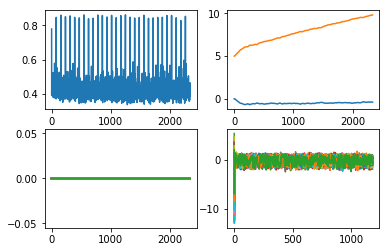

0.4246229090576872


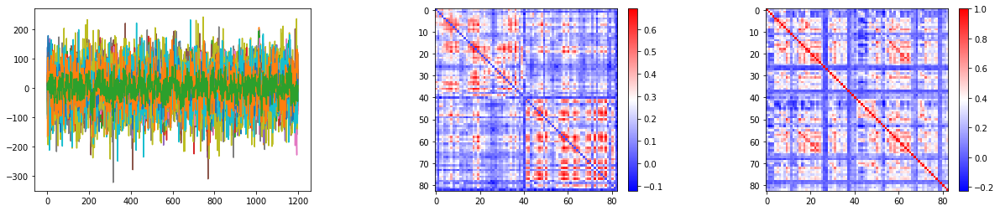

0.4298269128701484


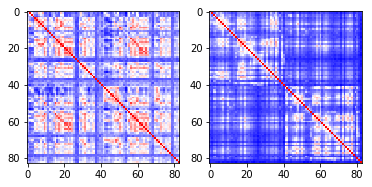

101 151627


<Figure size 432x288 with 0 Axes>

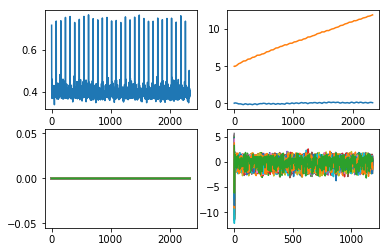

0.2965582529799546


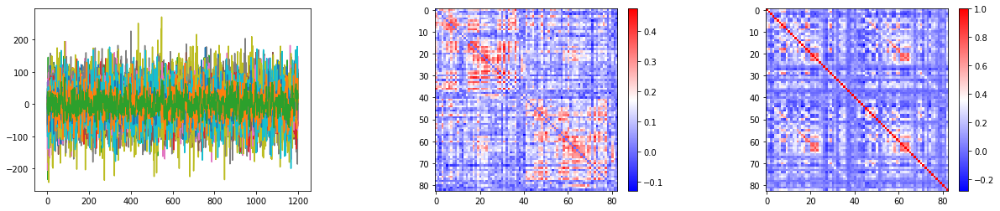

0.314519628896607


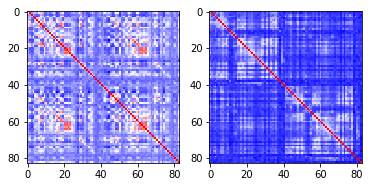

102 197651


<Figure size 432x288 with 0 Axes>

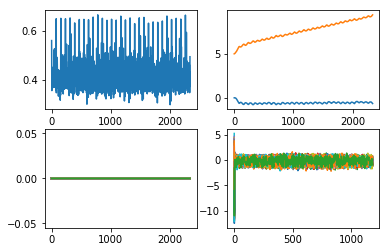

0.5606147850400611


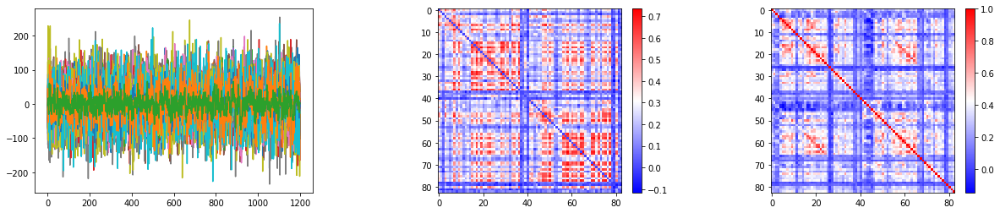

0.5532126668591372


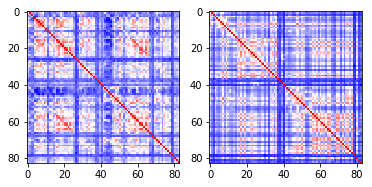

103 175540
104 555651


<Figure size 432x288 with 0 Axes>

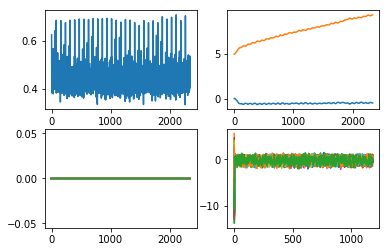

0.31219398151445926


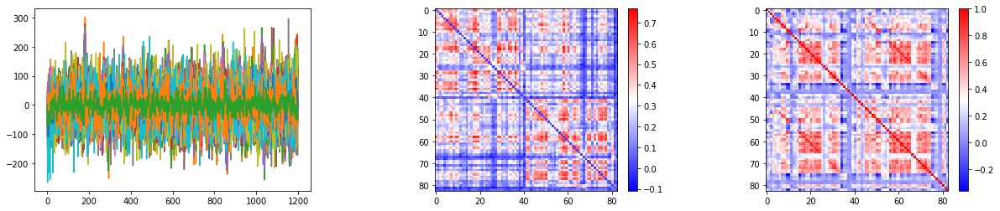

0.3548400466990285


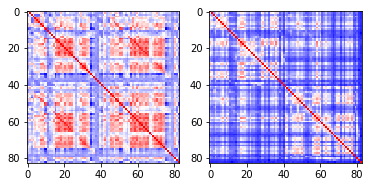

105 896778
106 792867
107 580347
108 153631


<Figure size 432x288 with 0 Axes>

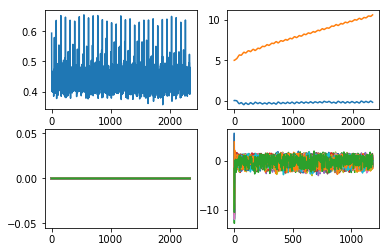

0.33360229296525024


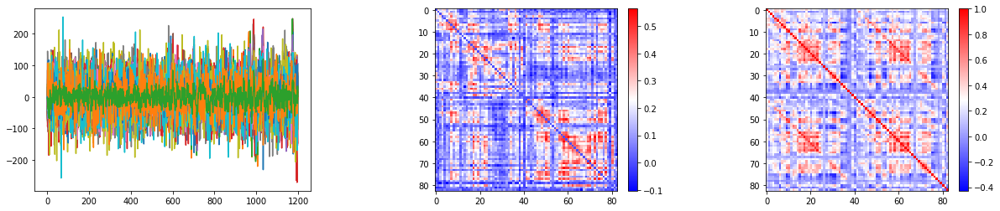

0.3578299632387506


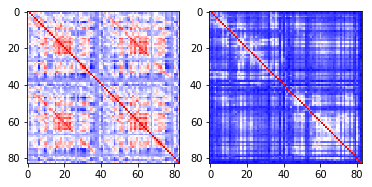

109 304727


<Figure size 432x288 with 0 Axes>

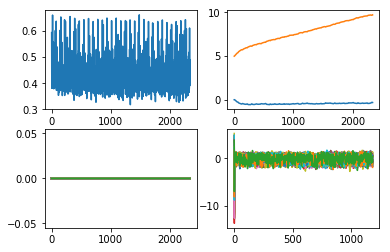

0.4666229276170046


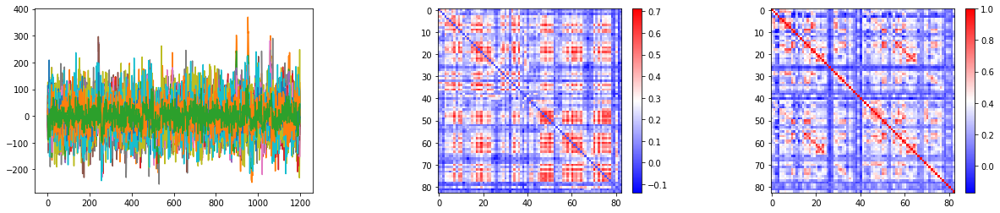

0.46862086063899655


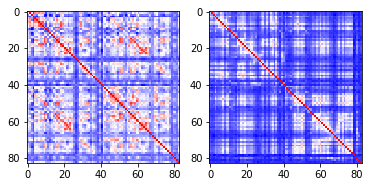

110 207123
111 303624
112 174841


<Figure size 432x288 with 0 Axes>

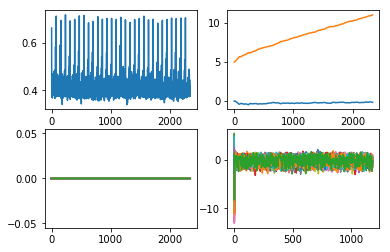

0.3386618332356165


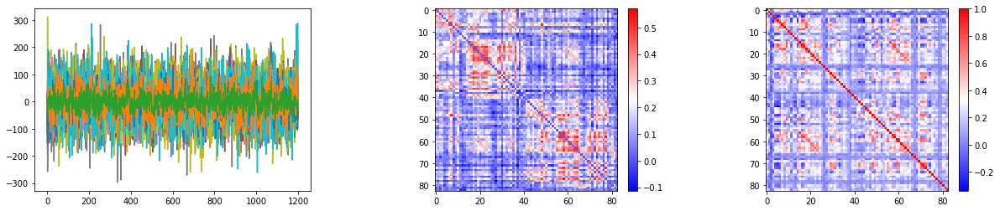

0.3482223560980953


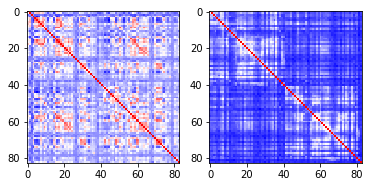

113 573249


<Figure size 432x288 with 0 Axes>

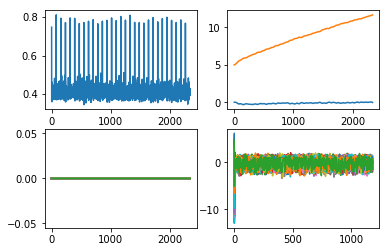

0.33748229809013747


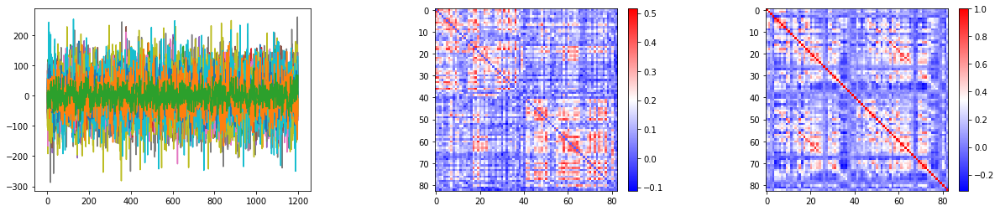

0.35746326646026827


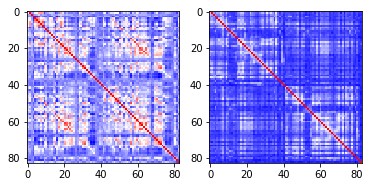

114 872764
115 179548
116 144428
117 529953


<Figure size 432x288 with 0 Axes>

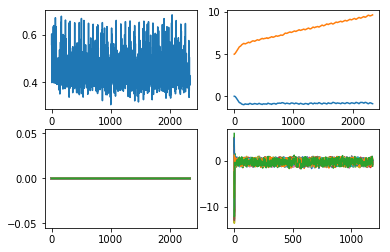

0.3138219829683947


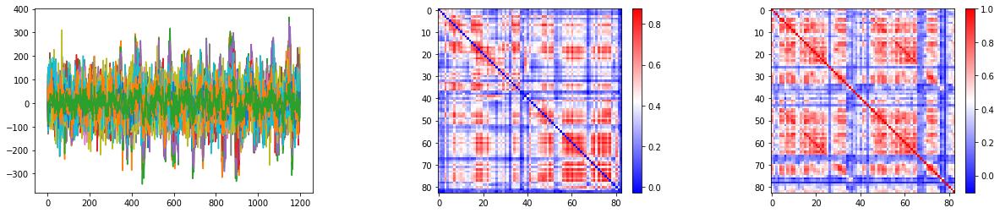

0.3140207787321374


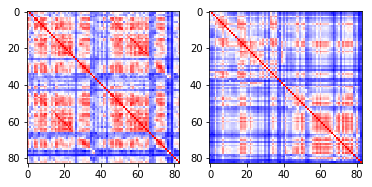

118 199655


<Figure size 432x288 with 0 Axes>

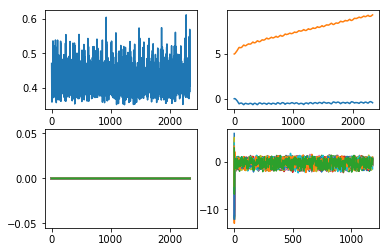

0.28775563589471387


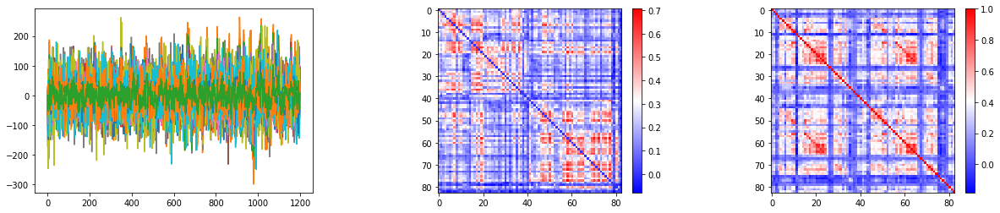

0.3433177567090032


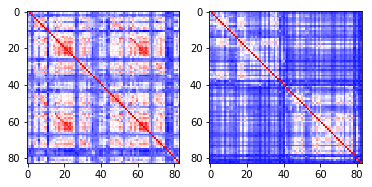

119 182739


<Figure size 432x288 with 0 Axes>

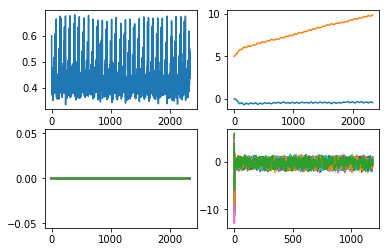

0.36834771190173826


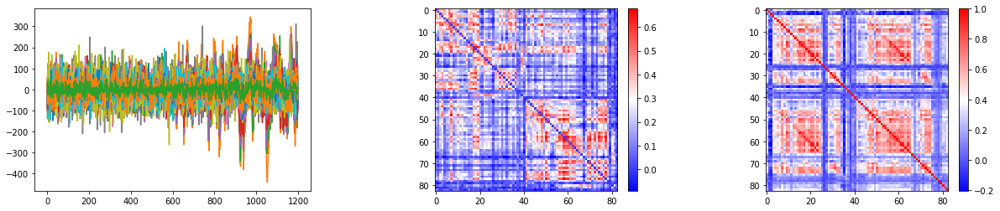

0.3685899715520726


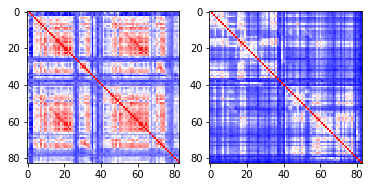

120 690152
121 150726
122 566454


<Figure size 432x288 with 0 Axes>

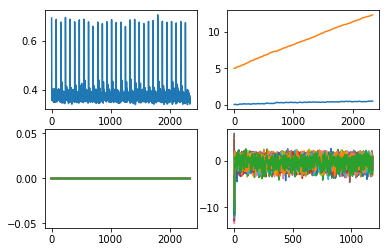

0.34602111816284964


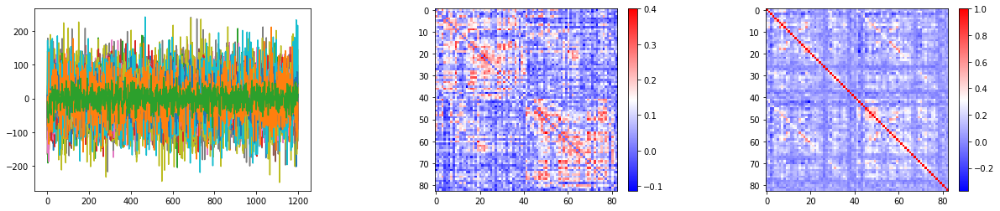

0.38720516424668383


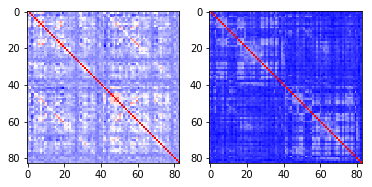

123 268850


<Figure size 432x288 with 0 Axes>

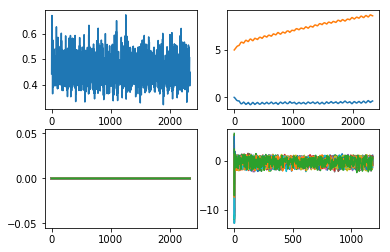

0.388780812884244


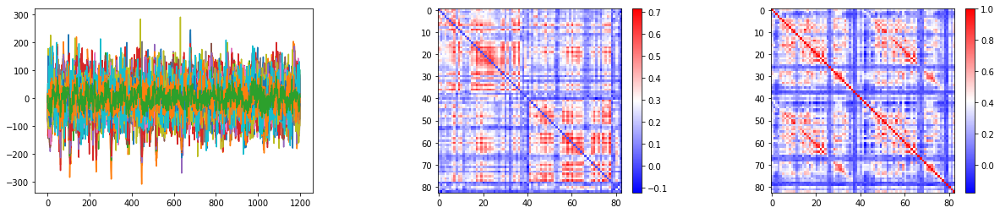

0.39003104422059764


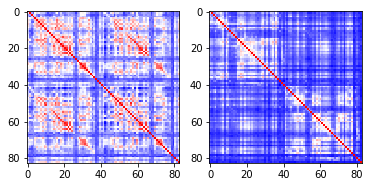

124 923755
125 479762
126 176037


<Figure size 432x288 with 0 Axes>

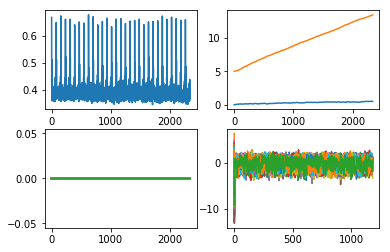

0.2898365898601733


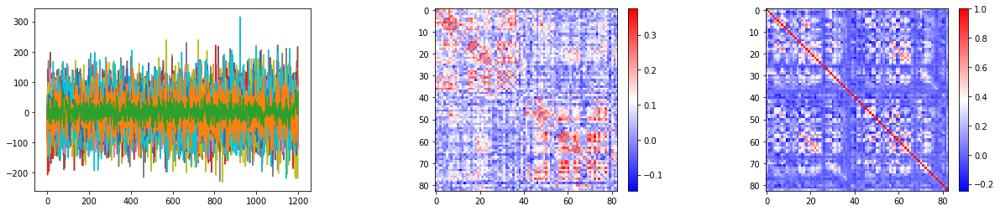

0.3307585695474728


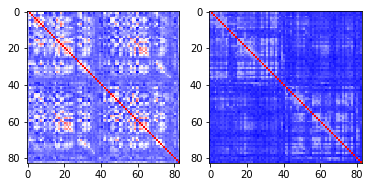

127 192439
128 693461
129 175237


<Figure size 432x288 with 0 Axes>

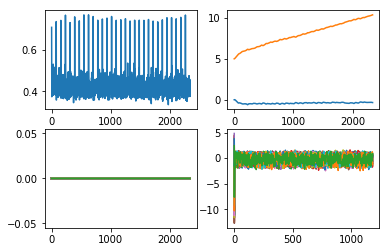

0.3463956826353726


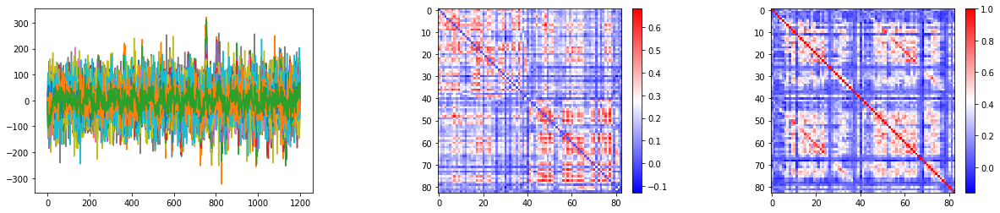

0.3891785943533034


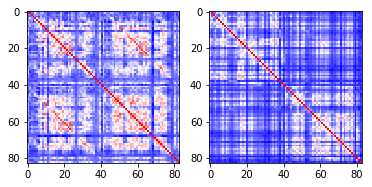

130 198249


<Figure size 432x288 with 0 Axes>

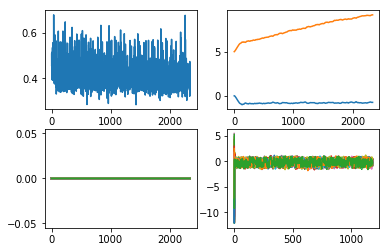

0.46666213141060736


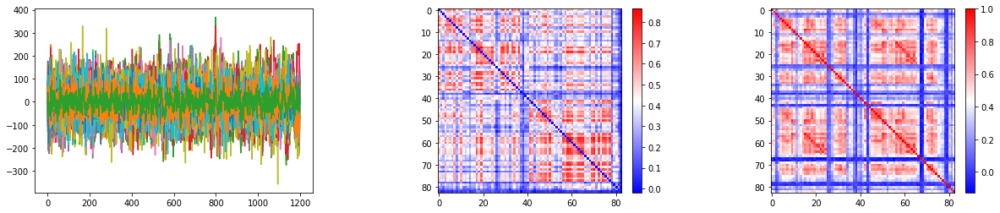

0.4941655751976719


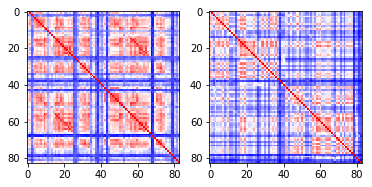

131 580650
132 176744


<Figure size 432x288 with 0 Axes>

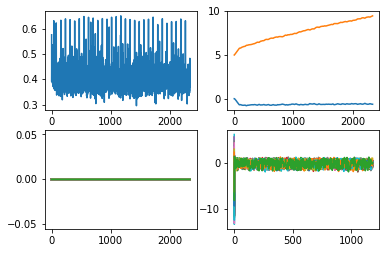

0.502770856474952


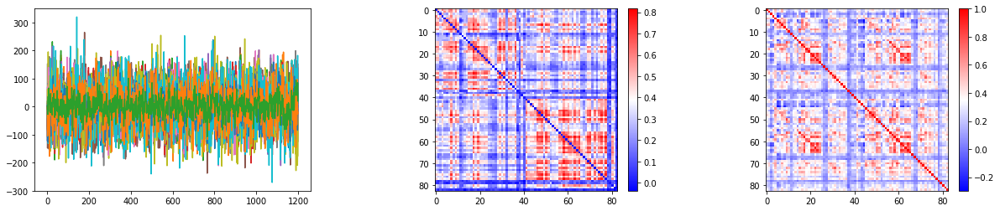

0.46607700828629356


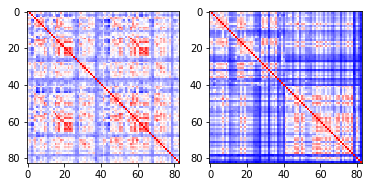

133 571144


<Figure size 432x288 with 0 Axes>

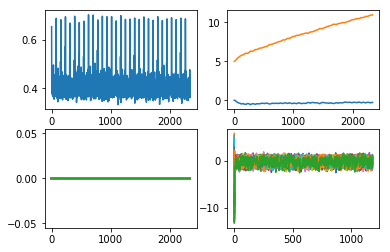

0.43535097100318804


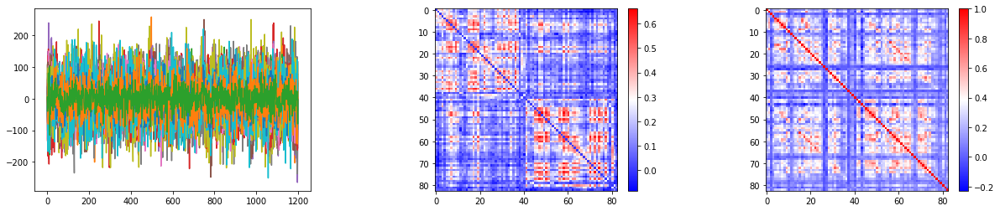

0.4579059486937204


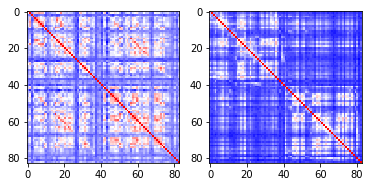

134 562345


<Figure size 432x288 with 0 Axes>

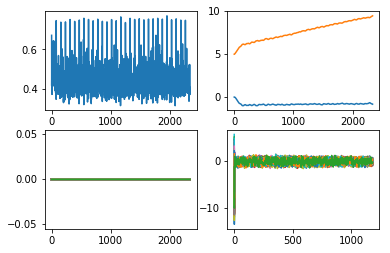

0.3880614110082479


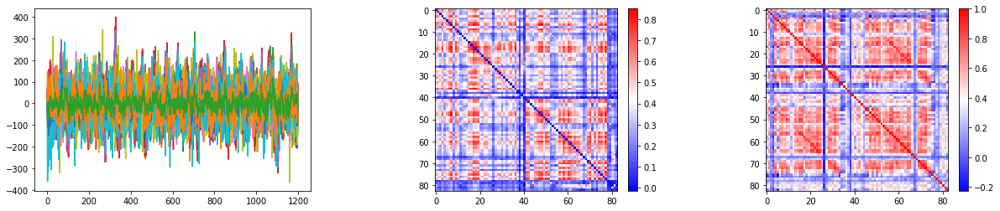

0.4081521936728652


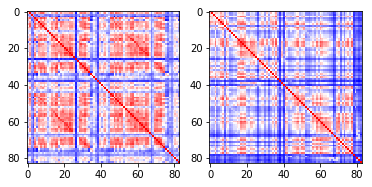

135 199453


<Figure size 432x288 with 0 Axes>

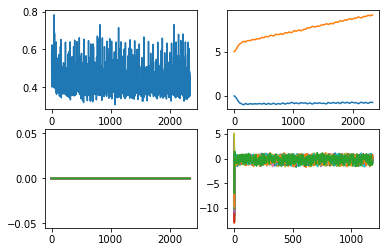

0.40676159509834403


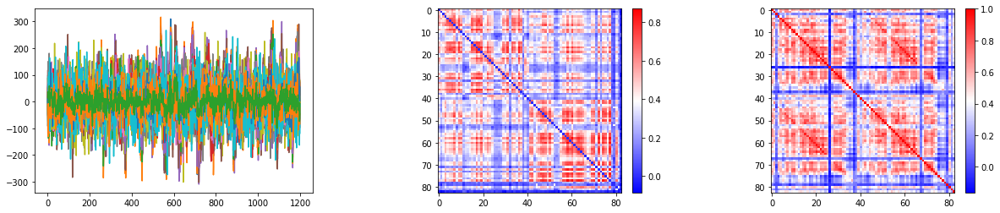

0.4167901494492163


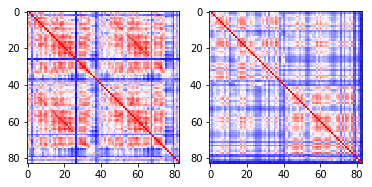

136 180836


<Figure size 432x288 with 0 Axes>

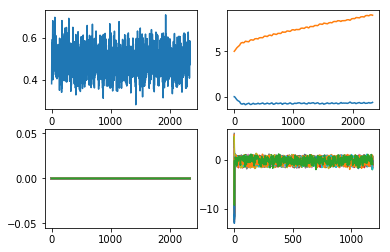

0.39767550931322765


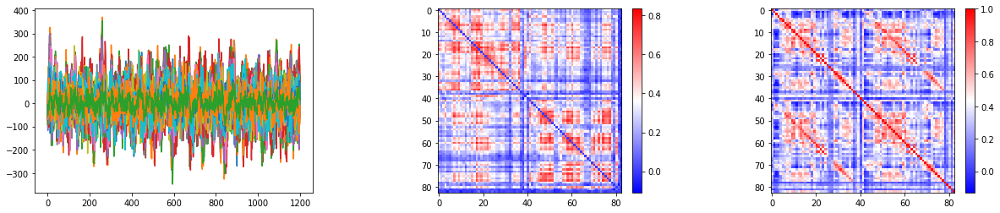

0.4142401860256827


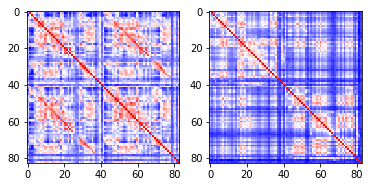

137 257845


<Figure size 432x288 with 0 Axes>

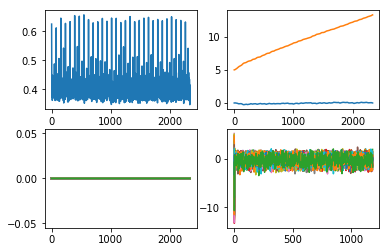

0.3057741614450924


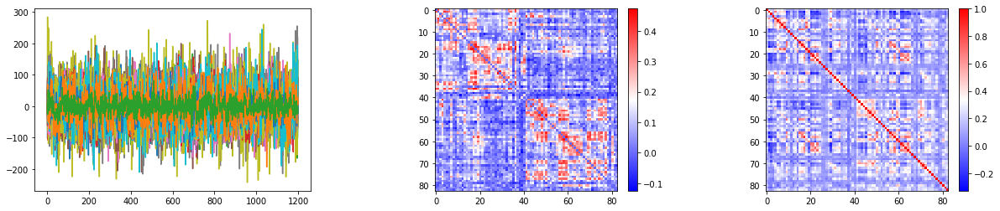

0.33266949599956436


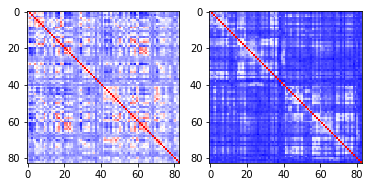

138 180735


<Figure size 432x288 with 0 Axes>

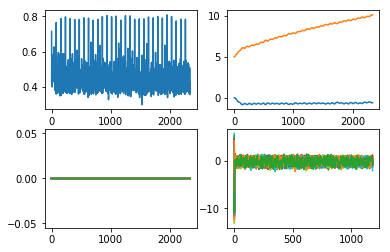

0.3669348828569428


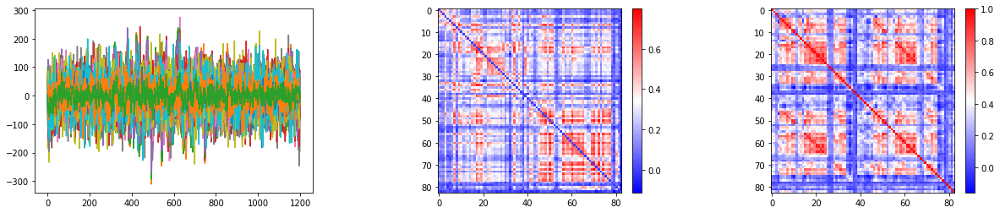

0.39034962981769594


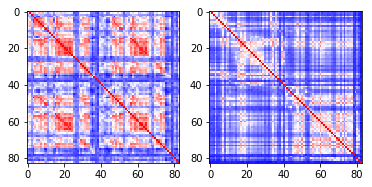

139 150524


<Figure size 432x288 with 0 Axes>

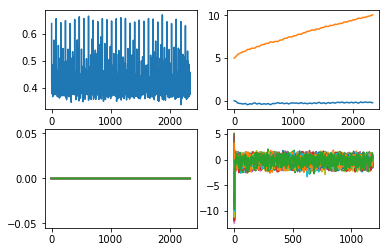

0.3036755761187779


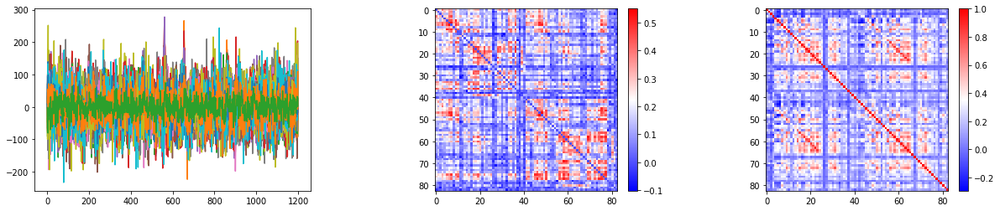

0.30963600592196416


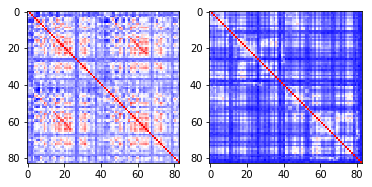

140 174437


<Figure size 432x288 with 0 Axes>

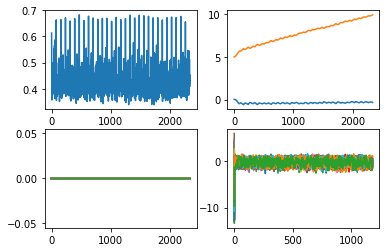

0.29045845662397995


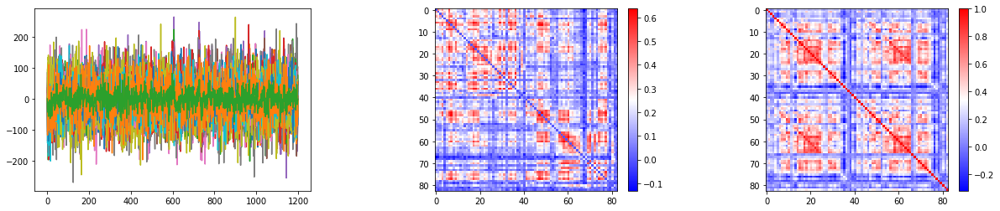

0.3064051769924466


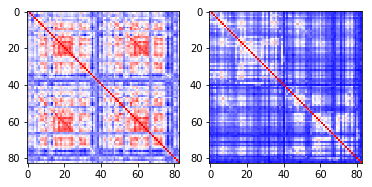

141 150625


<Figure size 432x288 with 0 Axes>

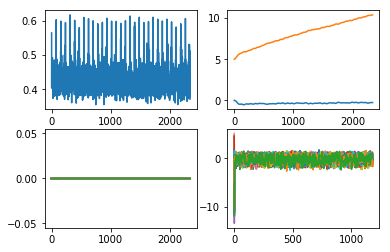

0.3581201182062824


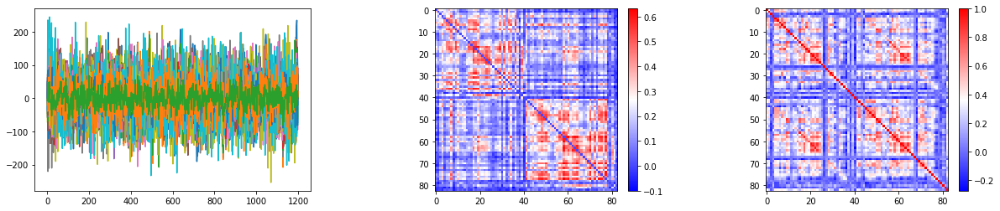

0.33972929294795867


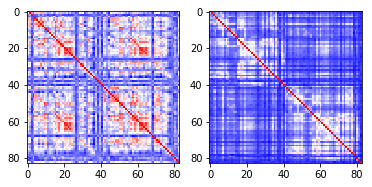

142 524135
143 172534


<Figure size 432x288 with 0 Axes>

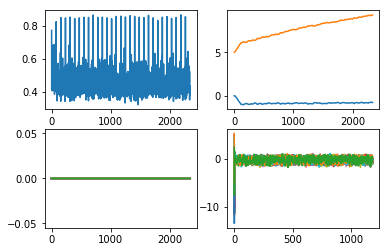

0.3355139400899643


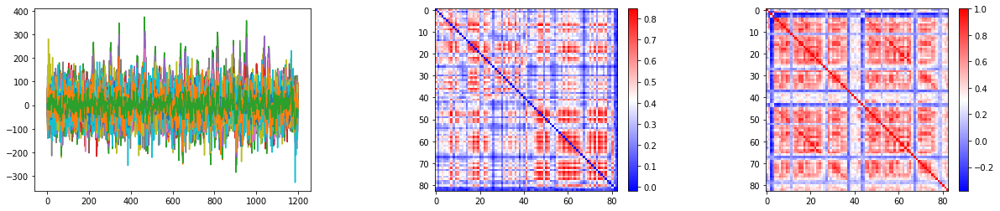

0.3859183991755669


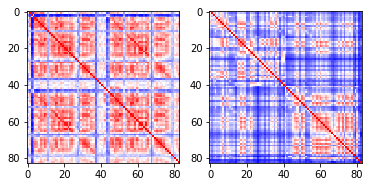

144 744553
145 506234
146 541943


<Figure size 432x288 with 0 Axes>

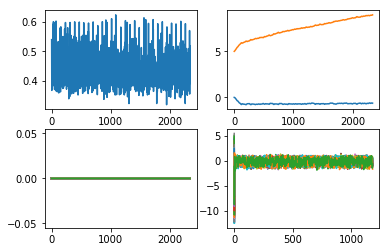

0.3588990756671641


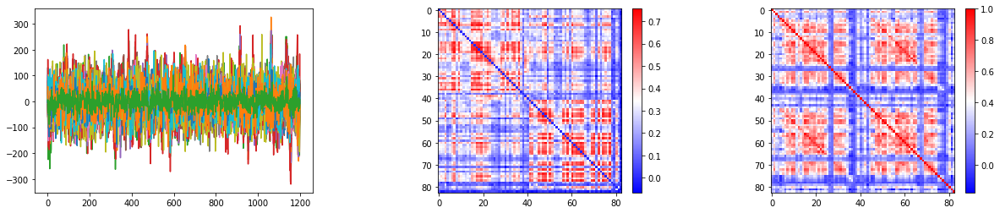

0.3759441943375086


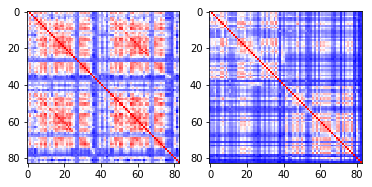

147 287248


<Figure size 432x288 with 0 Axes>

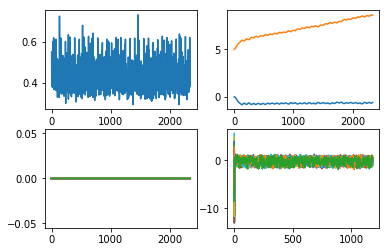

0.4626823625759362


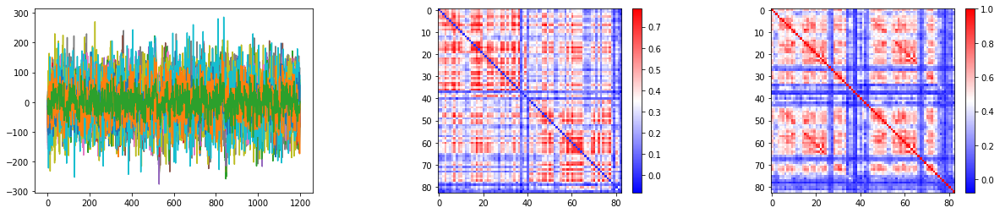

0.47838662784309965


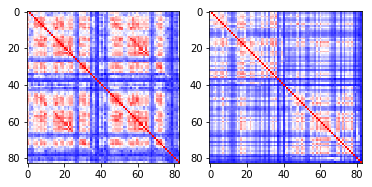

148 207426
149 657659
150 826353
151 644044
152 158540


<Figure size 432x288 with 0 Axes>

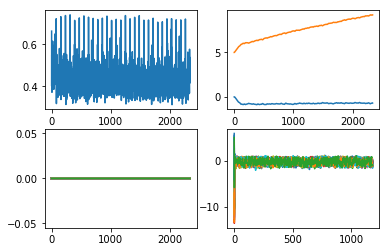

0.43677527340645034


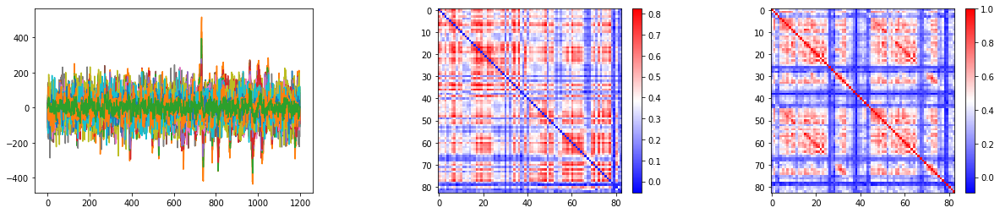

0.4529589067387419


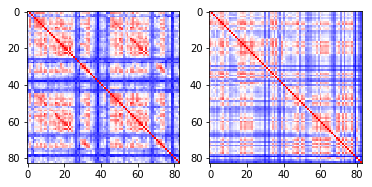

153 182032


<Figure size 432x288 with 0 Axes>

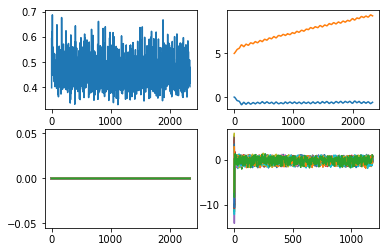

0.3629526017888081


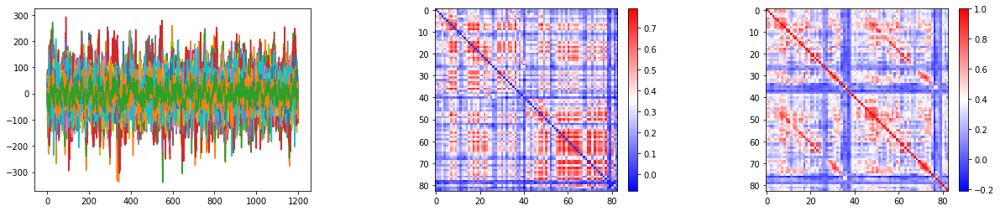

0.37124330986661336


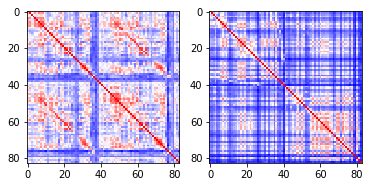

154 100206
155 217429
156 185846
157 173839


<Figure size 432x288 with 0 Axes>

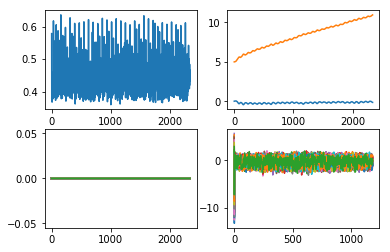

0.2554471095835585


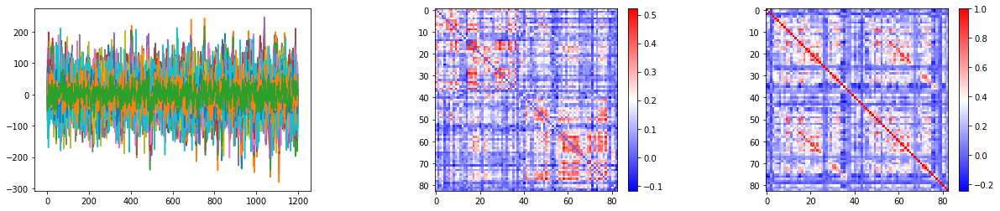

0.3228336914438466


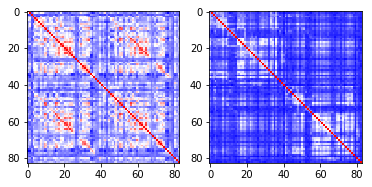

158 887373
159 549757


<Figure size 432x288 with 0 Axes>

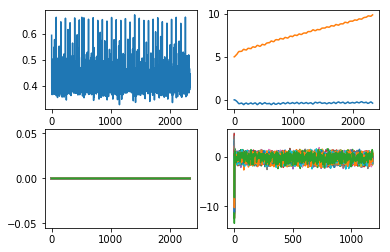

0.39007407112274933


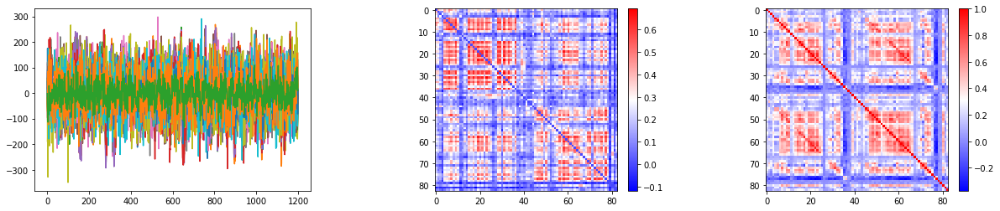

0.44284878282129314


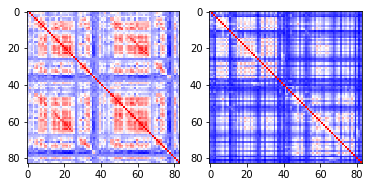

160 275645


<Figure size 432x288 with 0 Axes>

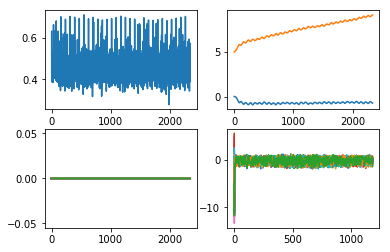

0.46432470705675655


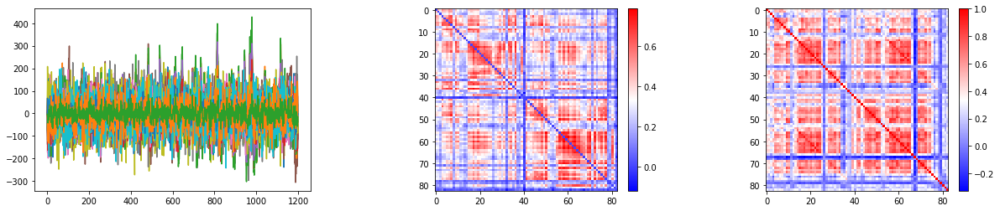

0.477011605743705


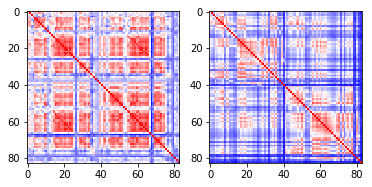

161 154734
162 545345


<Figure size 432x288 with 0 Axes>

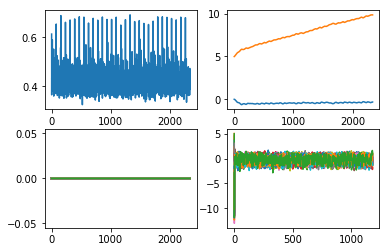

0.38935686114258383


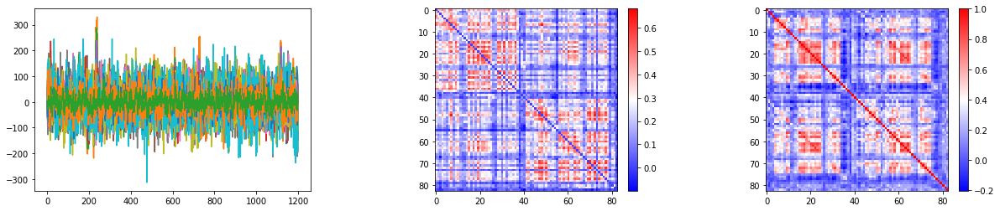

0.41051625016883425


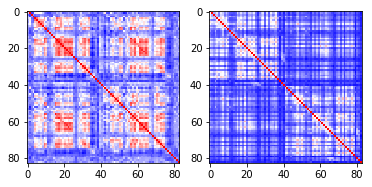

163 991267
164 158035


<Figure size 432x288 with 0 Axes>

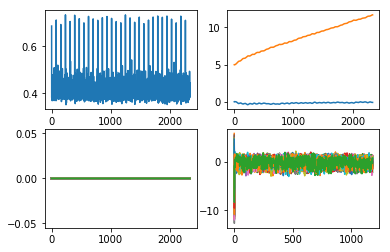

0.2766238003645309


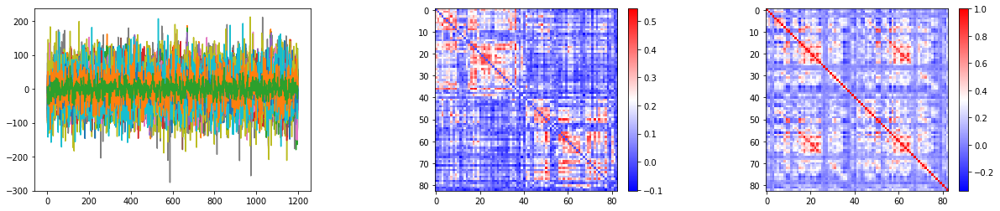

0.30418765548233634


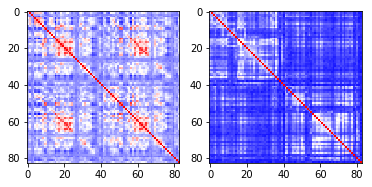

165 353740
166 175338
167 195647
168 316633


<Figure size 432x288 with 0 Axes>

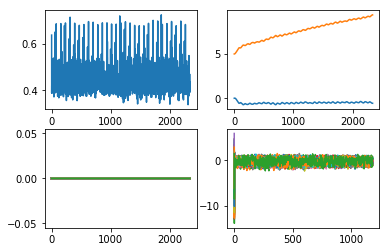

0.40199748092998944


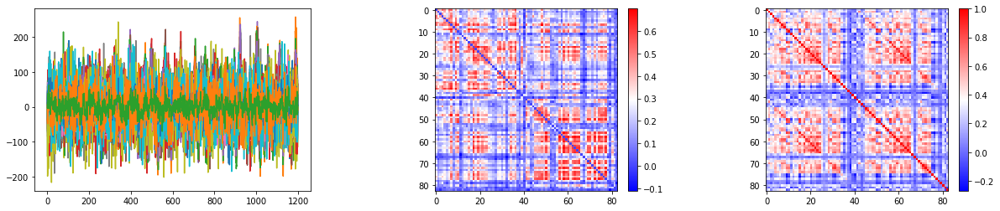

0.3902496170205038


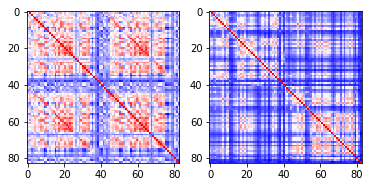

169 150019
170 285345


<Figure size 432x288 with 0 Axes>

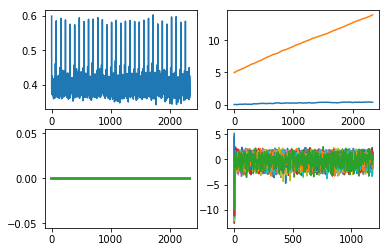

0.32149973087516576


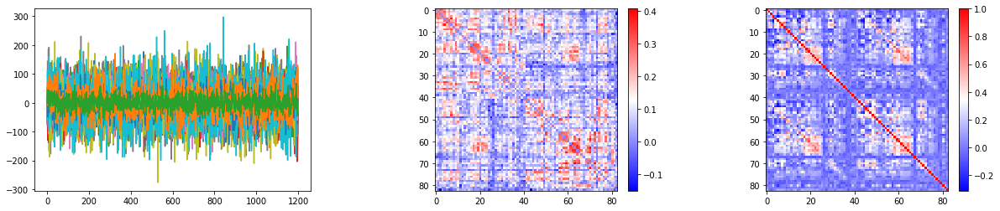

0.3696883485286371


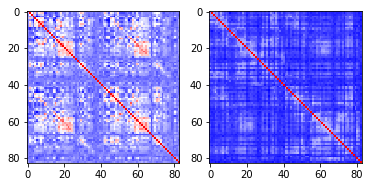

171 199958


<Figure size 432x288 with 0 Axes>

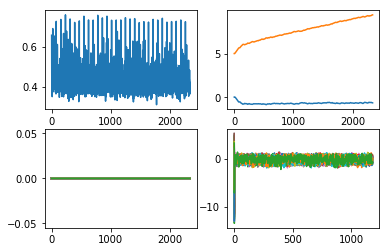

0.3720130974791724


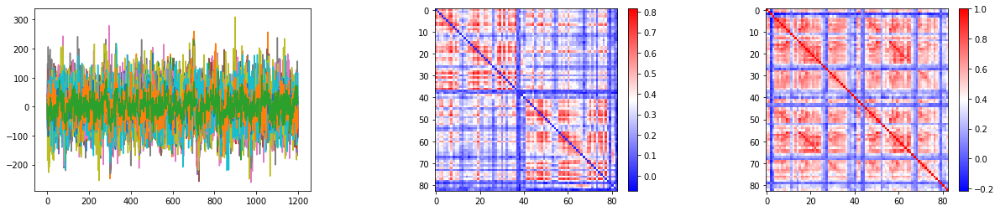

0.4004221058195146


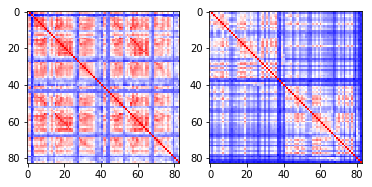

172 153429


<Figure size 432x288 with 0 Axes>

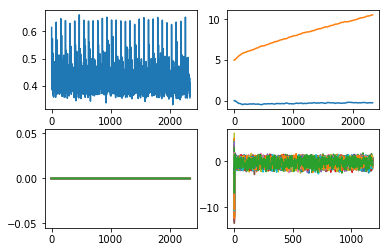

0.4147847306331257


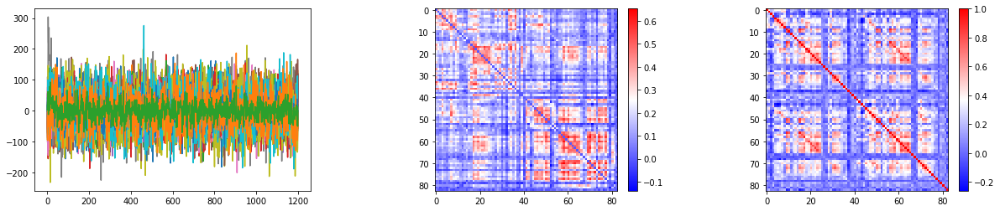

0.4422089320132387


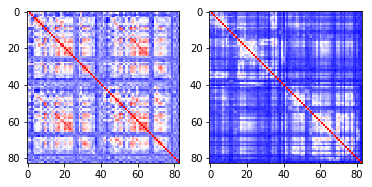

173 182436


<Figure size 432x288 with 0 Axes>

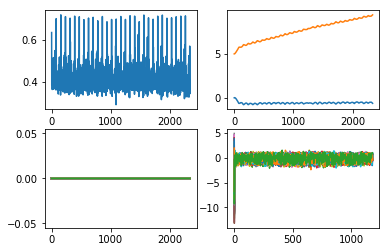

0.5940910369574554


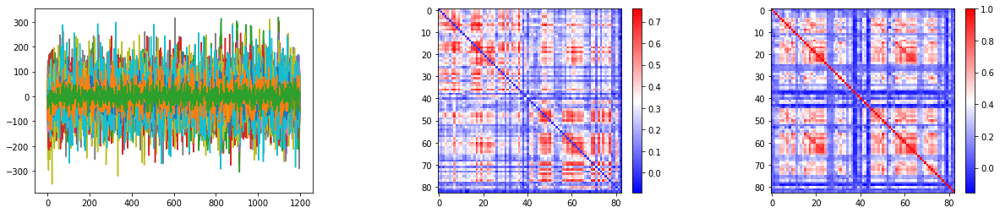

0.5924561699281505


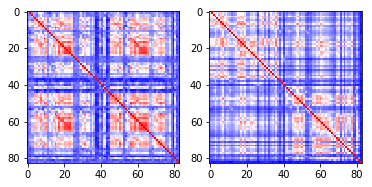

174 572045


<Figure size 432x288 with 0 Axes>

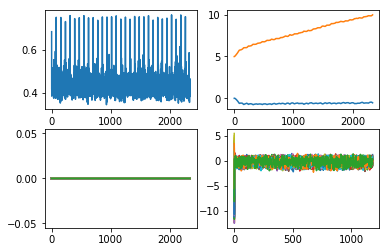

0.3654930913782958


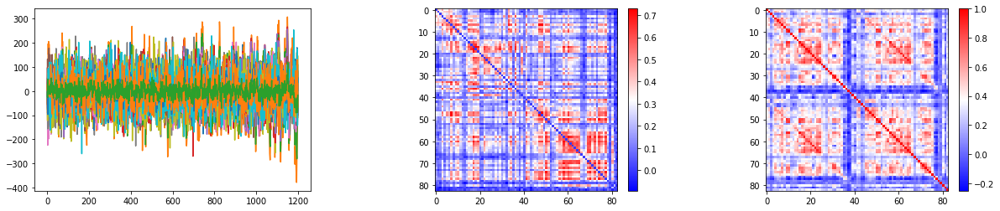

0.3691515221432505


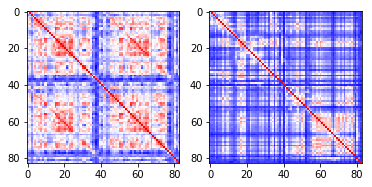

175 130922
176 268749
177 456346


<Figure size 432x288 with 0 Axes>

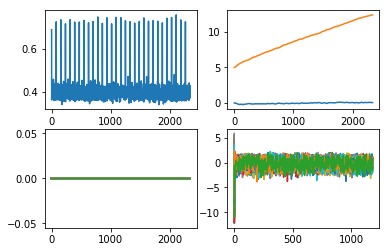

0.3559568161880661


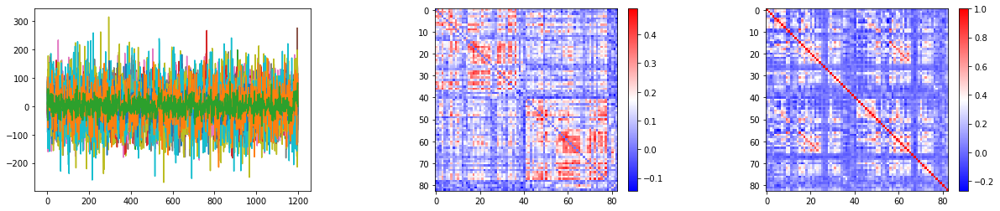

0.4014834133079097


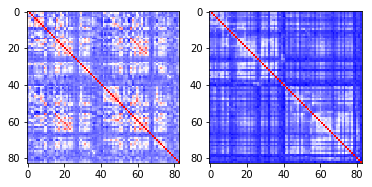

178 555348


<Figure size 432x288 with 0 Axes>

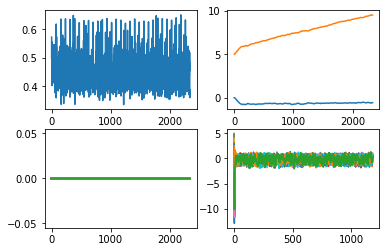

0.34655004773778336


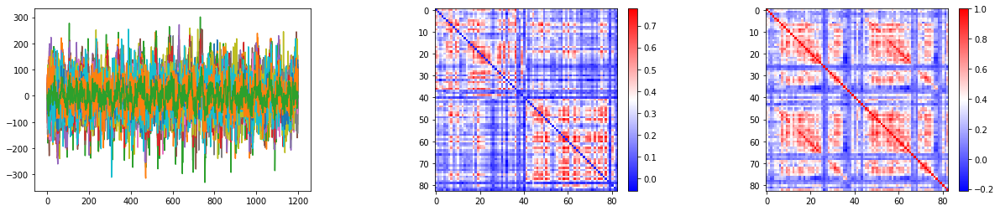

0.36997270552191547


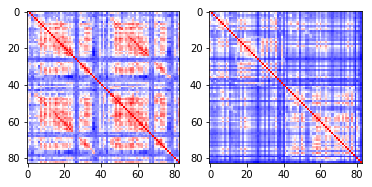

179 724446
180 280739


<Figure size 432x288 with 0 Axes>

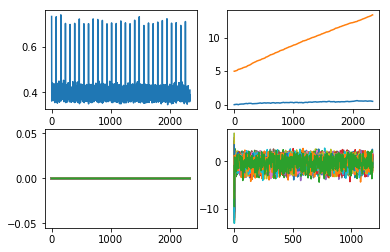

0.228877300932518


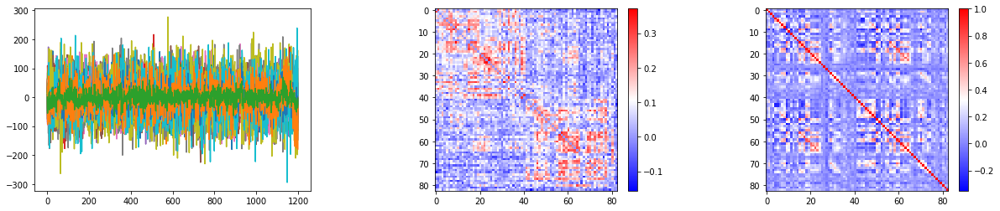

0.2426603563538003


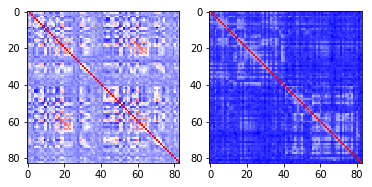

181 153732


<Figure size 432x288 with 0 Axes>

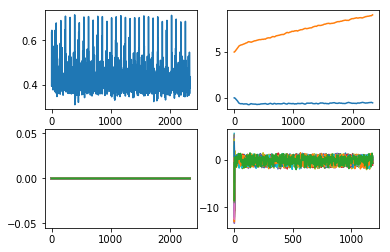

0.4732405377607363


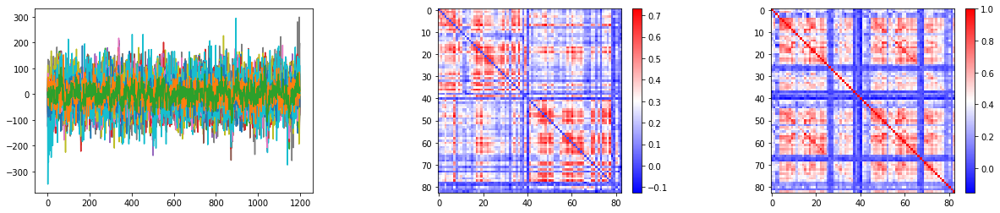

0.47026586815276344


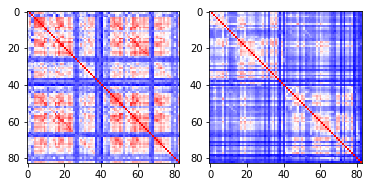

182 198855


<Figure size 432x288 with 0 Axes>

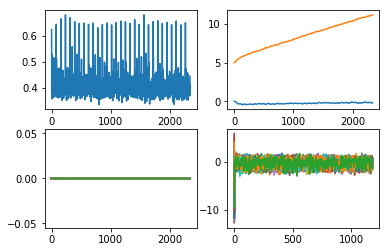

0.3394717518928978


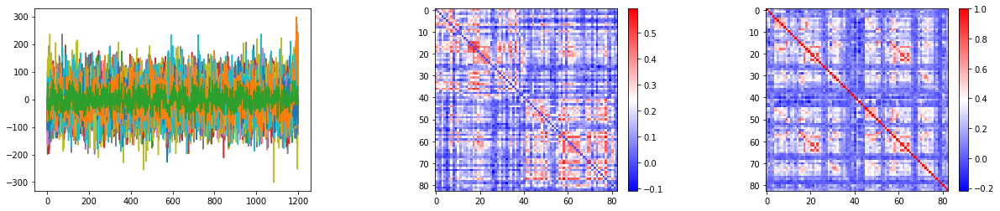

0.4029439261835301


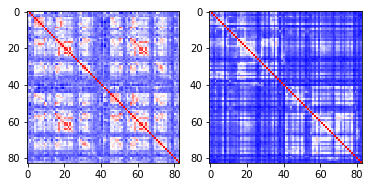

183 540436


<Figure size 432x288 with 0 Axes>

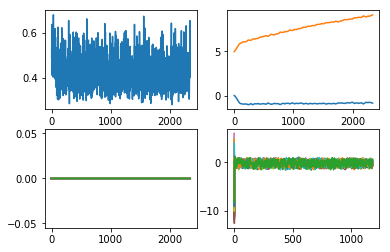

0.43894313118665274


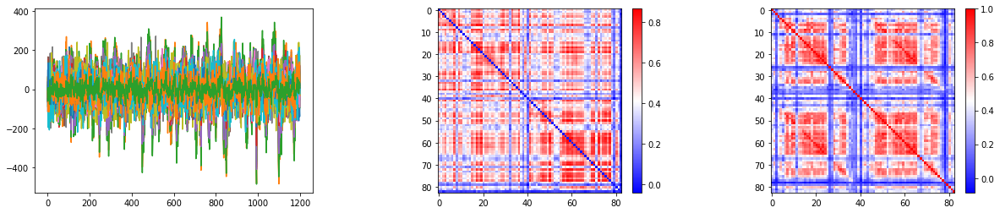

0.4552404392812521


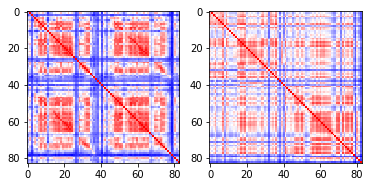

184 173435


<Figure size 432x288 with 0 Axes>

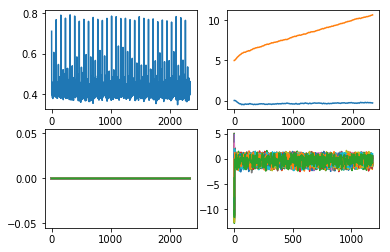

0.4218679850330372


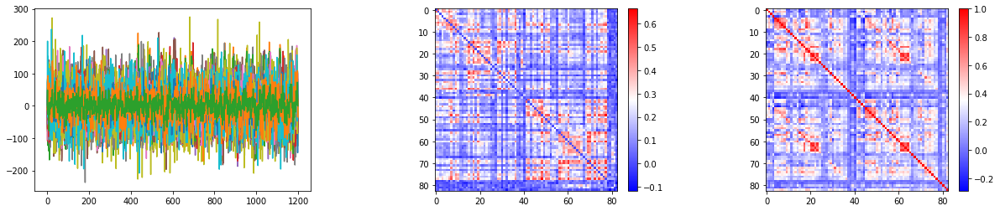

0.4639180233243896


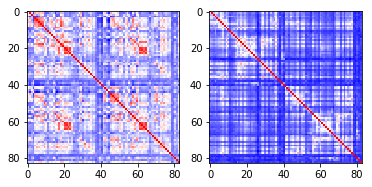

185 233326
186 580044


<Figure size 432x288 with 0 Axes>

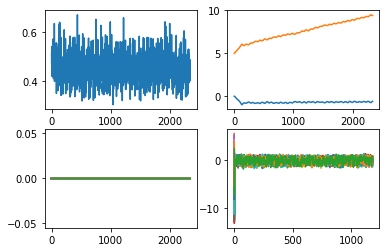

0.3573784439746867


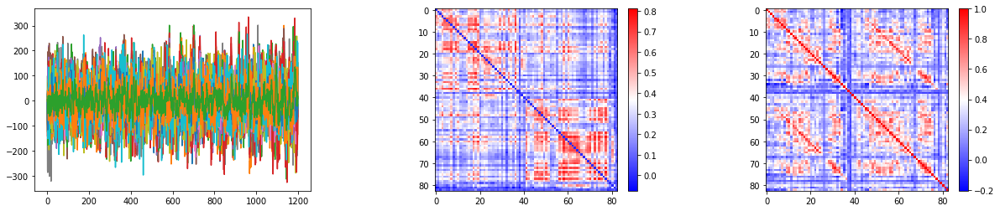

0.3534438843686402


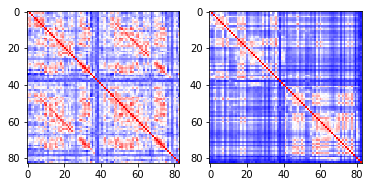

187 351938
188 523032


<Figure size 432x288 with 0 Axes>

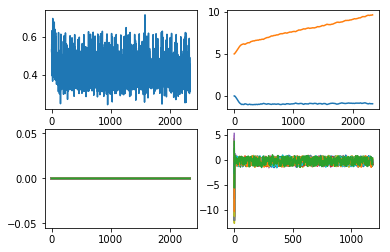

0.5872800939452315


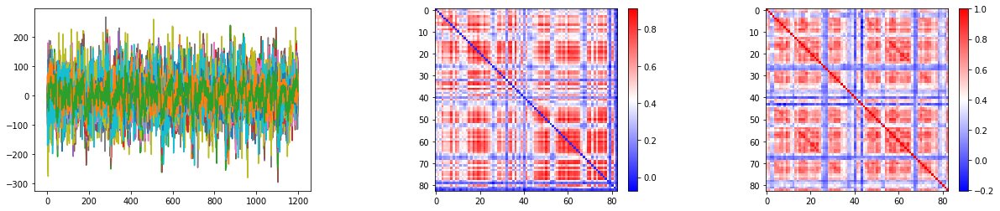

0.5720960171580666


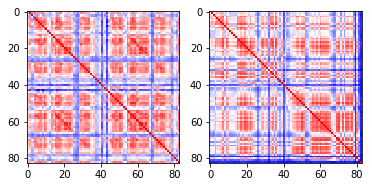

189 856968
190 177645


<Figure size 432x288 with 0 Axes>

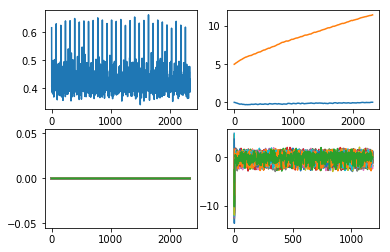

0.2520042787101237


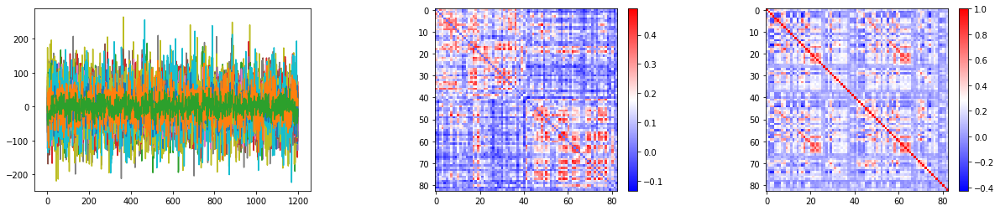

0.2788296183225608


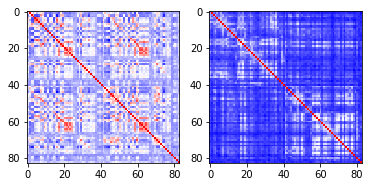

191 162228
192 263436


<Figure size 432x288 with 0 Axes>

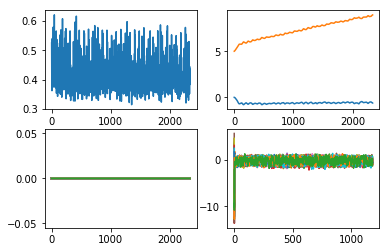

0.3696336340337314


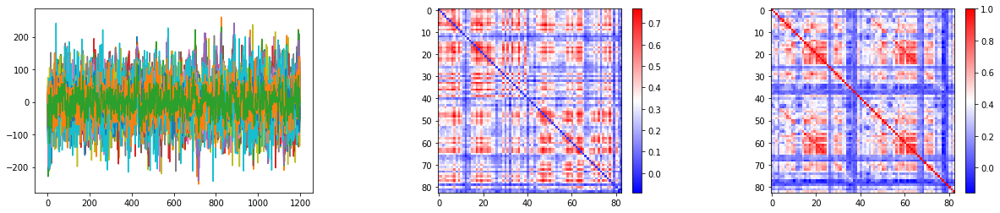

0.37020651702279217


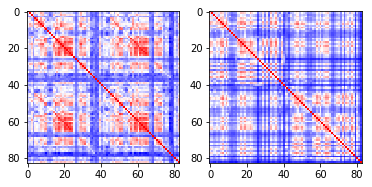

193 927359
194 896879
195 901139
196 154431


<Figure size 432x288 with 0 Axes>

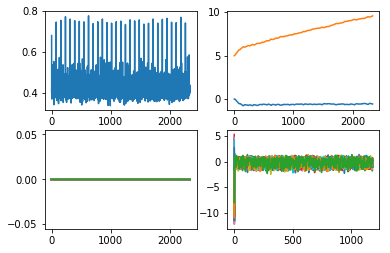

0.4278100707849731


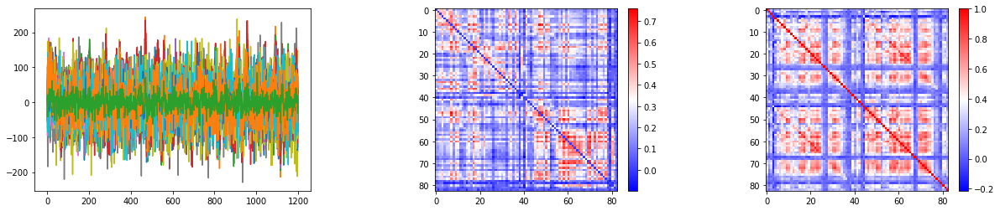

0.42930539873141016


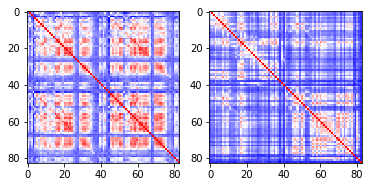

197 475855


<Figure size 432x288 with 0 Axes>

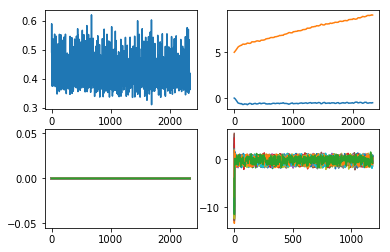

0.4015378248016704


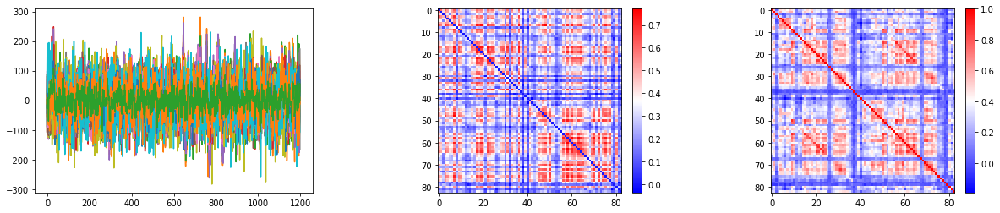

0.40673432237631424


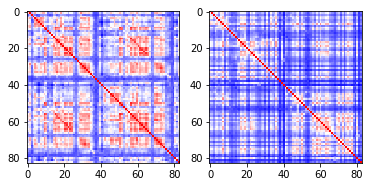

198 530635


<Figure size 432x288 with 0 Axes>

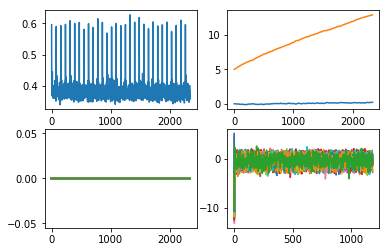

0.4110243699890312


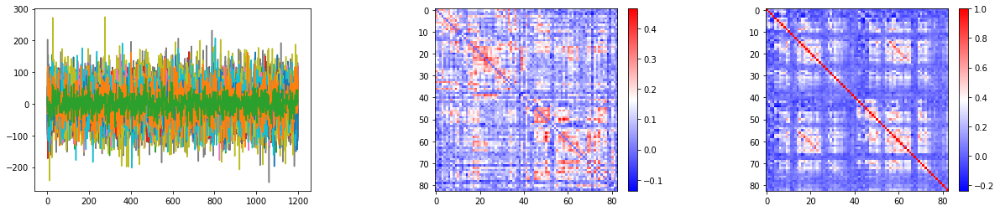

0.44432161101650985


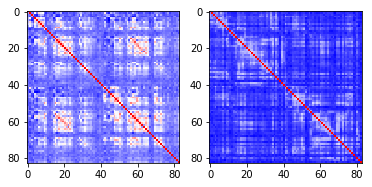

199 843151
200 175439


<Figure size 432x288 with 0 Axes>

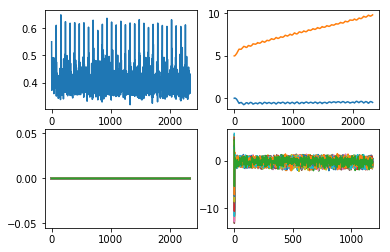

0.5010455248304574


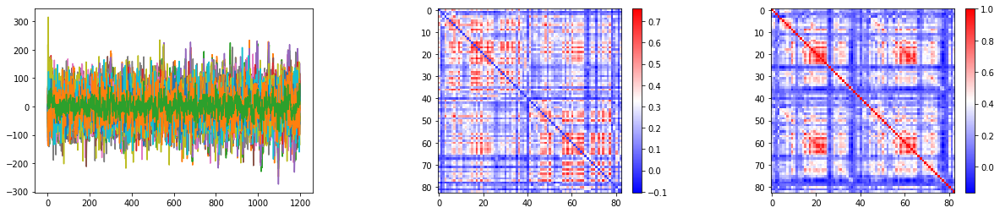

0.4740016783718515


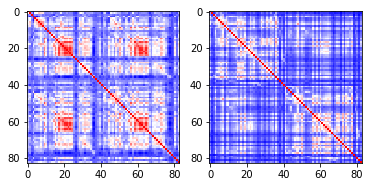

201 144125
202 510326


<Figure size 432x288 with 0 Axes>

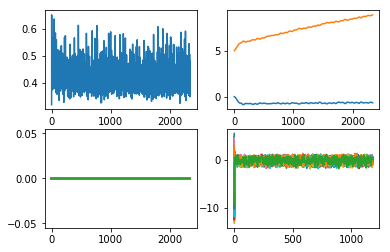

0.3209710464771493


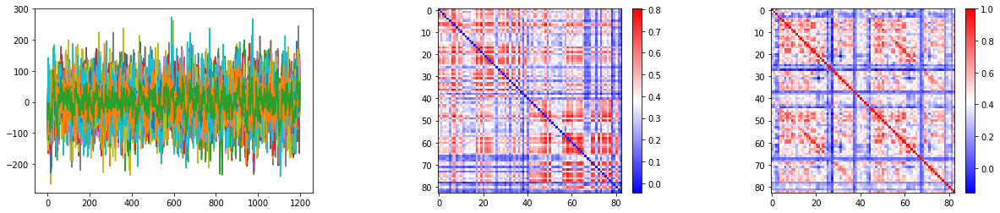

0.3027877142759938


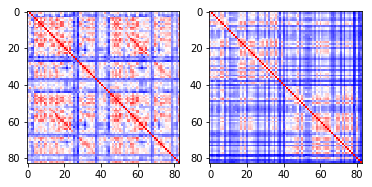

203 293748


<Figure size 432x288 with 0 Axes>

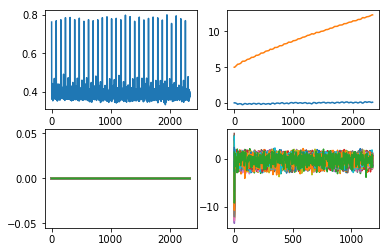

0.39575326531251614


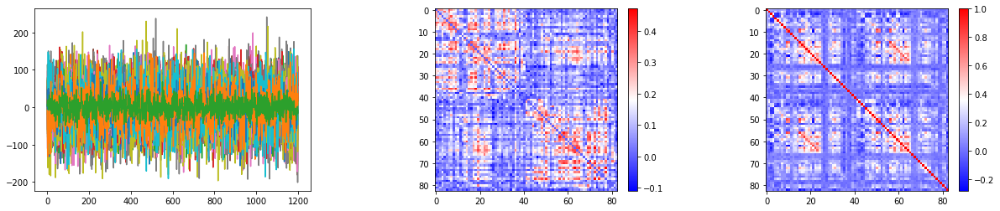

0.42911516981333264


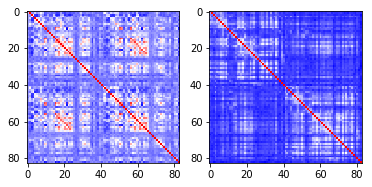

204 148436
205 128935
206 459453


<Figure size 432x288 with 0 Axes>

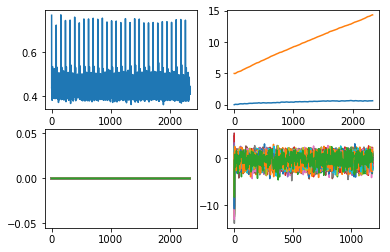

0.2030468951378861


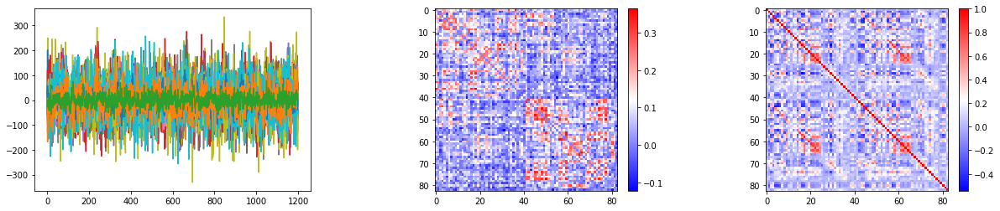

0.25655820479435115


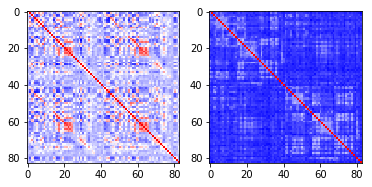

207 485757


<Figure size 432x288 with 0 Axes>

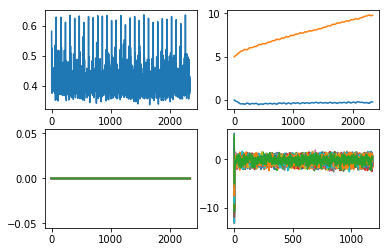

0.4155887434276174


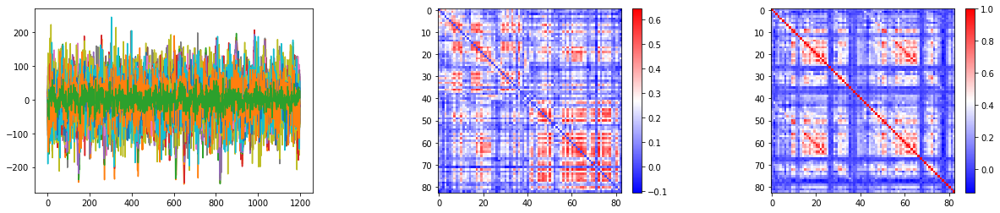

0.4441542862665517


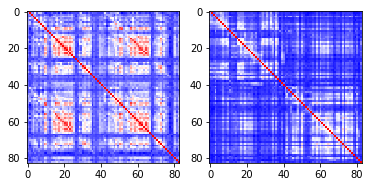

208 304020


<Figure size 432x288 with 0 Axes>

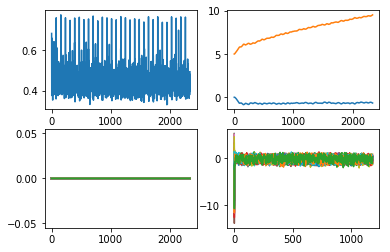

0.36142934505696606


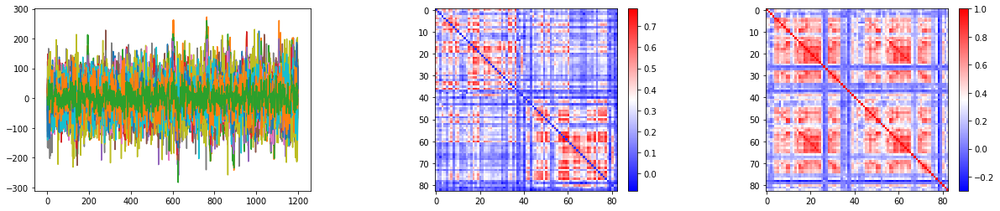

0.3723432026729007


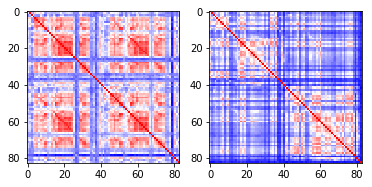

209 142828
210 209834
211 378857
212 522434


<Figure size 432x288 with 0 Axes>

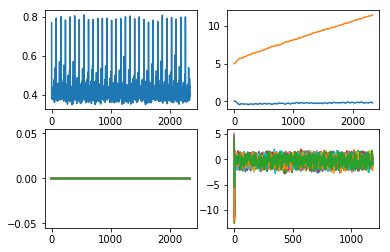

0.2782609914167173


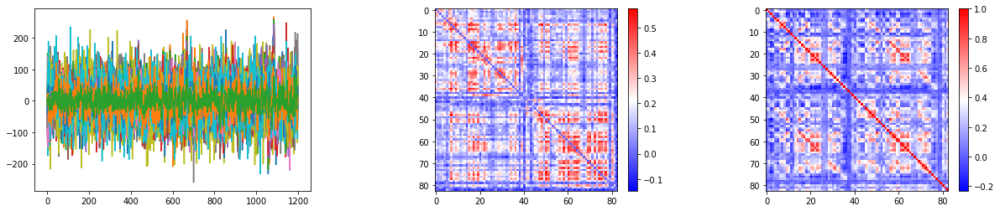

0.2979728925036733


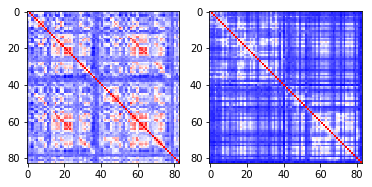

213 151425


<Figure size 432x288 with 0 Axes>

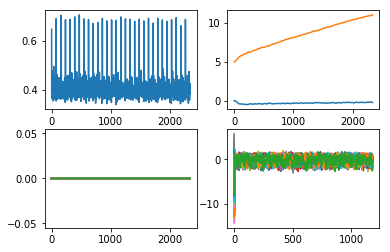

0.3464426032326423


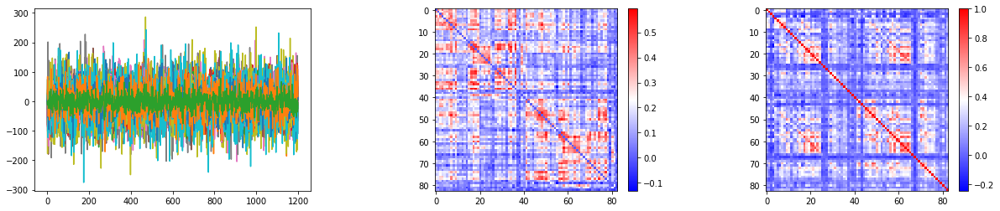

0.3991658130212311


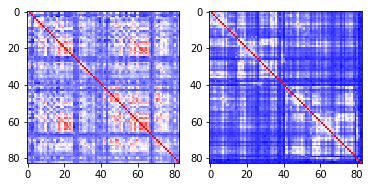

214 180937
215 580751
216 289555


<Figure size 432x288 with 0 Axes>

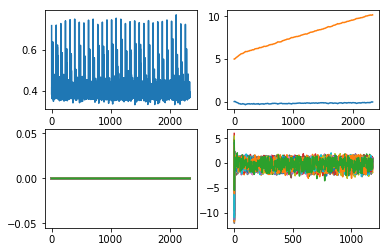

0.4488415703715346


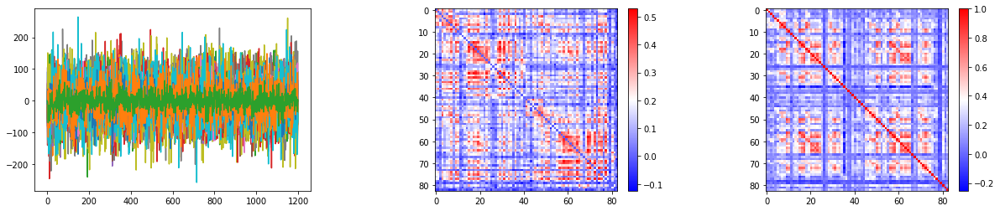

0.4498566789428751


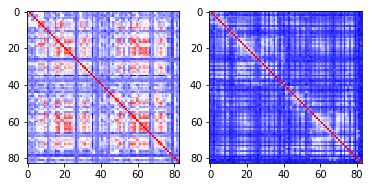

217 175742


<Figure size 432x288 with 0 Axes>

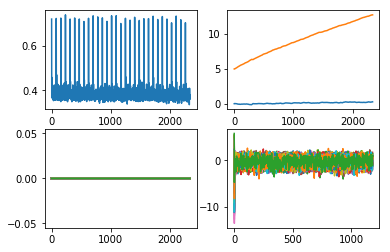

0.3612440287985847


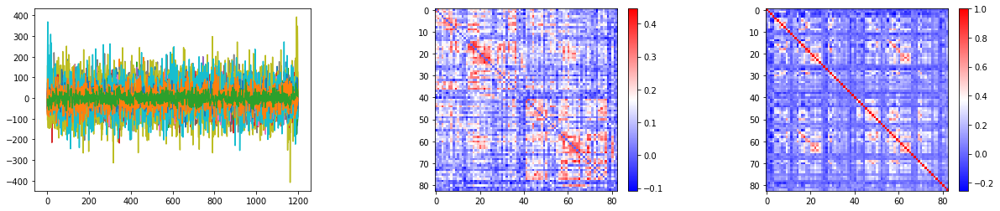

0.3987435498454558


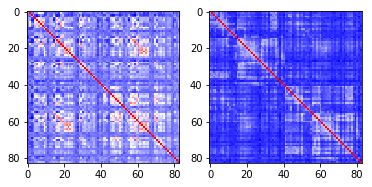

218 308331


<Figure size 432x288 with 0 Axes>

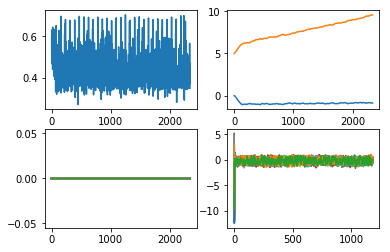

0.4718419984384674


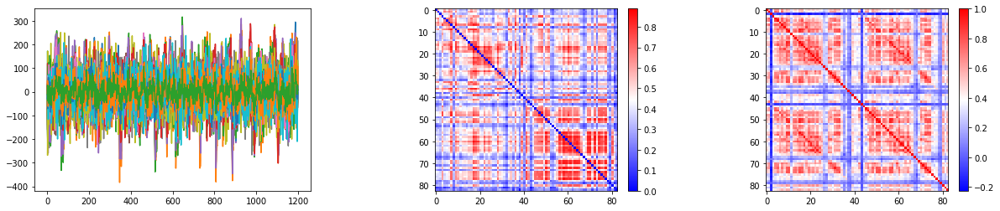

0.45020085823307976


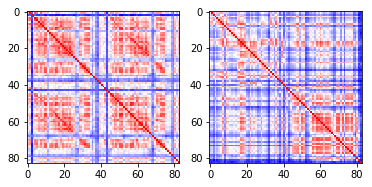

219 187850
220 912447
221 513736


<Figure size 432x288 with 0 Axes>

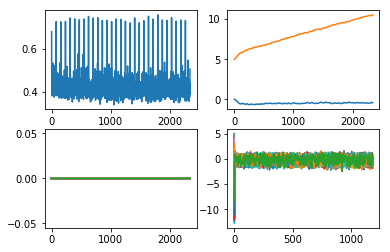

0.4461094789220233


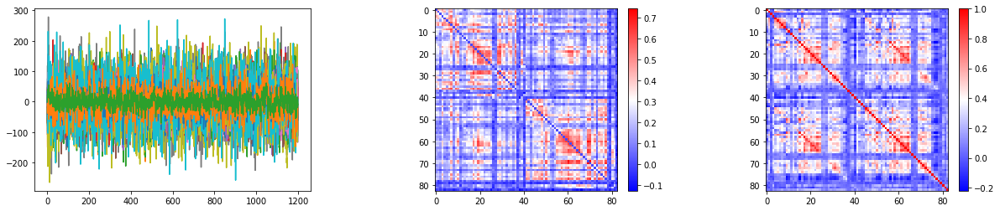

0.4313735265492344


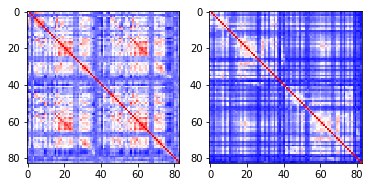

222 441939


<Figure size 432x288 with 0 Axes>

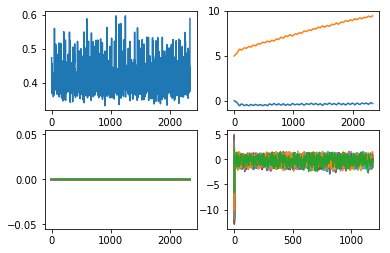

0.46180317170268326


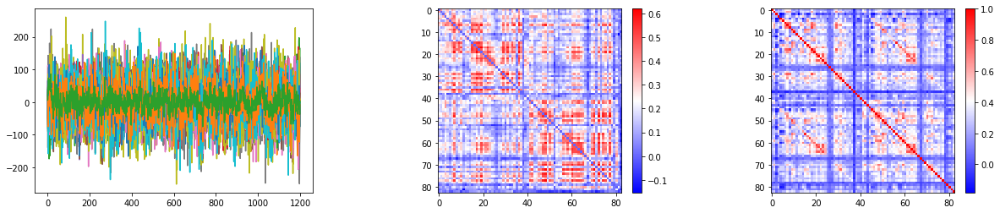

0.47025522042041473


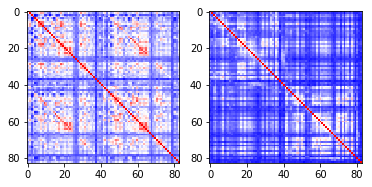

223 158136


<Figure size 432x288 with 0 Axes>

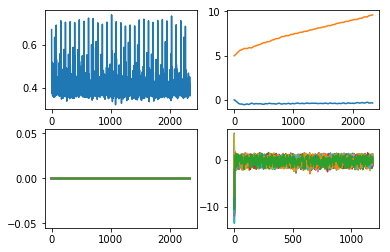

0.4707780271913231


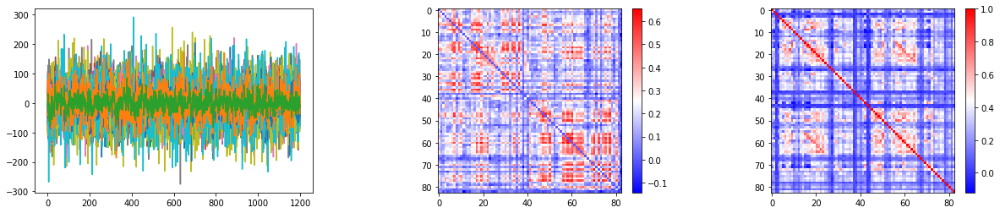

0.4772905347730319


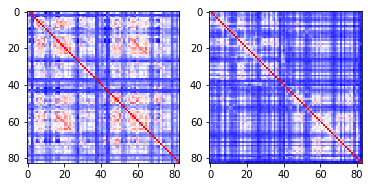

224 497865


<Figure size 432x288 with 0 Axes>

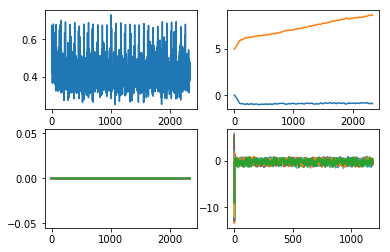

0.4383991281018821


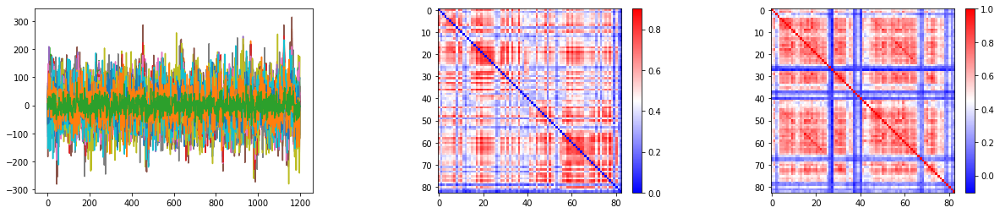

0.4854225219928142


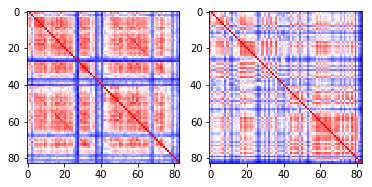

225 124826
226 134829
227 197348


<Figure size 432x288 with 0 Axes>

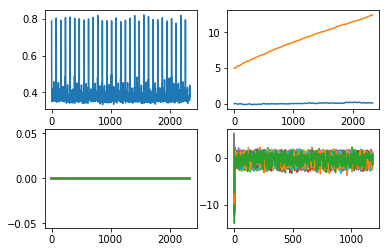

0.38226278240165795


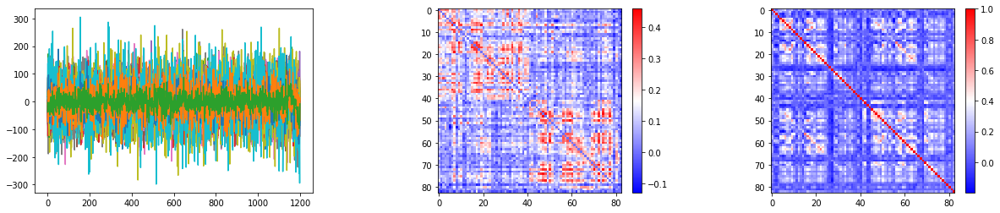

0.44168858432298697


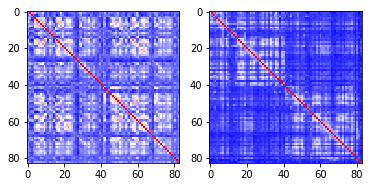

228 194847
229 172433


<Figure size 432x288 with 0 Axes>

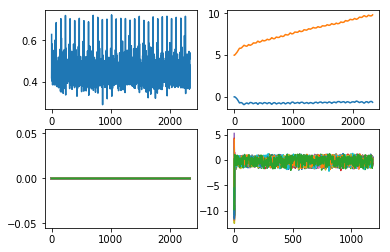

0.3761746733656677


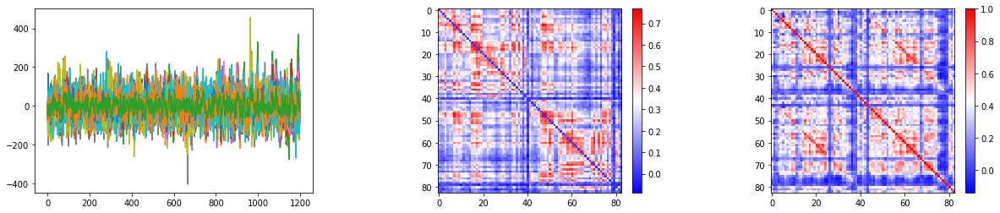

0.33303415355515825


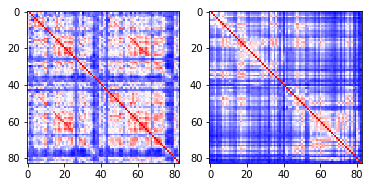

230 214524
231 320826


<Figure size 432x288 with 0 Axes>

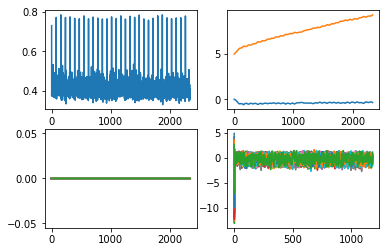

0.4234102319079385


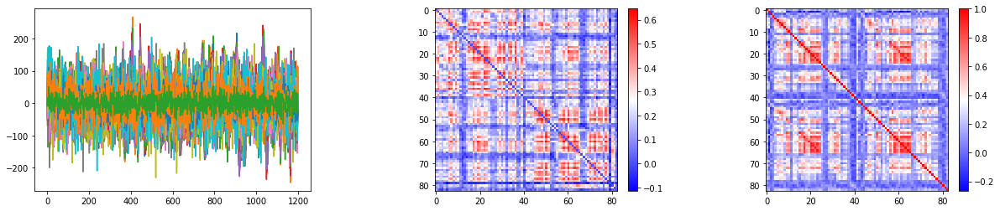

0.42147503609855924


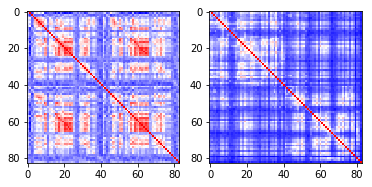

232 310621


<Figure size 432x288 with 0 Axes>

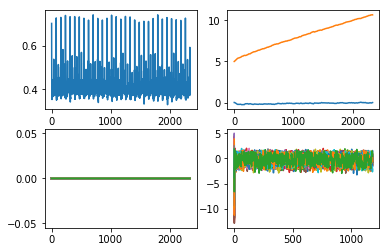

0.32568935914941416


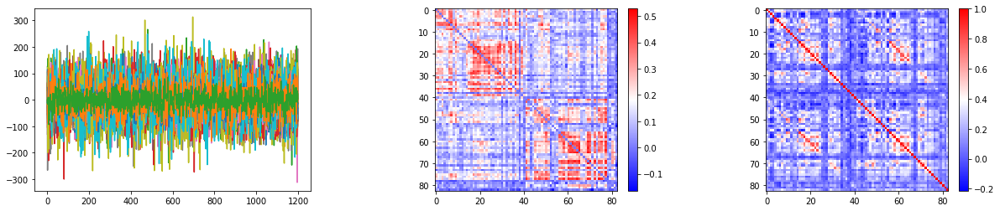

0.3354726658616269


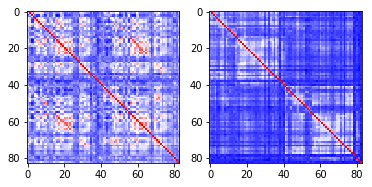

233 173334


<Figure size 432x288 with 0 Axes>

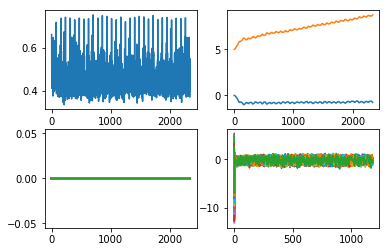

0.3043367767287647


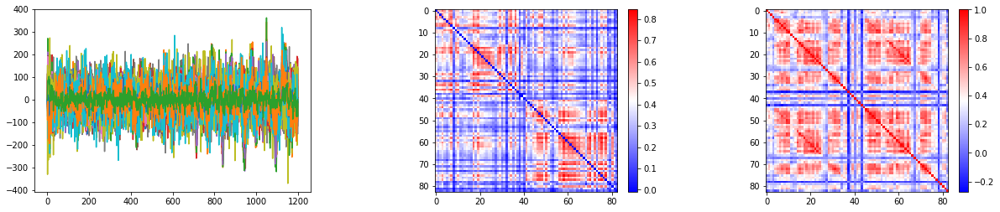

0.2945224532637554


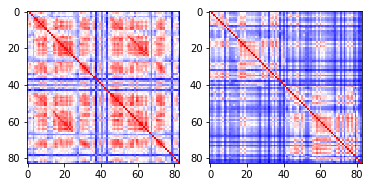

234 284646


<Figure size 432x288 with 0 Axes>

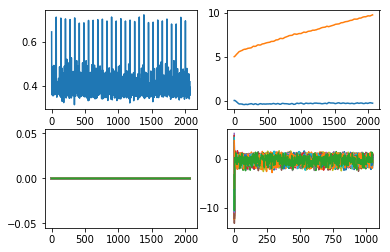

0.461908105854868


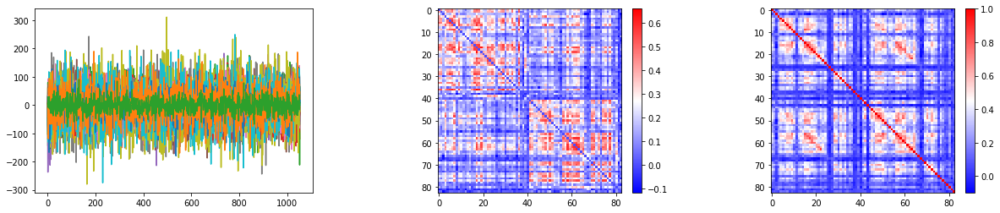

0.4701798827204372


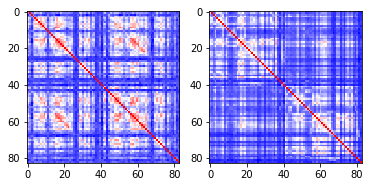

235 155635


<Figure size 432x288 with 0 Axes>

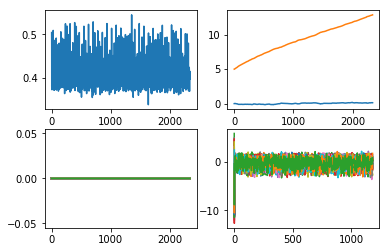

0.27783420206141035


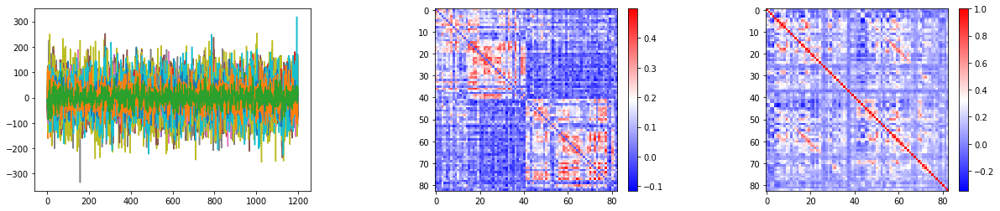

0.3190437910749292


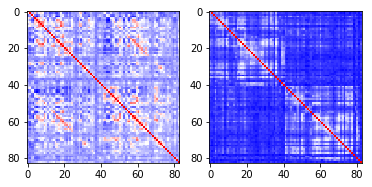

236 152831
237 156031


<Figure size 432x288 with 0 Axes>

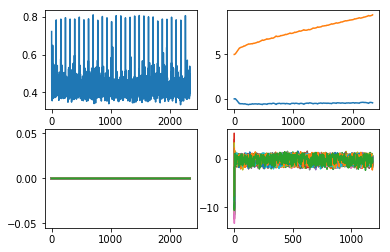

0.42226502461340143


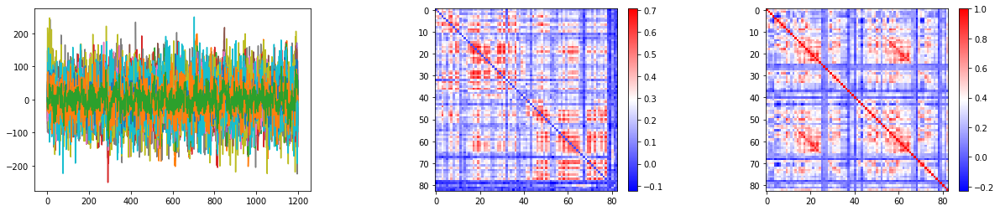

0.3951352109853708


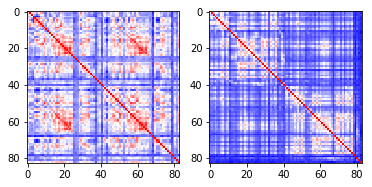

238 153227


<Figure size 432x288 with 0 Axes>

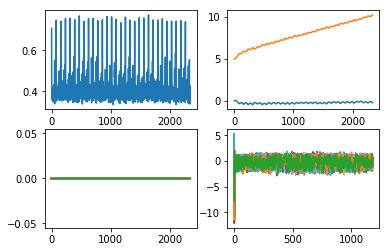

0.4650814314063007


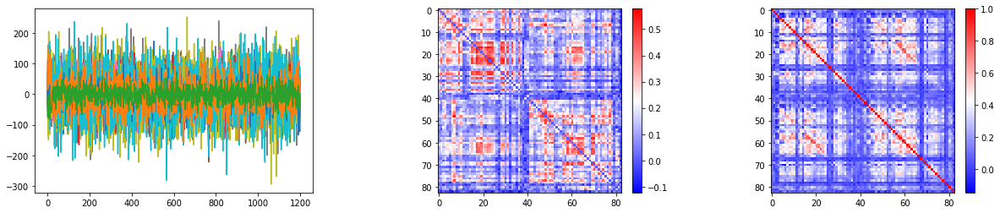

0.48666349957653465


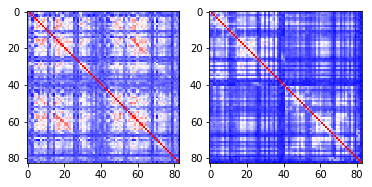

239 176239


<Figure size 432x288 with 0 Axes>

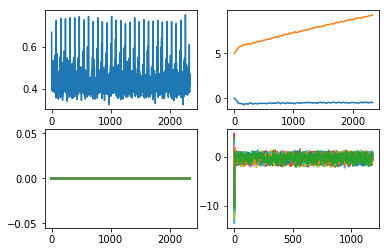

0.4317207362986831


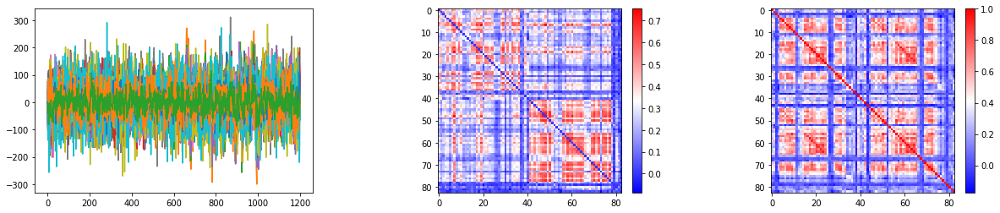

0.4423142723566054


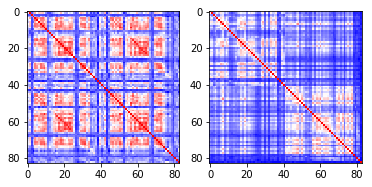

240 160931
241 159946
242 154835


<Figure size 432x288 with 0 Axes>

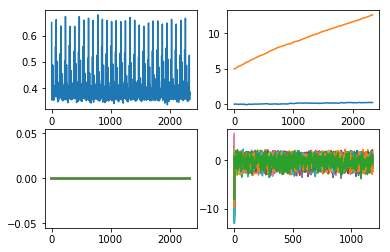

0.4467758918026362


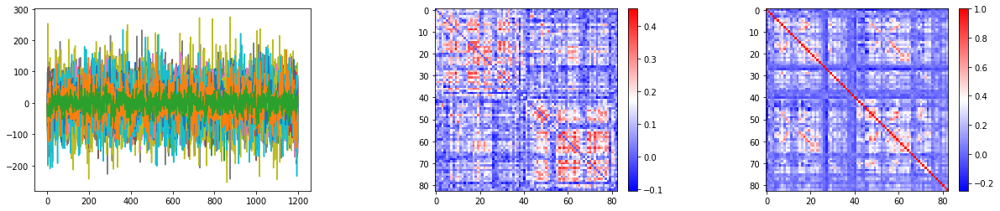

0.47163210050600834


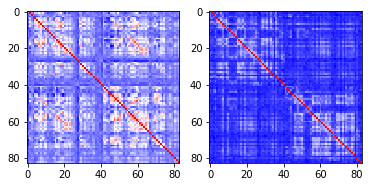

243 157437


<Figure size 432x288 with 0 Axes>

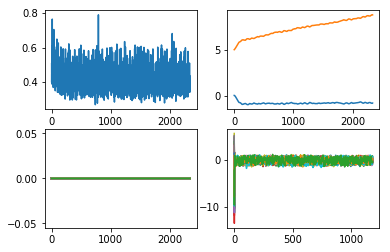

0.45650007479321825


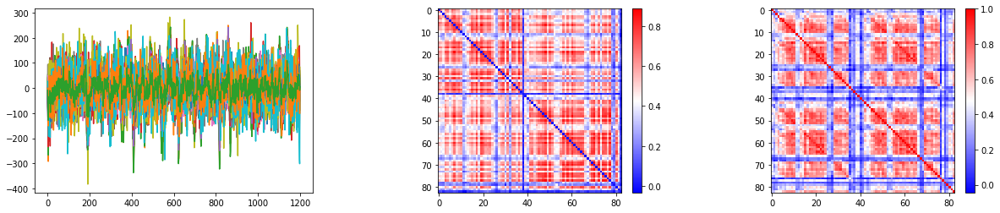

0.45830805245066575


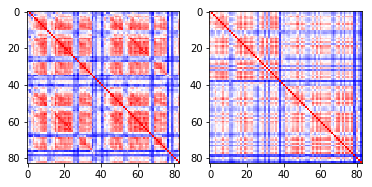

244 467351


<Figure size 432x288 with 0 Axes>

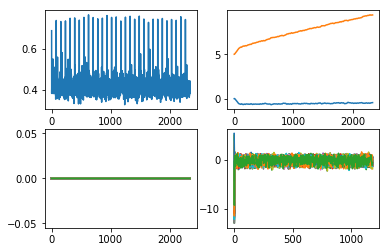

0.3826851672989502


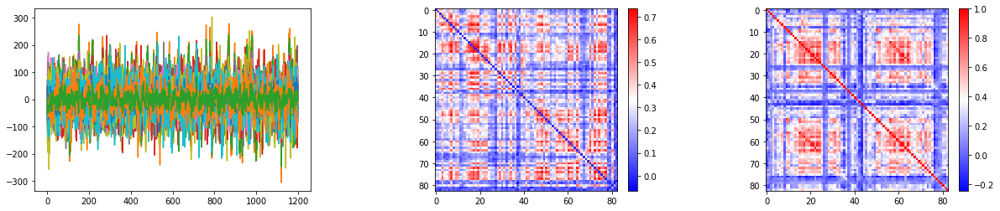

0.4173701656049022


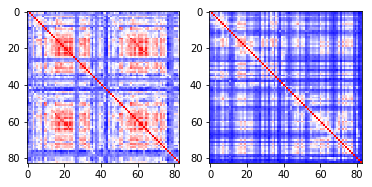

245 183034
246 567052
247 172029
248 149741


<Figure size 432x288 with 0 Axes>

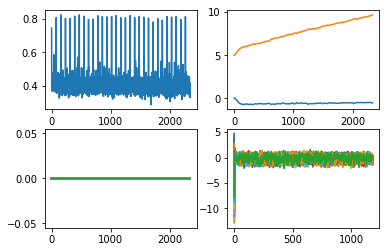

0.40652434686174066


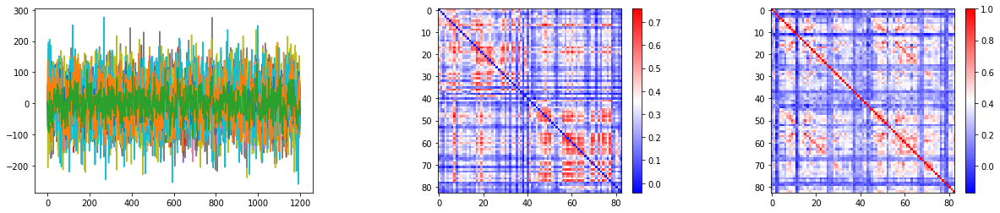

0.38770439939161877


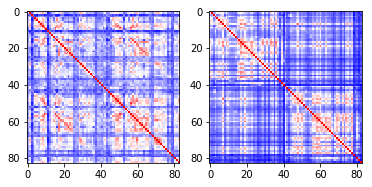

249 727553
250 495255
251 693764
252 521331


<Figure size 432x288 with 0 Axes>

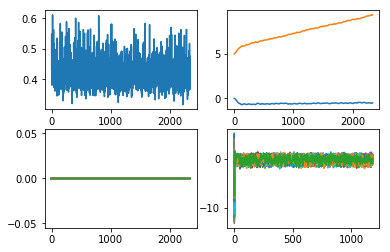

0.3413931498541352


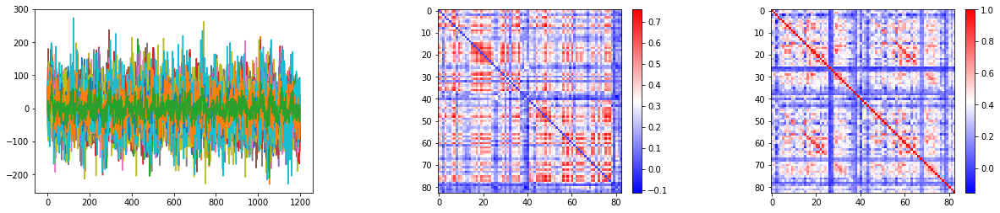

0.35772166986214154


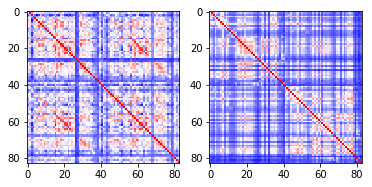

253 149337


<Figure size 432x288 with 0 Axes>

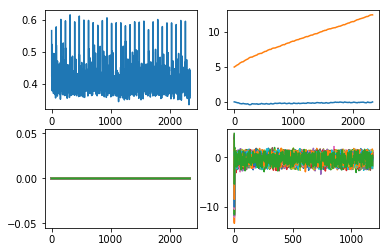

0.3598802094155413


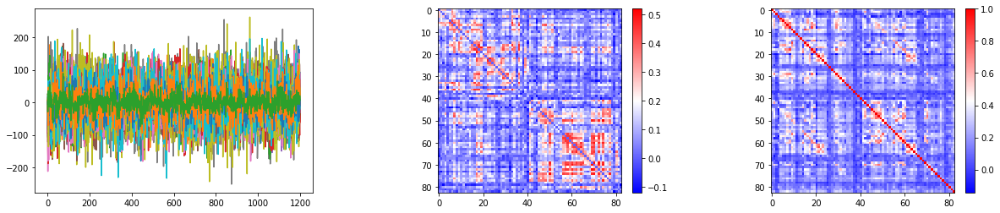

0.3959071148263207


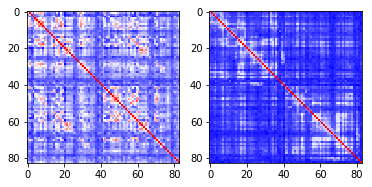

254 101107


<Figure size 432x288 with 0 Axes>

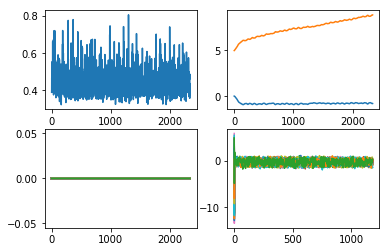

0.37568708970284065


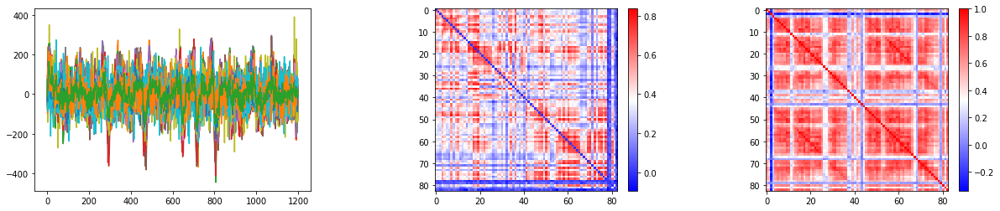

0.391966761046732


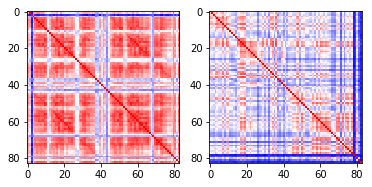

255 598568
256 177241


<Figure size 432x288 with 0 Axes>

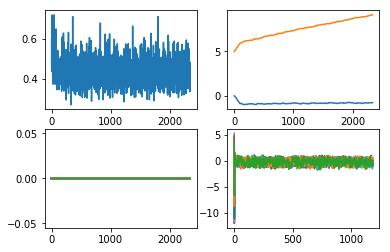

0.3684396327551574


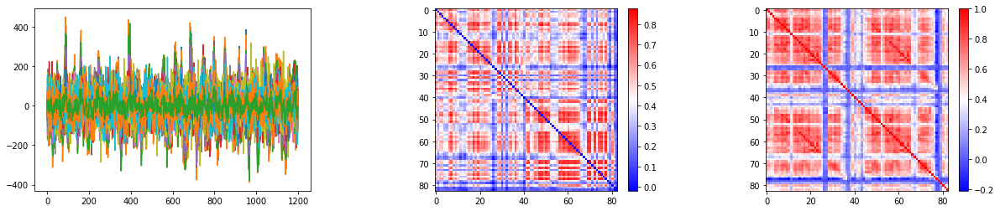

0.4190854667213241


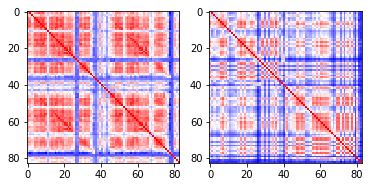

257 576255


<Figure size 432x288 with 0 Axes>

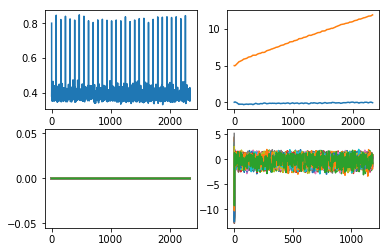

0.36620315065755155


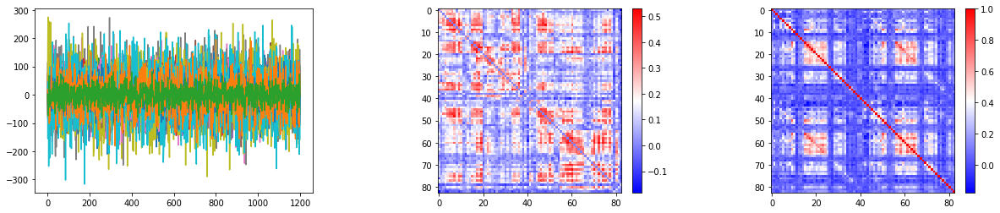

0.39075155958202695


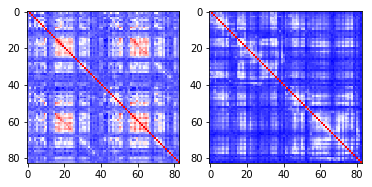

258 155231


<Figure size 432x288 with 0 Axes>

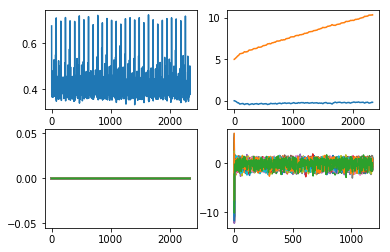

0.4122774007871524


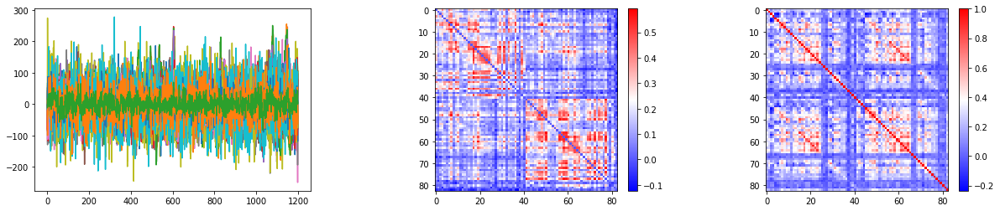

0.41518504881670665


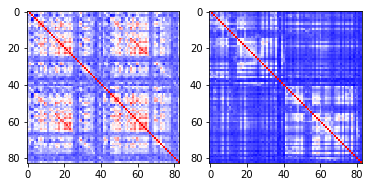

259 149539


<Figure size 432x288 with 0 Axes>

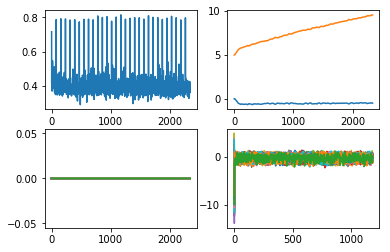

0.50693068634394


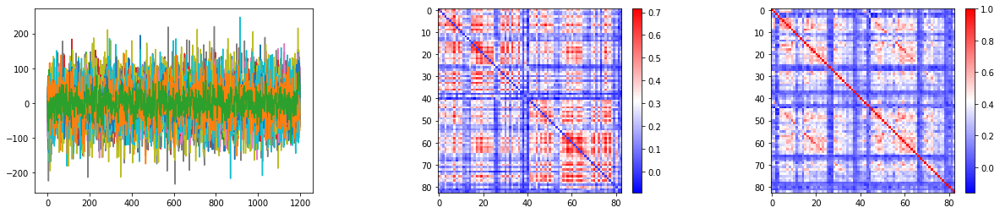

0.5054110104420245


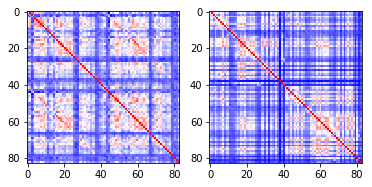

260 157942


<Figure size 432x288 with 0 Axes>

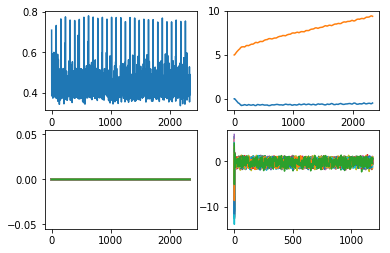

0.4040025447078789


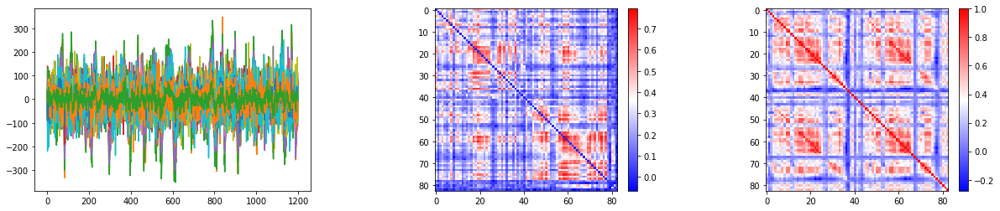

0.4043472816826847


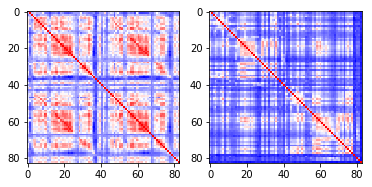

261 553344


<Figure size 432x288 with 0 Axes>

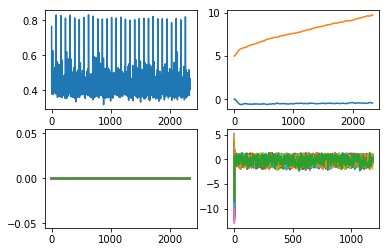

0.4210040162323908


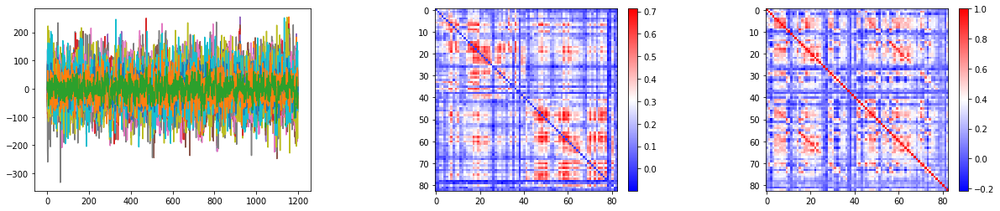

0.39956992005087427


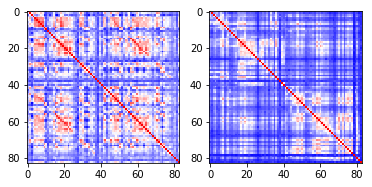

262 500222


<Figure size 432x288 with 0 Axes>

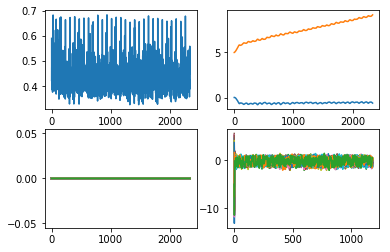

0.4257369140261764


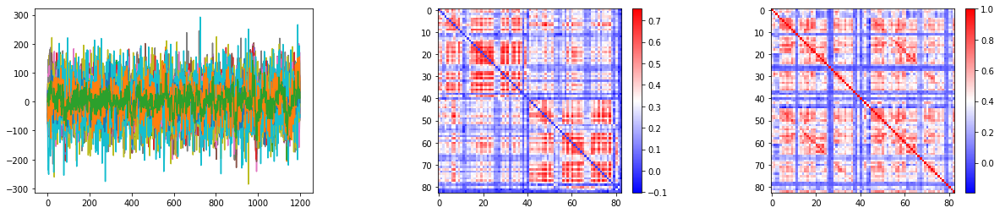

0.4337867829567455


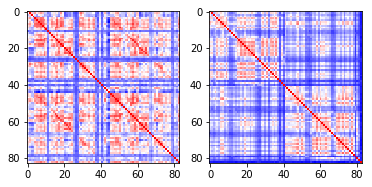

263 100610


<Figure size 432x288 with 0 Axes>

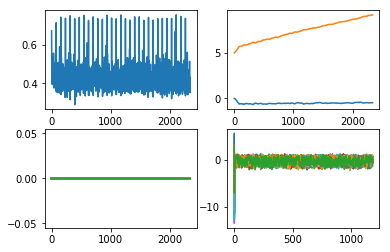

0.371902094733447


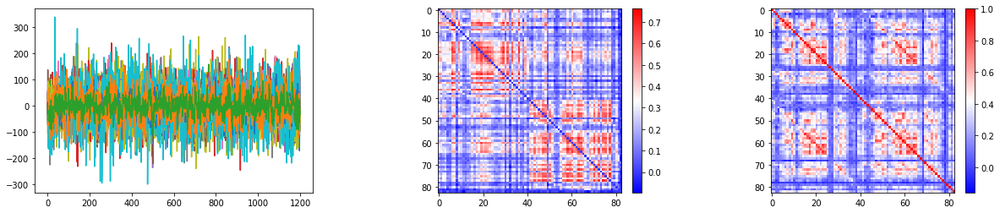

0.38790871417263645


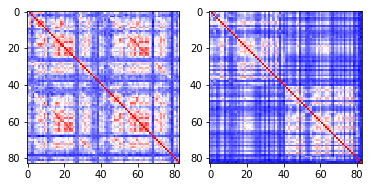

264 346137
265 196346
266 449753
267 812746
268 536647


<Figure size 432x288 with 0 Axes>

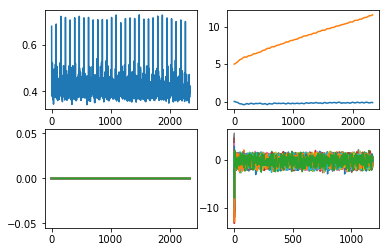

0.38193442569816655


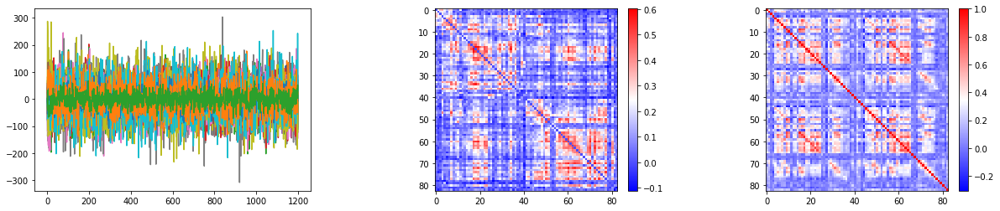

0.3856769599431587


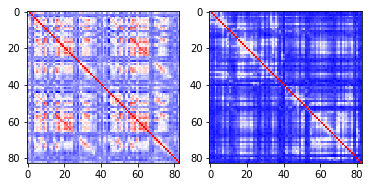

269 525541


<Figure size 432x288 with 0 Axes>

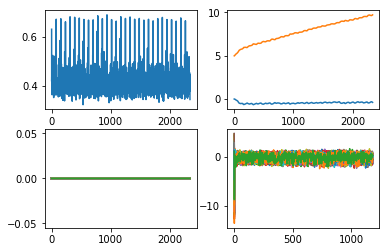

0.3742115161940215


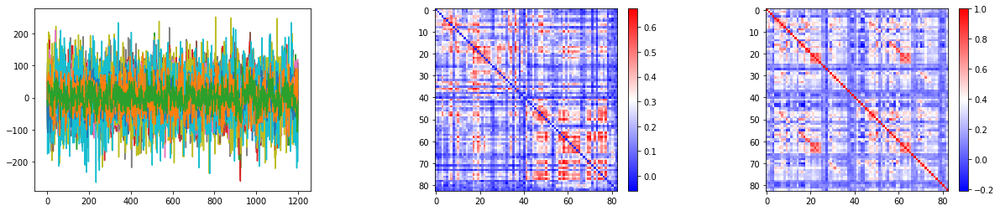

0.36847856914139177


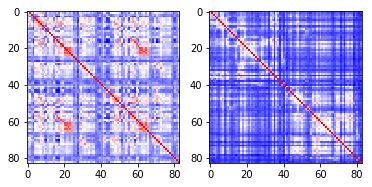

270 180129


<Figure size 432x288 with 0 Axes>

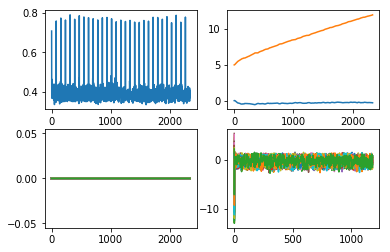

0.44318392513948096


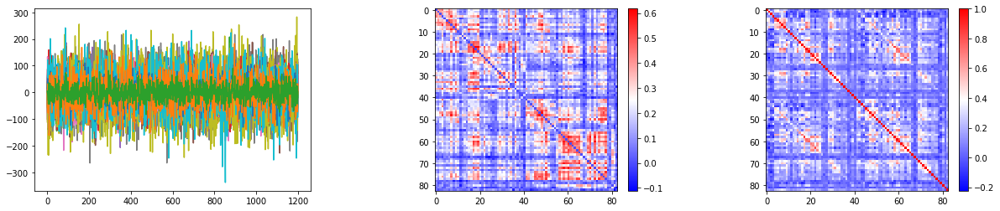

0.45770762565860634


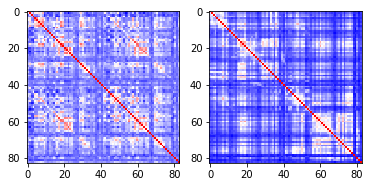

271 303119


<Figure size 432x288 with 0 Axes>

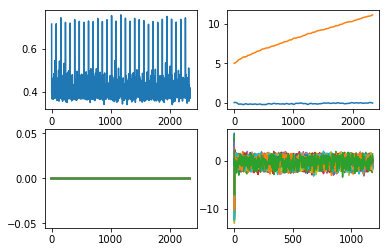

0.3839251074899609


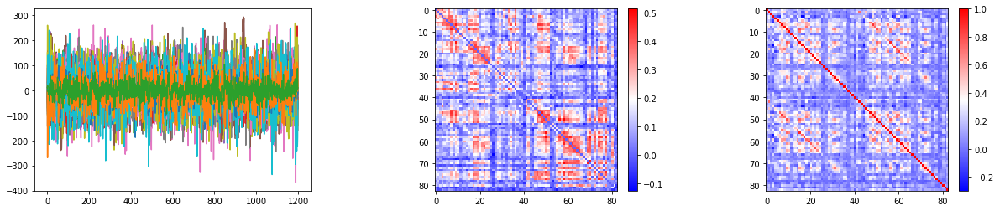

0.37798770452826824


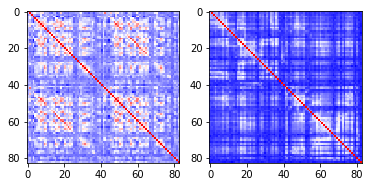

272 307127
273 308129


<Figure size 432x288 with 0 Axes>

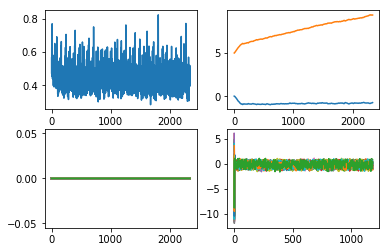

0.4511586444234168


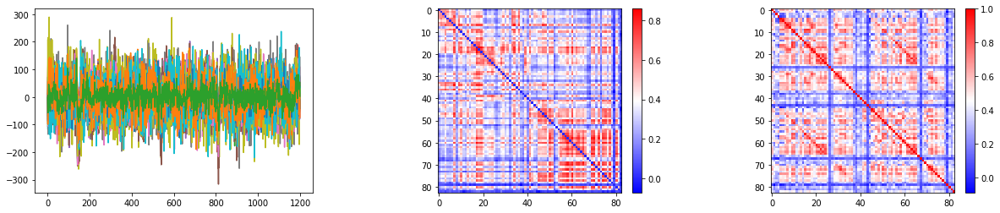

0.47223643765446544


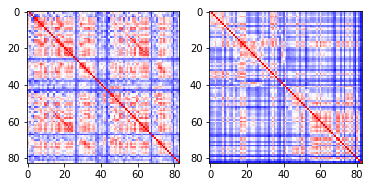

274 283543
275 172938


<Figure size 432x288 with 0 Axes>

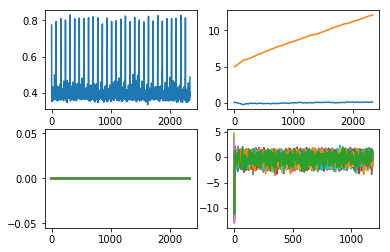

0.2645151714927449


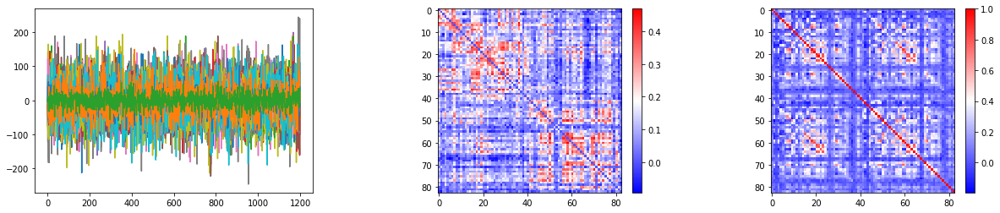

0.2688898847395132


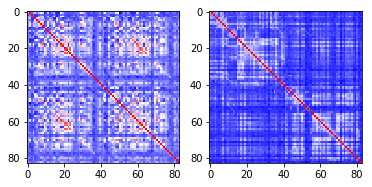

276 256540


<Figure size 432x288 with 0 Axes>

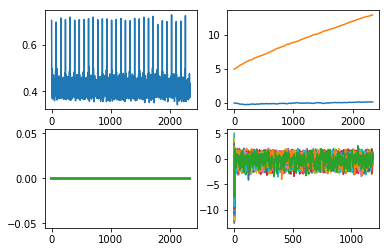

0.35976670029280655


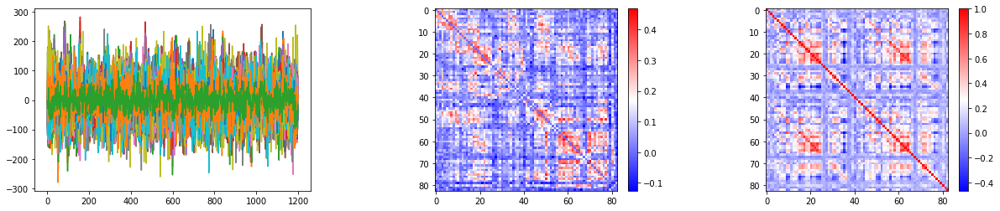

0.3417011501028127


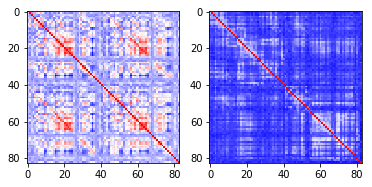

277 531536


<Figure size 432x288 with 0 Axes>

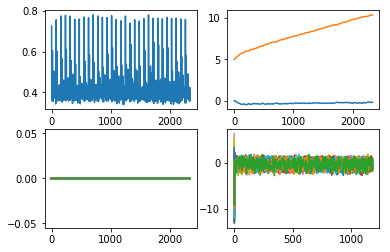

0.43481568287787337


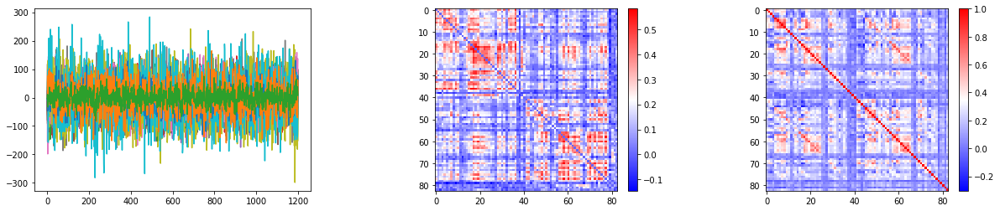

0.459439378220466


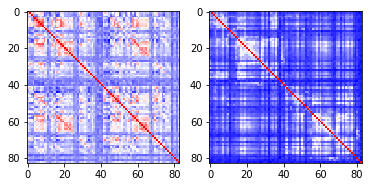

278 101410


<Figure size 432x288 with 0 Axes>

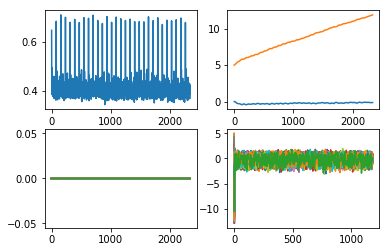

0.31607676820947406


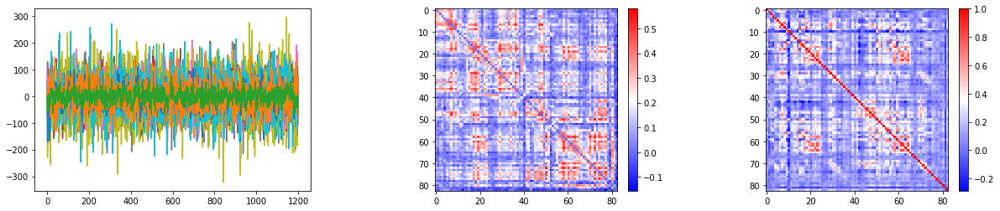

0.34592611964656805


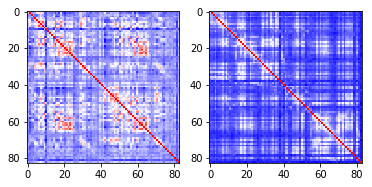

279 568963


<Figure size 432x288 with 0 Axes>

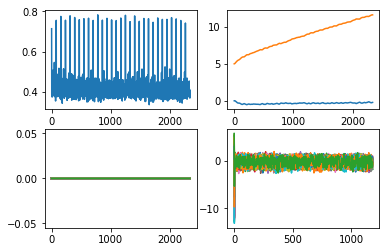

0.30709594509468047


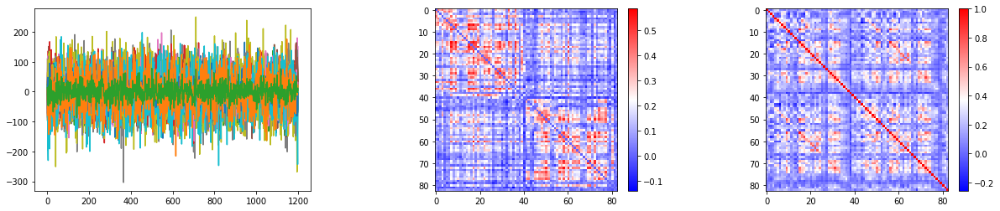

0.3418716774895611


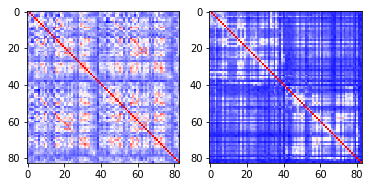

280 149236


<Figure size 432x288 with 0 Axes>

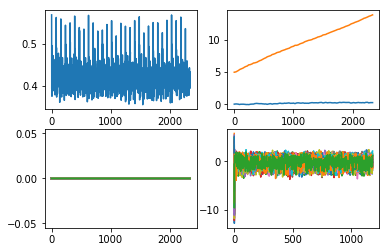

0.3149732570081418


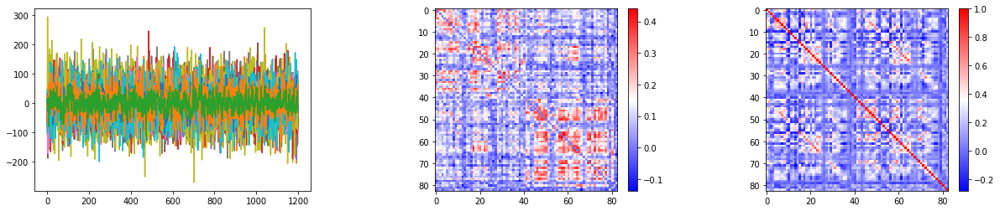

0.31895212866312933


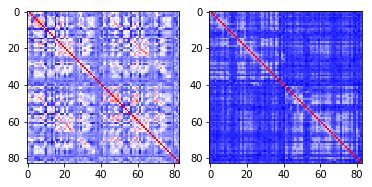

281 156334
282 172130


<Figure size 432x288 with 0 Axes>

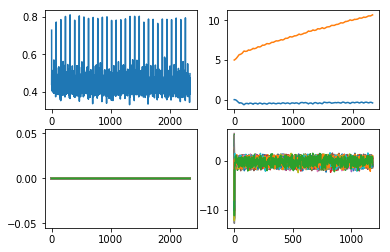

0.31559139140252596


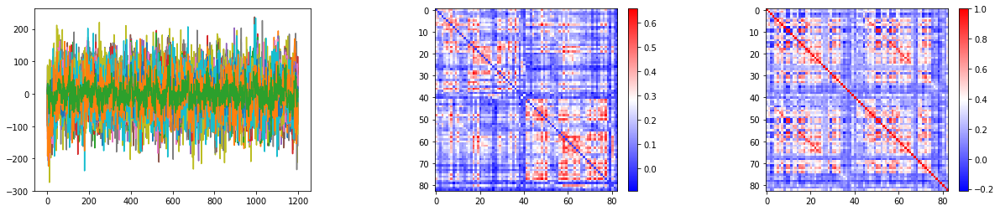

0.3270953580588159


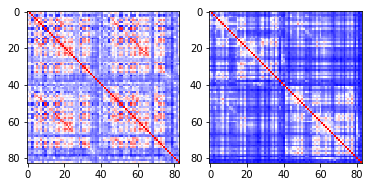

283 557857


<Figure size 432x288 with 0 Axes>

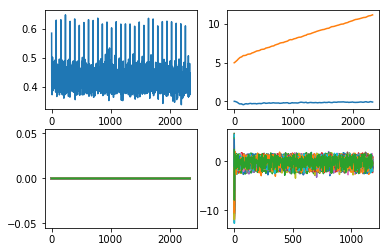

0.3442482791281915


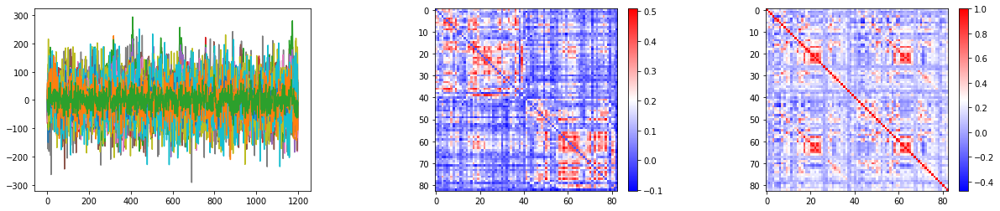

0.37410970079540556


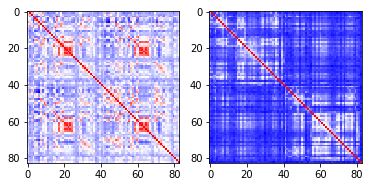

284 715647
285 300618


<Figure size 432x288 with 0 Axes>

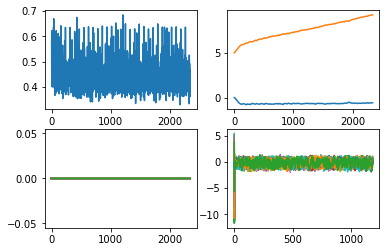

0.43758582206763214


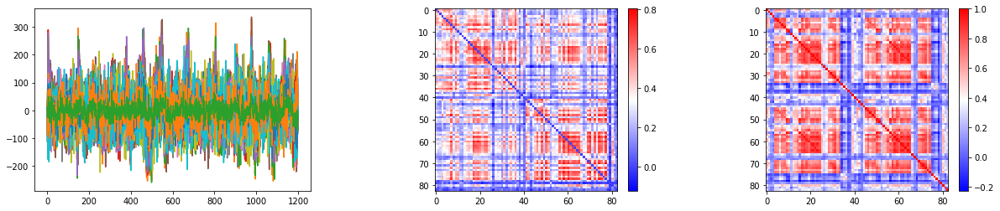

0.4263737824287392


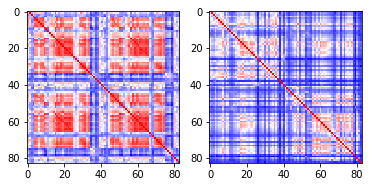

286 153833


<Figure size 432x288 with 0 Axes>

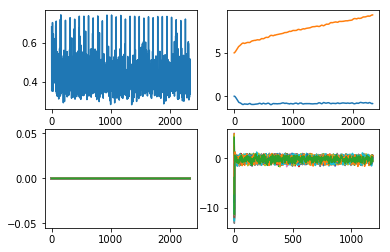

0.48588954717969207


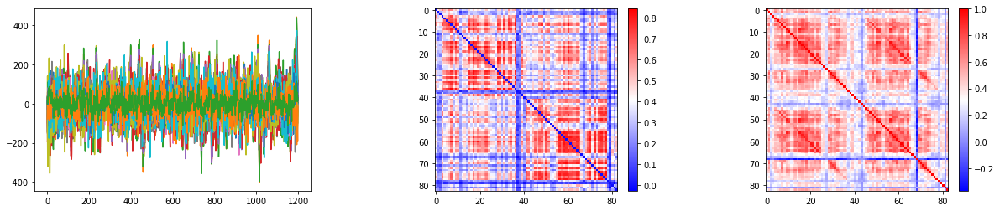

0.48016071896830365


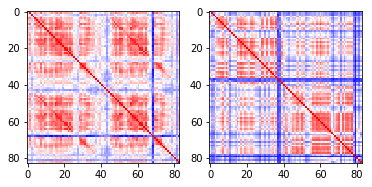

287 951457
288 180432


<Figure size 432x288 with 0 Axes>

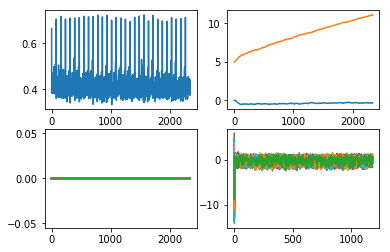

0.45754907101641185


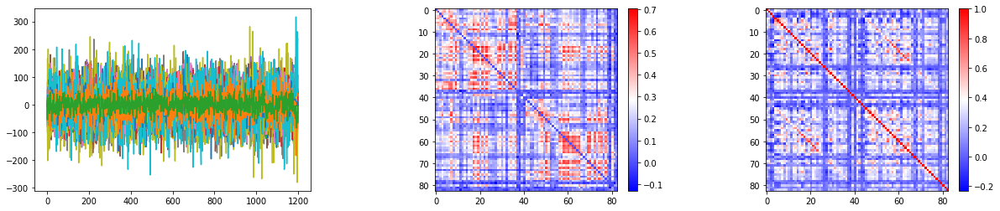

0.47849638162892966


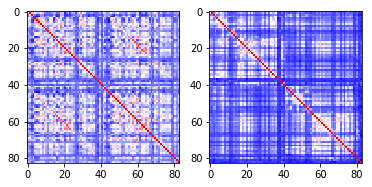

289 176542


<Figure size 432x288 with 0 Axes>

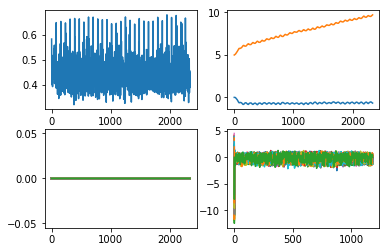

0.4757853364226786


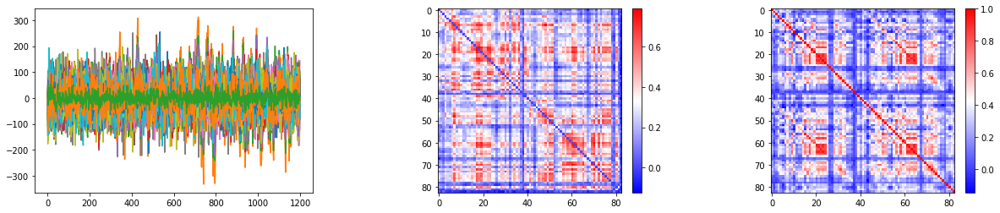

0.4603983789046049


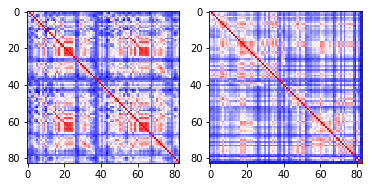

290 473952


<Figure size 432x288 with 0 Axes>

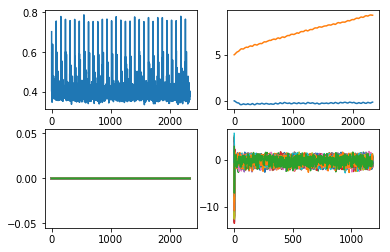

0.448672601280478


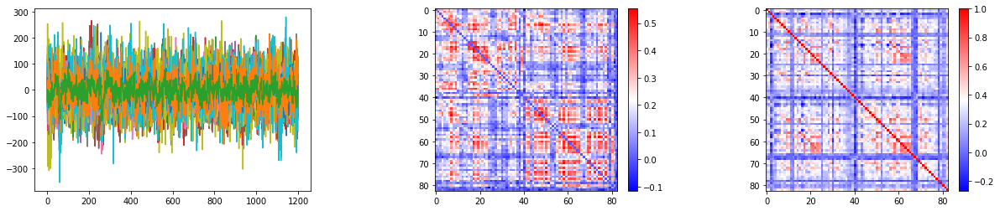

0.4708139934408168


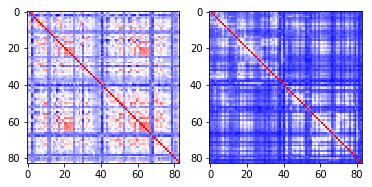

291 380036
292 101915


<Figure size 432x288 with 0 Axes>

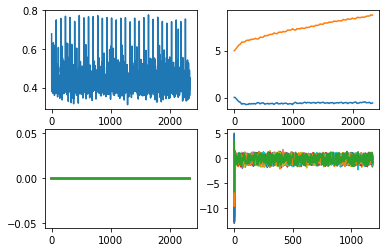

0.48998226863212285


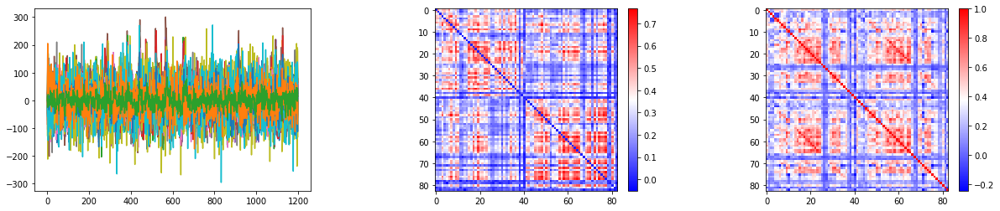

0.4946971802505645


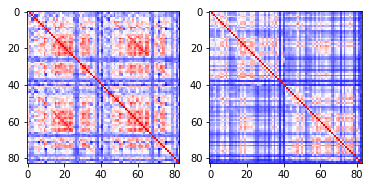

293 499566


<Figure size 432x288 with 0 Axes>

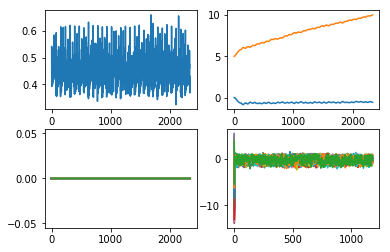

0.3927805319938983


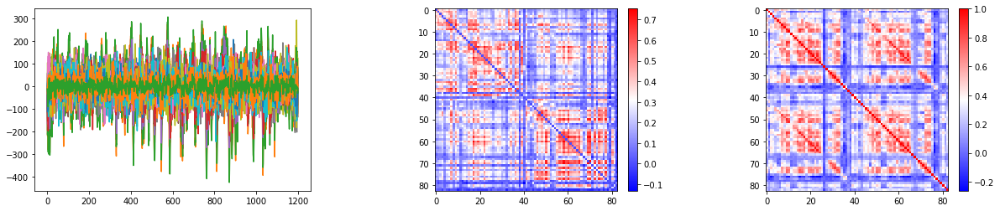

0.39197420925905746


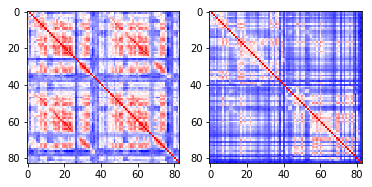

294 573451


<Figure size 432x288 with 0 Axes>

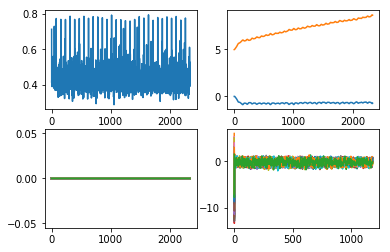

0.46702916047321474


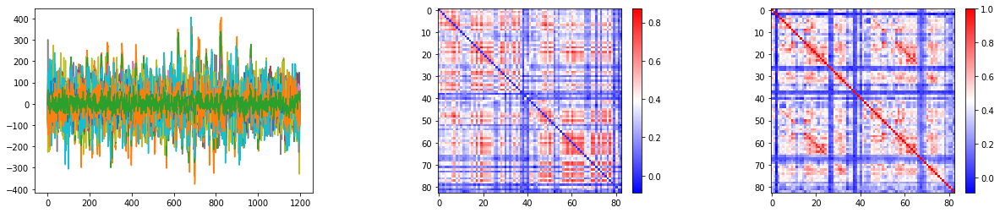

0.4749705829122487


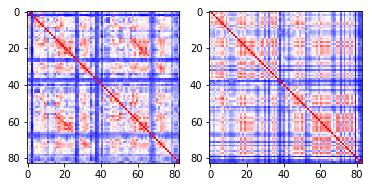

295 159138


<Figure size 432x288 with 0 Axes>

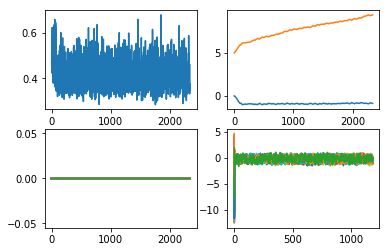

0.48610603580104766


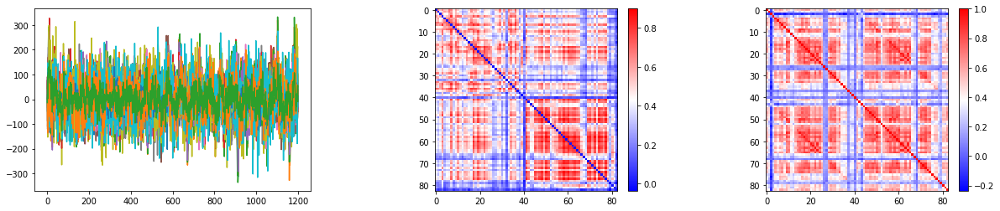

0.46686915216988467


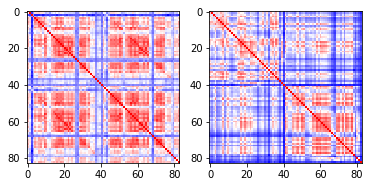

296 571548


<Figure size 432x288 with 0 Axes>

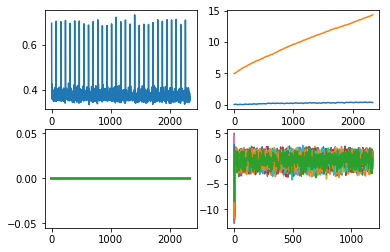

0.29603029588068985


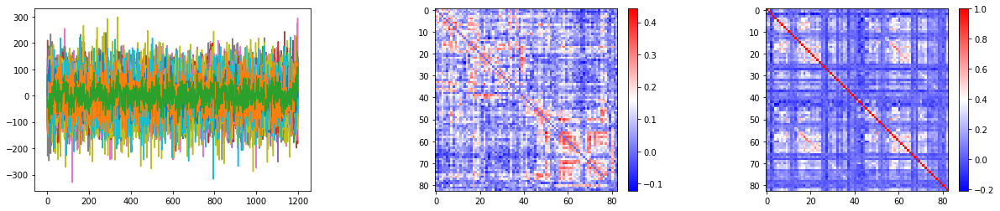

0.3251399754024352


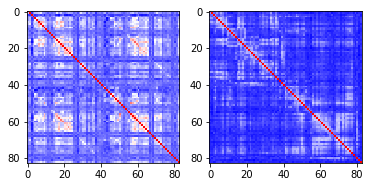

297 298455


<Figure size 432x288 with 0 Axes>

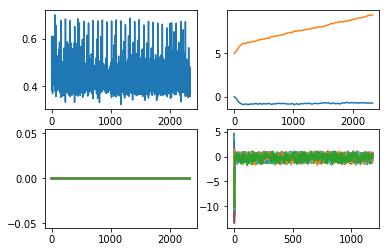

0.37943426529855434


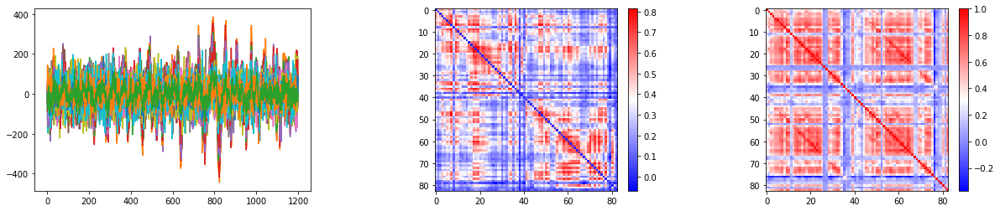

0.37000916165112496


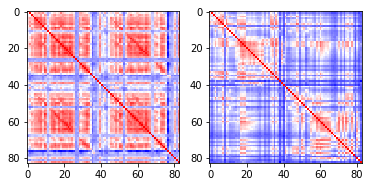

298 517239


<Figure size 432x288 with 0 Axes>

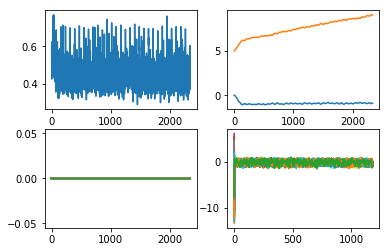

0.35649342345610585


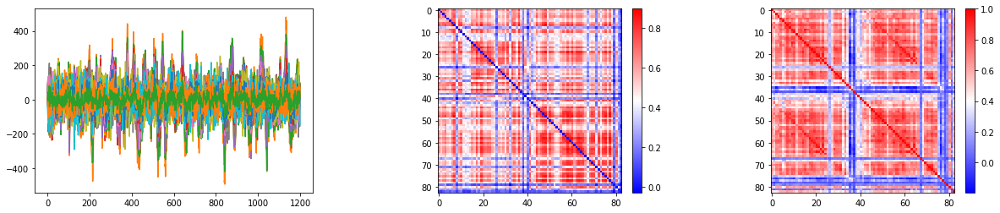

0.3835246562504008


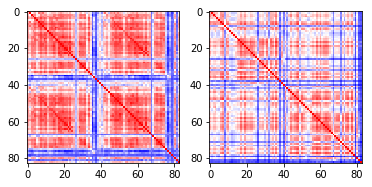

299 100408


<Figure size 432x288 with 0 Axes>

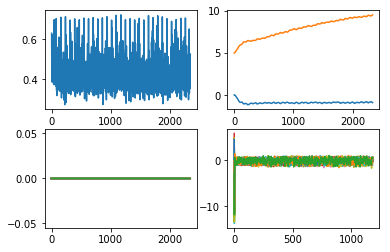

0.4636299294000419


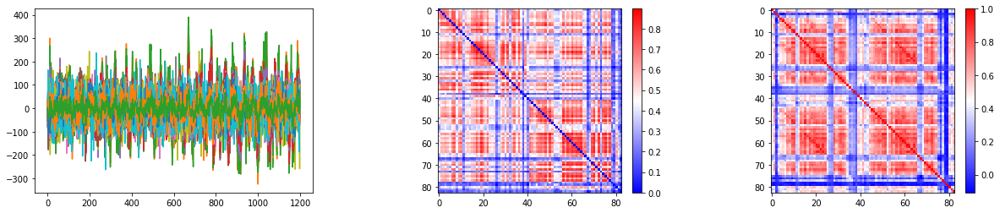

0.4557627578301692


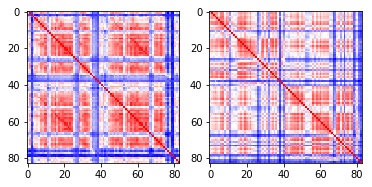

300 565452


<Figure size 432x288 with 0 Axes>

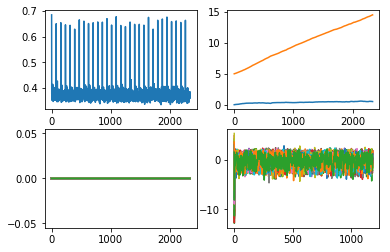

0.37473125796094536


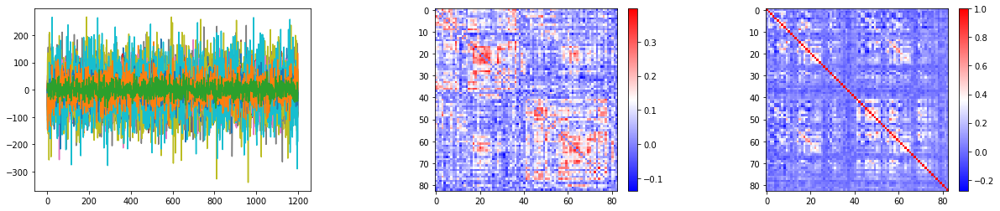

0.39879435711683386


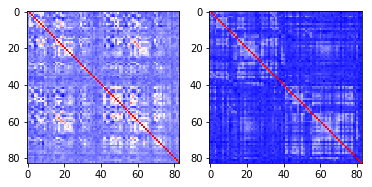

301 173132


<Figure size 432x288 with 0 Axes>

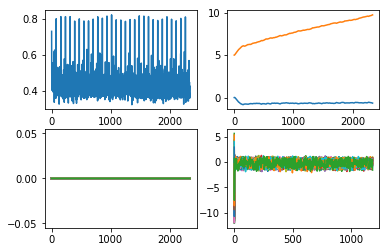

0.37541836414993246


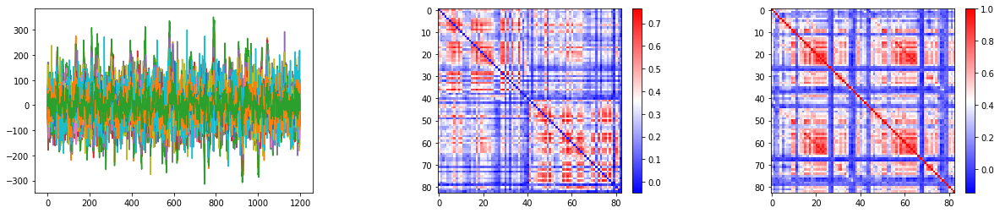

0.427810659551102


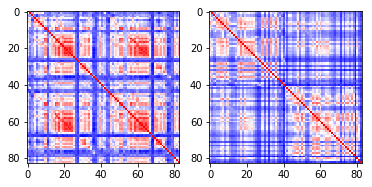

302 182840


<Figure size 432x288 with 0 Axes>

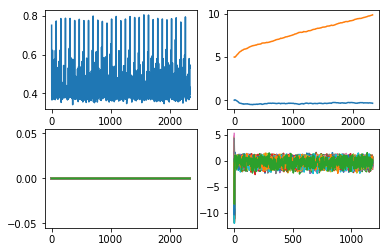

0.39319380249019714


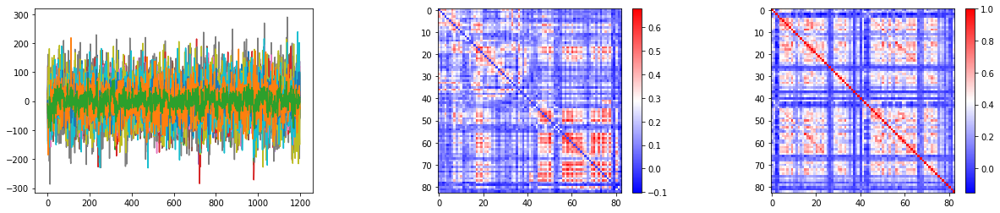

0.43291613007349783


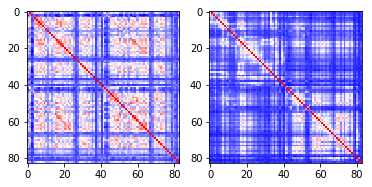

303 181232


<Figure size 432x288 with 0 Axes>

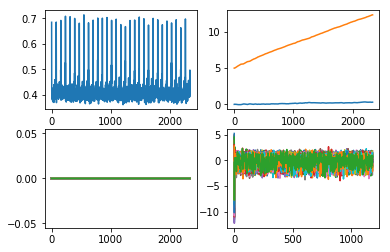

0.2821014094309092


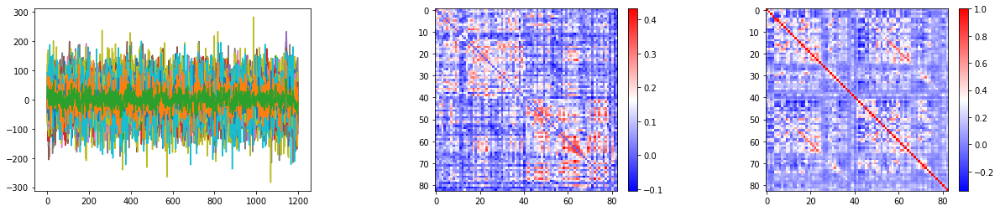

0.3267130639909494


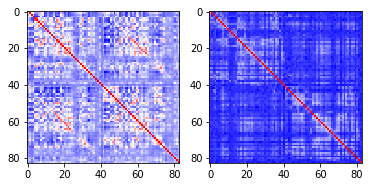

304 445543


<Figure size 432x288 with 0 Axes>

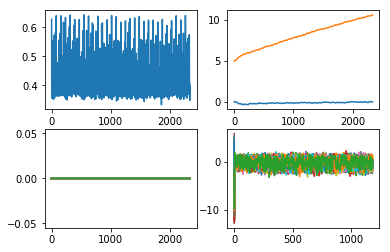

0.3908428737063661


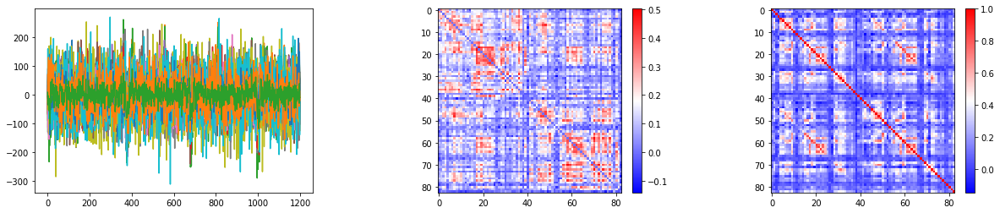

0.4183876831351816


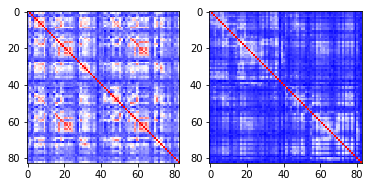

305 206222
306 270332


<Figure size 432x288 with 0 Axes>

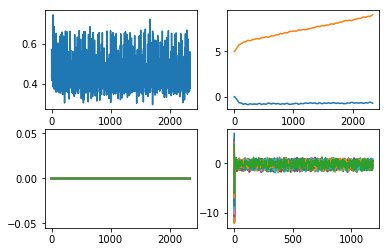

0.4789469451033529


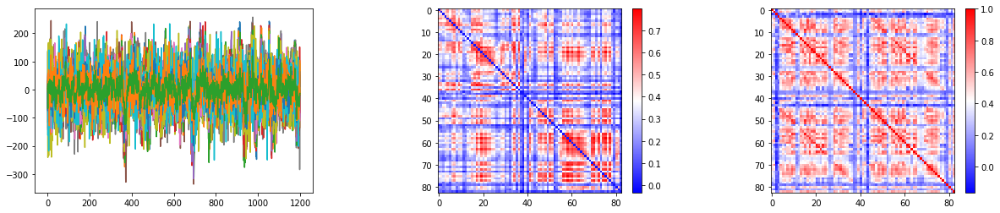

0.48481510539317907


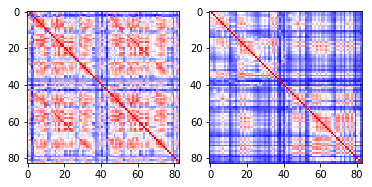

307 185139
308 520228


<Figure size 432x288 with 0 Axes>

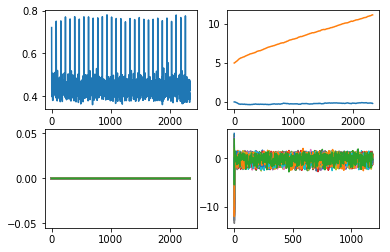

0.23492287117009944


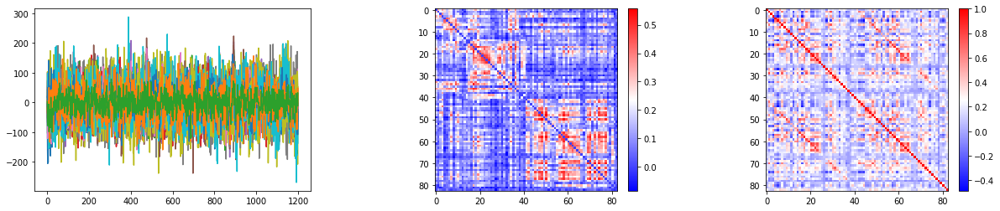

0.25487340584133156


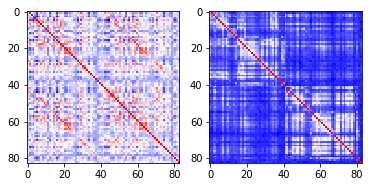

309 453441


<Figure size 432x288 with 0 Axes>

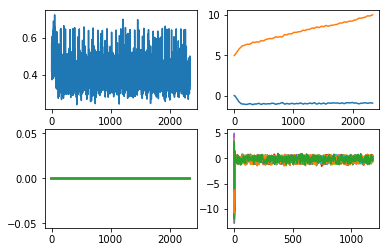

0.48820428235601604


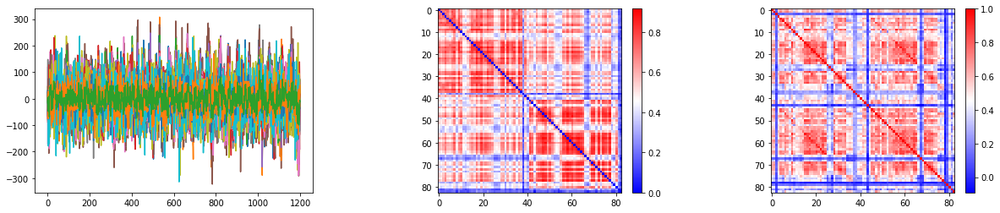

0.47976313314116276


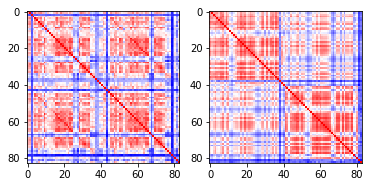

310 766563
311 101006


<Figure size 432x288 with 0 Axes>

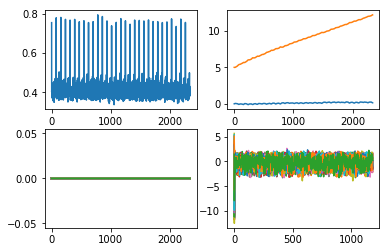

0.3086570255792844


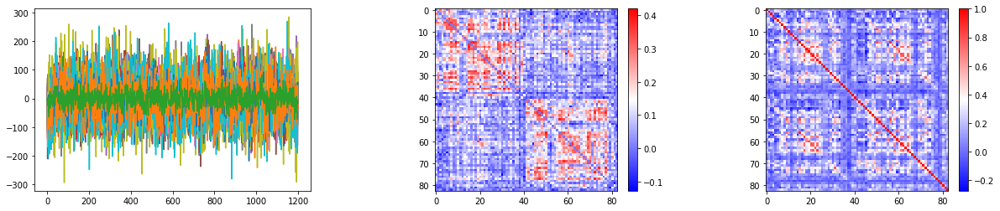

0.34954659757223955


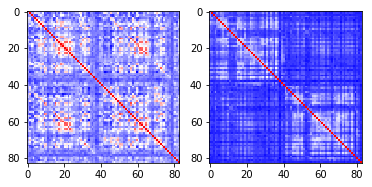

312 148840


<Figure size 432x288 with 0 Axes>

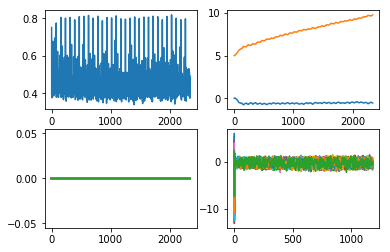

0.40972809637345003


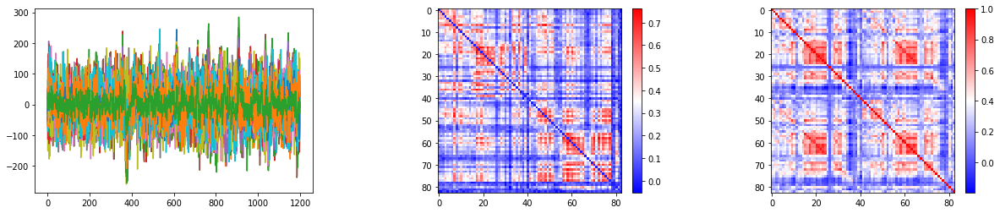

0.42249527242390145


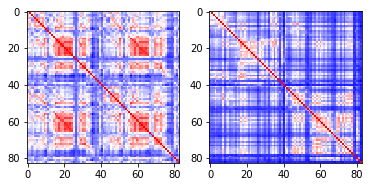

313 102311


<Figure size 432x288 with 0 Axes>

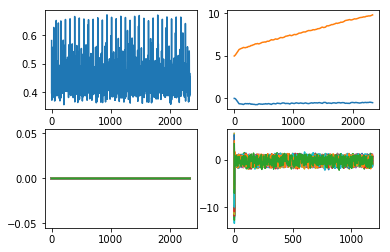

0.3588176280777906


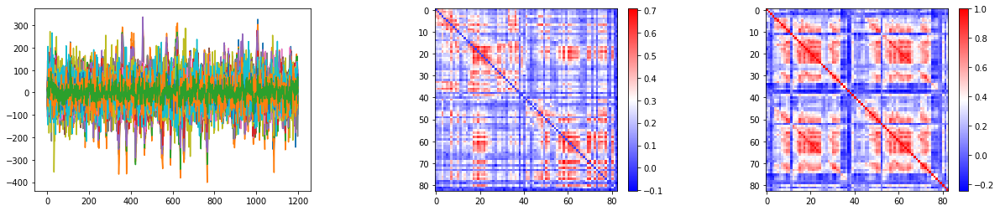

0.3841886099408089


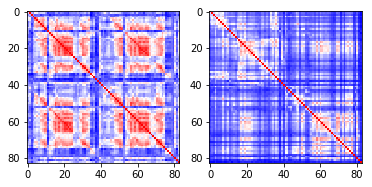

314 199150


<Figure size 432x288 with 0 Axes>

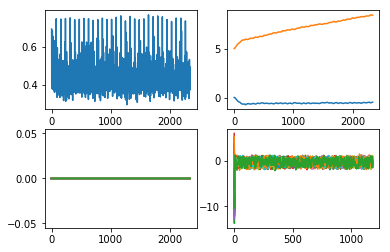

0.48797689138196804


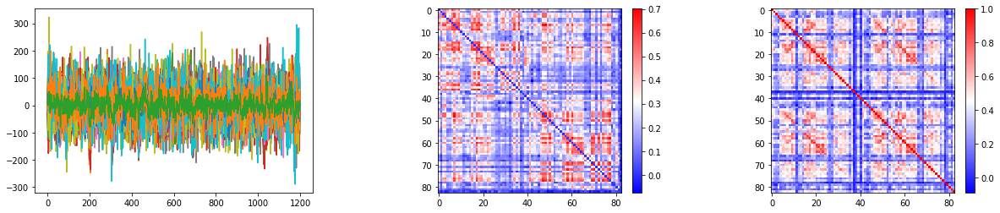

0.5007736450794109


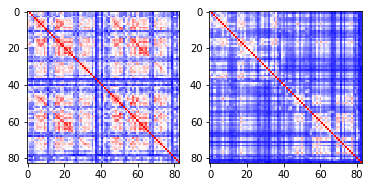

315 101309
316 561242


<Figure size 432x288 with 0 Axes>

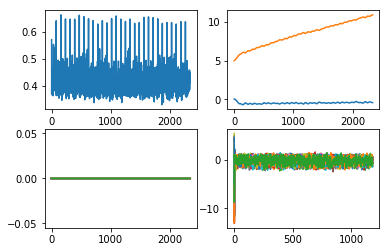

0.3268038386067988


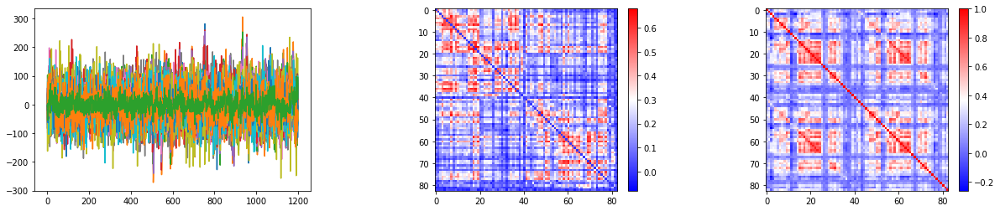

0.38461163578852803


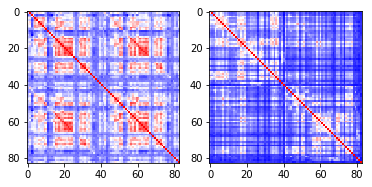

317 309636


<Figure size 432x288 with 0 Axes>

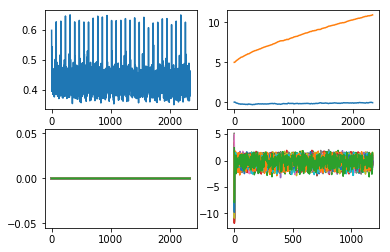

0.3037687475139806


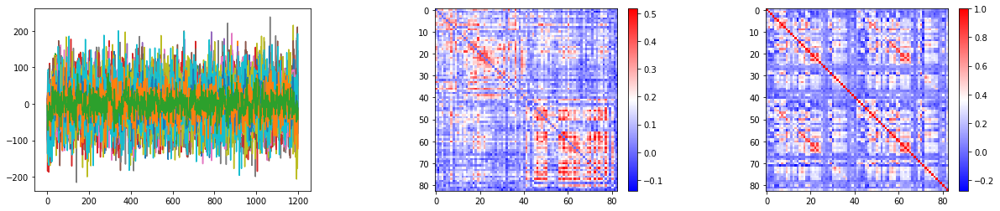

0.34538462063589664


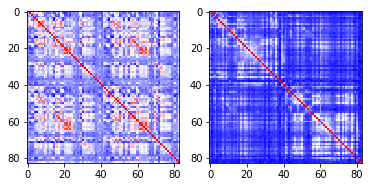

In [8]:
batch_size = 83
HCP_par_corr= {}
ROI_size = 83
#groups= ['CON_MCI']

subs=[sub for sub in os.listdir(SC_base_dir) if os.path.isdir(SC_base_dir+sub)]
#subs = ['1']
for i in range(len(subs)):
    sub =subs[i]
    print(i, sub)
    SC_file = SC_base_dir+ sub +'/dsi_sd4/sub-' +sub +'_roisc33dwispace/weights.txt'
    TS_file = TS_base_dir+sub+ '_rfMRI_REST1_LR_hpc200_clean__l2k8_sc33_ts.pkl'
#groups= ['CON_MCI']



    
    if os.path.isfile(SC_file) and os.path.isfile(TS_file):
        HCP_par_corr[sub] = []
        SC= np.loadtxt(SC_file)
        TS_df=pd.read_pickle(TS_file)
        TS=TS_df.values
        TS_dmean =(TS.T -TS.T.mean(axis= 0)).T
        SC = (SC+SC.T)*0.5
        """SC1=SC[:48,:48].copy()
        SC2=SC[48:96,48:96].copy()
        SC3=SC[:48,48:96].copy()
        mask1 = (SC1-SC1.mean(axis=1)< 2.*SC1.std(axis=1)) 
        SC1[mask1]=0
        SC2[(SC2-SC2.mean(axis=1) <  2*SC2.std(axis=1)) ]=0
        SC3[(SC3-SC3.mean(axis=1)<  2*SC3.std(axis=1)) ]=0
        SC[:48,:48] = SC1
        SC[48:96,48:96] = SC2
        SC[:48,48:96] = 1*SC3
        SC[48:96,:48] = 1*SC3.T"""
        Wo = np.log1p(SC)/np.linalg.norm(np.log1p(SC))
        #L_s = (-np.diag(np.sum(W0, axis= 1)) + W0).astype(np.float32)
            
            
        num_data = TS.shape[0]

        total_series_length = num_data -echo_step #50000


        num_batches = (total_series_length-truncated_backprop_length)//(truncated_backprop_length-overlaping)+1
            
        model_run(sub,Wo, TS)
    
        X0 = np.ones((6*batch_size,))/10.
        params = np.loadtxt(out_dir+'HCP_'+sub+'paramsList.txt')
        Theta = params[-10:,:].mean(axis = 0)

        tys=[]
        ROI_size= batch_size
        for j in range(4000):
            X = f_diffusion_tr_noise(X0,Wo, Theta)
        
            X0 = X
    
            tys.append(h_diffusion_noise(X0, Theta))
        
        tys=np.array(tys)
        #tys_dmean =(tys.T -tys.T.mean(axis= 0)).T
        FC_sim = np.corrcoef(tys[20:,:].T)
        FC=np.corrcoef(TS.T)
        np.savetxt(out_dir+'HCP_'+sub+'sim_bold.txt', np.array(tys))
        print(np.corrcoef(FC[np.tril_indices(batch_size,-1)], FC_sim[np.tril_indices(batch_size,-1)])[0,1])
        HCP_par_corr[sub].append(np.corrcoef(FC[np.tril_indices(batch_size,-1)], FC_sim[np.tril_indices(batch_size,-1)])[0,1])
            
    
        HCP_par_corr[sub].append(0.3+0.1*np.tanh(Theta[0:1])[0])
        HCP_par_corr[sub].append(40.+20.*np.tanh(Theta[1:2])[0])
        """HCP_par_corr[sub].append(.001+ smooth_normalize(Theta[2:3])[0])
        HCP_par_corr[sub].append(.1+ smooth_normalize(Theta[3:4])[0])
        HCP_par_corr[sub].append(5000./0.459/0.641+1000.*np.tanh(Theta[4:5])[0])"""
        """W_n_a = np.reshape(Theta[5:], [batch_size,batch_size])
        W_n_a = 1+ np.tanh((W_n_a+W_n_a.T)/2.0)
        W_n_a = W_n_a * Wo
    
        Ws_a = W_n_a/np.linalg.norm(W_n_a)
        HCP_par_corr[sub].extend(list(Ws_a.ravel()))"""
        
            
        fig, ax = plt.subplots(1,2)
        ax[0].imshow(FC, cmap='bwr')
        ax[1].imshow(FC_sim, cmap='bwr')
        plt.show()


 

    


In [ ]:
HCP_par_corr_new={}
for sub in HCP_par_corr:
    HCP_par_corr_new['sub'+sub] = HCP_par_corr[sub]

In [15]:
scipy.io.savemat(out_dir+'HCP_par_corr.mat', HCP_par_corr_new)
np.save(out_dir+'HCP_par_corr.npy', HCP_par_corr_new)

In [81]:
Theta

array([ 0.27018141, 48.38638382])

154532
0.26908398503040953


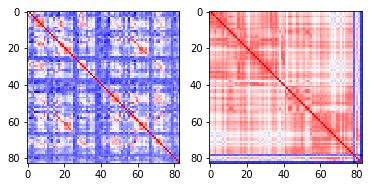

In [22]:
subs=[sub for sub in os.listdir(SC_base_dir) if os.path.isdir(SC_base_dir+sub)]
sub =subs[2]
print(sub)
SC_file = SC_base_dir+ sub +'/dsi_sd4/sub-' +sub +'_roisc33dwispace/weights.txt'
TS_file = TS_base_dir+sub+ '_rfMRI_REST1_LR_hpc200_clean__l2k8_sc33_ts.pkl'
#groups= ['CON_MCI']



    
SC= np.loadtxt(SC_file)
TS_df=pd.read_pickle(TS_file)
TS=TS_df.values
SC = (SC+SC.T)*0.5
X0 = np.ones((6*batch_size,))/10.
Wo = np.log1p(SC)/np.linalg.norm(np.log1p(SC))
params = np.loadtxt(out_dir+'HCP_'+sub+'paramsList.txt')
Theta = params[-10:,:].mean(axis = 0)

tys=[]
ROI_size= batch_size
for j in range(4000):
    X = f_diffusion_tr_noise(X0,Wo, Theta)
        
    X0 = X
    
    tys.append(h_diffusion_noise(X0, Theta))
        
tys=np.array(tys)
        #tys_dmean =(tys.T -tys.T.mean(axis= 0)).T
FC_sim = np.corrcoef(tys[50:,:].T)
FC=np.corrcoef(TS.T)
np.savetxt(out_dir+'HCP_'+sub+'sim_bold.txt', np.array(tys))
print(np.corrcoef(FC[np.tril_indices(batch_size,-1)], FC_sim[np.tril_indices(batch_size,-1)])[0,1])
        
            
fig, ax = plt.subplots(1,2)
ax[0].imshow(FC, cmap='bwr')
ax[1].imshow(FC_sim, cmap='bwr')
plt.show()

In [24]:
Theta

array([-0.81719793,  1.23561782])